In [1]:
import os
import argparse
import time
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import torch
import torch.nn as nn        #for all Neural Network stuff
import torch.optim as optim  #for all optimizer stuff

In [2]:
#method argument not needed??
data_size = 2000 #number of points in linspace
batch_time = 20 #number of points in the interval after a random starting point
batch_size = 500 #number of intervals
niters = 2000 #number of iterations
test_freq = 5
viz = True
gpu = 1
adjoint = True

In [3]:
from torchdiffeq import odeint_adjoint as odeint

In [4]:
device = torch.device('cuda:' + str(gpu) if torch.cuda.is_available() else 'cpu')

In [5]:
#create linspace like usual
t = torch.linspace(0.0, 25.0, data_size)

sigma = 10.0
ro = 28.0
beta = 8.0/3.0

In [6]:
def random():
    rand = 0
    while abs(rand) < 1 or abs(rand) > 3:
        rand = np.random.normal(0, 1, 1)[0]
    return rand

In [7]:
def getSlopesTorch(x,function):
    dim =  x.shape[0]**3
    slopeList = torch.zeros((dim,3))
    i = 0
    for m in x:
        for l in x:
            for k in x:
                #print(slope([],[m,l,k]))
                slopeList[i] = function.forward([],torch.tensor([[m,l,k]]))
                i += 1
    return slopeList

In [8]:
#lambda is a nn.Module like Linear, Conv2D etc,,
class Lambda(nn.Module):
    def forward(self,t,u):
        x = u[0,0]
        y = u[0,1]
        z = u[0,2]

        DE = np.zeros_like(u[0])

        DE[0] = sigma*(y-x)
        DE[1] = x*(ro-z)-y
        DE[2] = x*y - beta*z

        return torch.tensor(DE)

In [16]:
def get_batch():
    s = torch.from_numpy(np.random.choice(np.arange(data_size-batch_time, dtype=np.int64), batch_size, replace=False))
#s is a torch tensor from a numpy array. the array is a random choice array, a rand number from 0 to ds-bt is chosen bs times.
#s has batch_size elements and each was equally likely to be chosen
#why ds-bt? why not just data_size as a rance since we are chosing from the t linspace with ds many points?
#it does ds-bt so that when it chooses the next bt number of points we will never fall out of the index range if
#    ds=1000 and bt=10 then then if i start at 990, I will end up with 990-1000 and not over.
    batch_y0 = true_y[s] #(M, D) <- idk what this means
#b_y0 is made of the randomly selected data points (dep vals) from true_y solution
    batch_t = t[:batch_time] #(T)
#b_t is the values rank 0 to b_time from your linspace t; the linspace values being looked at
    batch_y = torch.stack([true_y[s+i] for i in range(batch_time)],dim=0)  # (T, M, D)
    return batch_y0, batch_t, batch_y


In [17]:
def makedirs(dirname):
    if not os.path.exists(dirname):
        os.makedirs(dirname)

In [18]:
def drawDFT(ySpace, length, function):
    for l in ySpace:
        for k in ySpace:
            y = torch.tensor([[l,k]])
            t = torch.tensor([[]])
            #direction i and j + Magnitude of <i,j>
            i = function.forward(t,y)[:,0][0].numpy()
            j = function.forward(t,y)[:,1][0].numpy()
            magnitude = np.sqrt(i**2+j**2)
            
            #normalize and scale by h
            i = h*i/magnitude
            j = h*j/magnitude
            
            current_domain = np.linspace(l-(i/2), l+(i/2), 2) #the end points of the small intervals
            current_range = np.linspace(k-(j/2), k+(j/2), 2)

            plt.plot(current_domain, current_range, lw=0.2, color='b')
            plt.arrow(current_domain[0],current_range[0], i, j, color='b', lw=0.5, length_includes_head=True, head_length=0.1, head_width=0.1)

In [19]:
def visualize(true_y, pred_y):
    
    #Draw True Y
    fig = plt.figure()
    ax = plt.axes(projection='3d')
    
    ax.plot3D(true_y.numpy()[:,0,0],true_y.numpy()[:,0,1],true_y.numpy()[:,0,2],'b')
    plt.xlim(-30,30)
    plt.ylim(-30,30)
    ax.set_zlim(10,45)
    plt.savefig('png/{:03d}'.format(itr))
    plt.show()
    
    #Draw Pred Y
    fig = plt.figure()
    ax = plt.axes(projection='3d')
    
    ax.plot3D(pred_y.numpy()[:,0,0],pred_y.numpy()[:,0,1],pred_y.numpy()[:,0,2],'m')
    plt.xlim(-30,30)
    plt.ylim(-30,30)
    ax.set_zlim(10,45)
    plt.savefig('png/{:03d}'.format(itr))
    plt.show()

In [20]:
class ODEFunc(nn.Module): #create an ODE block as our neural network. usually multiple layers/modules
    
    def __init__(self):
        super(ODEFunc, self).__init__()
#self.net is the neural network layers one after the other L -> T -> L        
        self.net = nn.Sequential(    
            nn.Linear(3,50),
            nn.Tanh(),
            nn.Linear(50,100),
            nn.Tanh(),
            nn.Linear(100,50),
            nn.Tanh(),
            nn.Linear(50,3),
        )
        
        for m in self.net.modules():
            if isinstance(m,nn.Linear): #checks in the module m in self.net is an instance of the nn.Linear class
                nn.init.normal_(m.weight, mean=0, std=0.2) #for the Linear modules make all the weights randn with std 0.1
                nn.init.constant_(m.bias, val=0) #for the Linear modules make all the bias vector values 0
    
    def forward(self, t, y):
        return self.net(y) #essentially Lambda.forward(args) without the true_A >>>which is TBD<<<

In [21]:
class RunningAverageMeter(object): #Computes and stores the average and current value
    def __init__(self, momentum=0.99): #new object of this class will have mom of 0.99 and a reset val and avg
        self.momentum = momentum
        self.reset()
    def reset(self):                   #reset function called to set val and avg to None and 0 respectively
        self.val = None
        self.avg = 0
    def update(self, val):             #update is called externally to update the avg based on val
        if self.val is None:
            self.avg = val
        else:
            self.avg = (self.avg * self.momentum) + (val * (1 - self.momentum)) #reminds me of output error at L

Iteration 0001 | Total Loss 190.634140
Iteration 0002 | Total Loss 270.265472
Iteration 0003 | Total Loss 270.691895
Iteration 0004 | Total Loss 270.769409
Iteration 0005 | Total Loss 269.066589


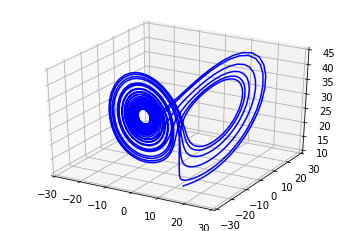

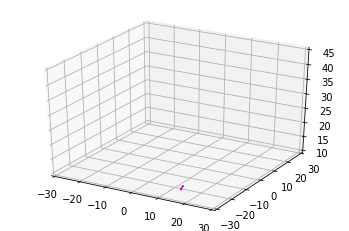

Iteration 0006 | Total Loss 276.592255
Iteration 0007 | Total Loss 250.606979
Iteration 0008 | Total Loss 272.420471
Iteration 0009 | Total Loss 272.603882
Iteration 0010 | Total Loss 273.175873


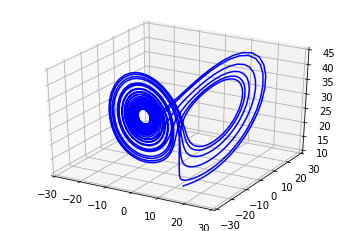

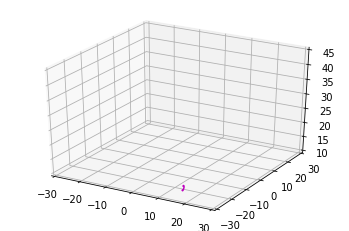

Iteration 0011 | Total Loss 263.629395
Iteration 0012 | Total Loss 271.412659
Iteration 0013 | Total Loss 266.273560
Iteration 0014 | Total Loss 273.741760
Iteration 0015 | Total Loss 269.331024


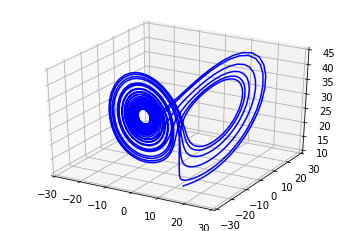

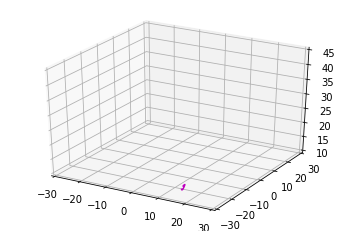

Iteration 0016 | Total Loss 273.397278
Iteration 0017 | Total Loss 267.440857
Iteration 0018 | Total Loss 263.868988
Iteration 0019 | Total Loss 264.727844
Iteration 0020 | Total Loss 272.916321


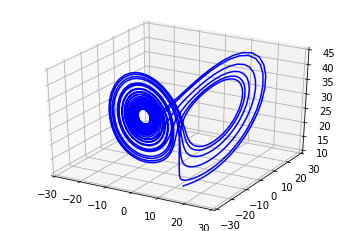

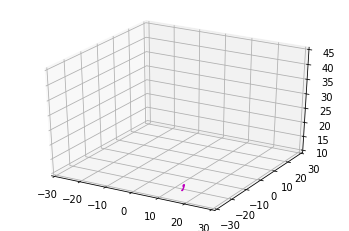

Iteration 0021 | Total Loss 266.040527
Iteration 0022 | Total Loss 271.793701
Iteration 0023 | Total Loss 266.138367
Iteration 0024 | Total Loss 261.421844
Iteration 0025 | Total Loss 265.619751


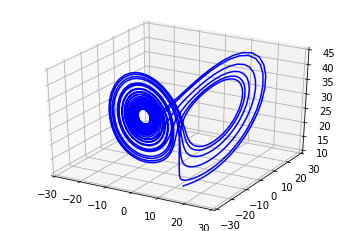

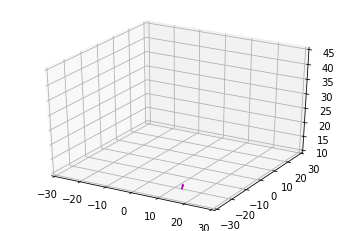

Iteration 0026 | Total Loss 267.587128
Iteration 0027 | Total Loss 268.083771
Iteration 0028 | Total Loss 269.563599
Iteration 0029 | Total Loss 267.778595
Iteration 0030 | Total Loss 242.922668


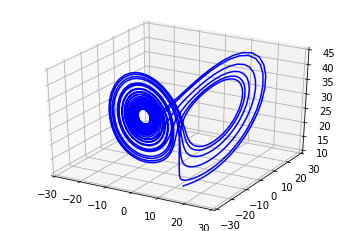

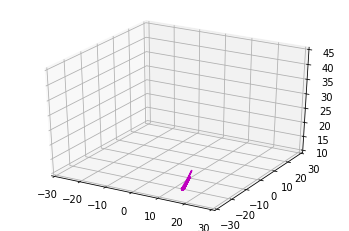

Iteration 0031 | Total Loss 261.671783
Iteration 0032 | Total Loss 241.570007
Iteration 0033 | Total Loss 257.007538
Iteration 0034 | Total Loss 235.425629
Iteration 0035 | Total Loss 267.700867


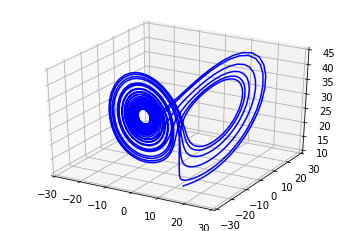

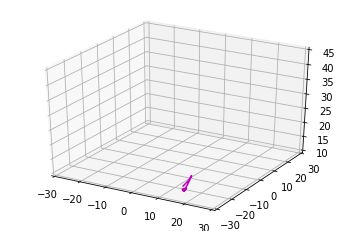

Iteration 0036 | Total Loss 225.634766
Iteration 0037 | Total Loss 271.558319
Iteration 0038 | Total Loss 23363.669922
Iteration 0039 | Total Loss 222.958466
Iteration 0040 | Total Loss 206.418335


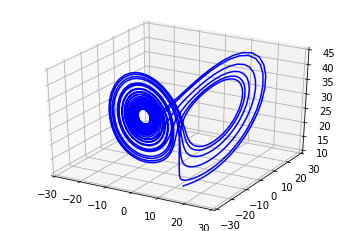

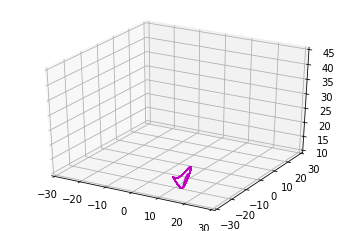

Iteration 0041 | Total Loss 233.797729
Iteration 0042 | Total Loss 258.260895
Iteration 0043 | Total Loss 168.179428
Iteration 0044 | Total Loss 148.464127
Iteration 0045 | Total Loss 164.004059


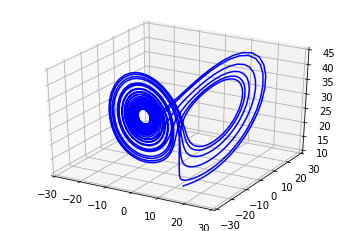

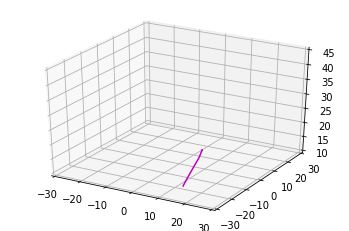

Iteration 0046 | Total Loss 239.993561
Iteration 0047 | Total Loss 227.264603
Iteration 0048 | Total Loss 208.222458
Iteration 0049 | Total Loss 230.785629
Iteration 0050 | Total Loss 258.665222


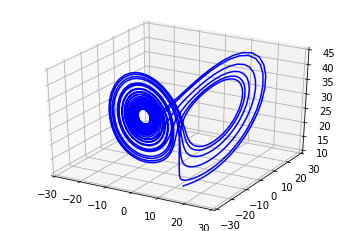

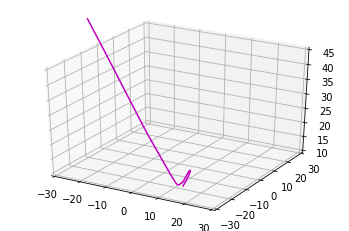

Iteration 0051 | Total Loss 101.316399
Iteration 0052 | Total Loss 249.687683
Iteration 0053 | Total Loss 47824.378906
Iteration 0054 | Total Loss 202.135681
Iteration 0055 | Total Loss 1952.854370


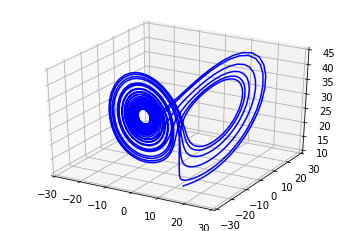

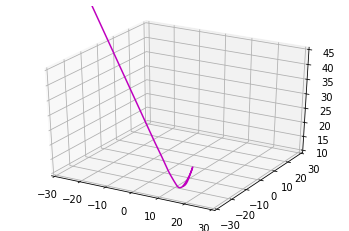

Iteration 0056 | Total Loss 947.485901
Iteration 0057 | Total Loss 382.365387
Iteration 0058 | Total Loss 116.604477
Iteration 0059 | Total Loss 181.137375
Iteration 0060 | Total Loss 23367.582031


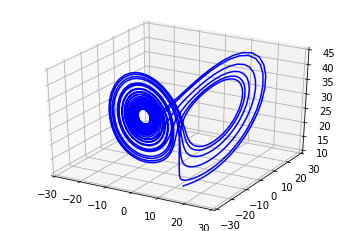

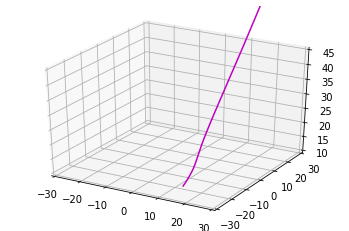

Iteration 0061 | Total Loss 11832.930664
Iteration 0062 | Total Loss 266.988464
Iteration 0063 | Total Loss 7247.052734
Iteration 0064 | Total Loss 9522.641602
Iteration 0065 | Total Loss 6435.076172


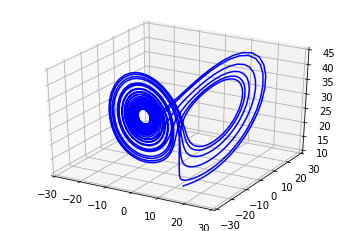

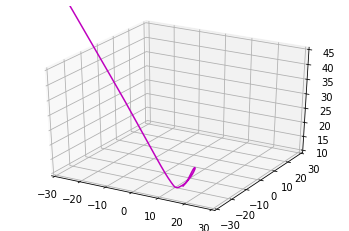

Iteration 0066 | Total Loss 191.484528
Iteration 0067 | Total Loss 175.551910
Iteration 0068 | Total Loss 30141.154297
Iteration 0069 | Total Loss 9977.634766
Iteration 0070 | Total Loss 6392.525879


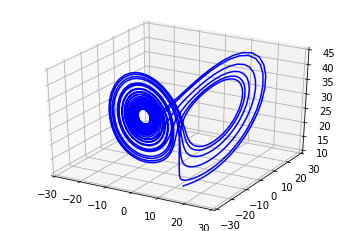

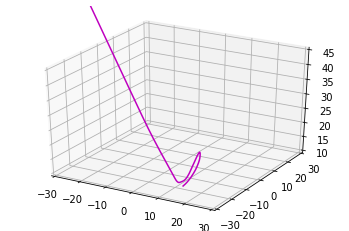

Iteration 0071 | Total Loss 4883.501953
Iteration 0072 | Total Loss 24830.582031
Iteration 0073 | Total Loss 8081.701172
Iteration 0074 | Total Loss 33152.246094
Iteration 0075 | Total Loss 139.410797


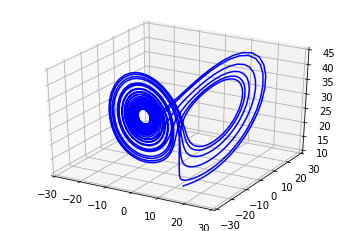

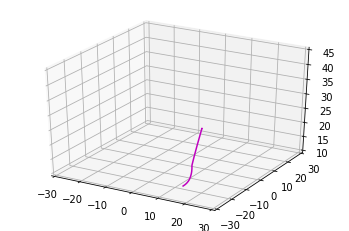

Iteration 0076 | Total Loss 14635.653320
Iteration 0077 | Total Loss 9389.570312
Iteration 0078 | Total Loss 7943.857422
Iteration 0079 | Total Loss 8638.694336
Iteration 0080 | Total Loss 14091.194336


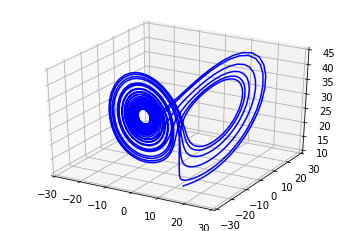

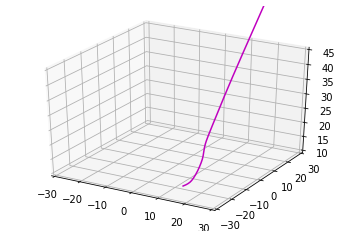

Iteration 0081 | Total Loss 6739.933105
Iteration 0082 | Total Loss 18554.611328
Iteration 0083 | Total Loss 5141.760742
Iteration 0084 | Total Loss 26433.212891
Iteration 0085 | Total Loss 5980.917480


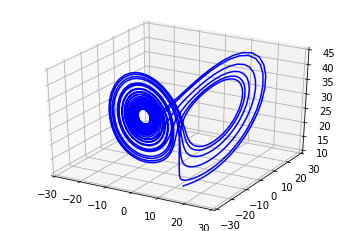

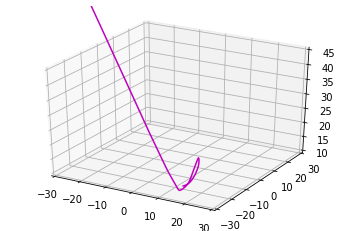

Iteration 0086 | Total Loss 8123.633301
Iteration 0087 | Total Loss 7253.900879
Iteration 0088 | Total Loss 4711.885254
Iteration 0089 | Total Loss 5552.076172
Iteration 0090 | Total Loss 61848.777344


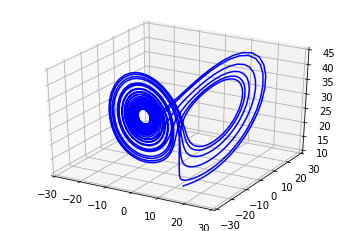

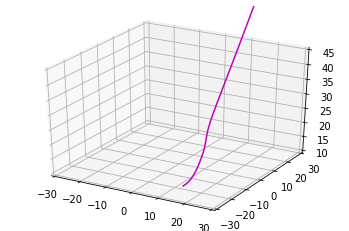

Iteration 0091 | Total Loss 9564.030273
Iteration 0092 | Total Loss 32010.962891
Iteration 0093 | Total Loss 7783.987305
Iteration 0094 | Total Loss 8442.549805
Iteration 0095 | Total Loss 43731.289062


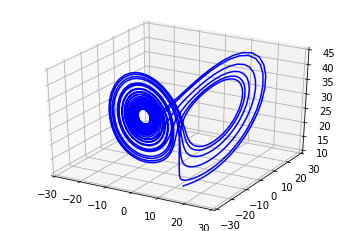

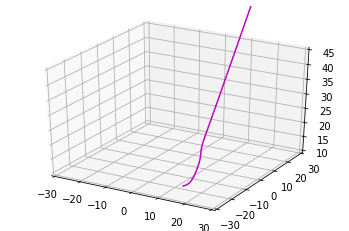

Iteration 0096 | Total Loss 7064.402832
Iteration 0097 | Total Loss 6685.315918
Iteration 0098 | Total Loss 6417.671875
Iteration 0099 | Total Loss 19628.998047
Iteration 0100 | Total Loss 226.498016


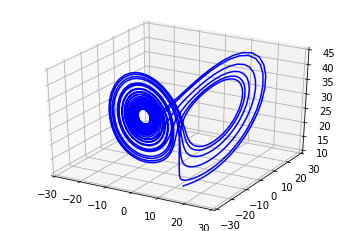

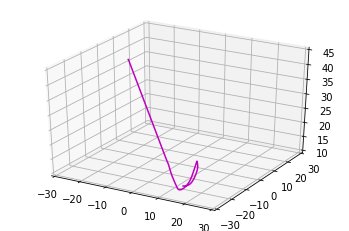

Iteration 0101 | Total Loss 76139.437500
Iteration 0102 | Total Loss 15179.248047
Iteration 0103 | Total Loss 21139.787109
Iteration 0104 | Total Loss 17277.125000
Iteration 0105 | Total Loss 20656.458984


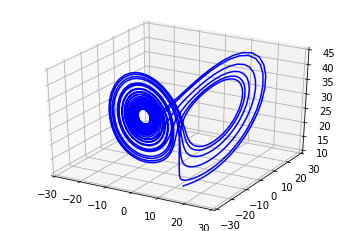

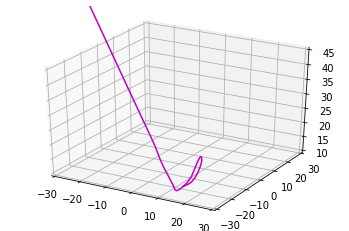

Iteration 0106 | Total Loss 10290.282227
Iteration 0107 | Total Loss 26811.960938
Iteration 0108 | Total Loss 6718.669922
Iteration 0109 | Total Loss 17495.984375
Iteration 0110 | Total Loss 14978.825195


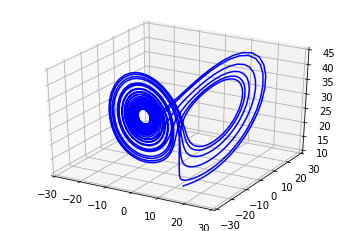

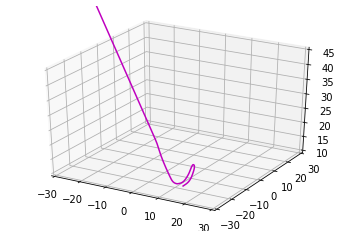

Iteration 0111 | Total Loss 56560.277344
Iteration 0112 | Total Loss 23516.064453
Iteration 0113 | Total Loss 26581.392578
Iteration 0114 | Total Loss 11177.981445
Iteration 0115 | Total Loss 11305.456055


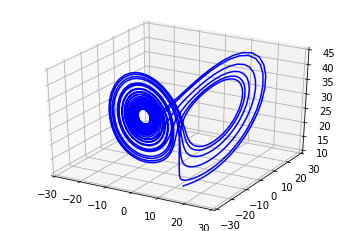

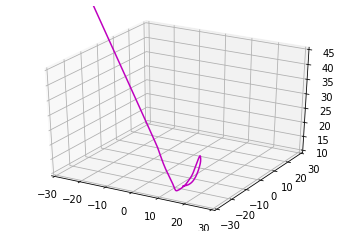

Iteration 0116 | Total Loss 7472.674805
Iteration 0117 | Total Loss 26011.333984
Iteration 0118 | Total Loss 58217.945312
Iteration 0119 | Total Loss 15405.378906
Iteration 0120 | Total Loss 86700.828125


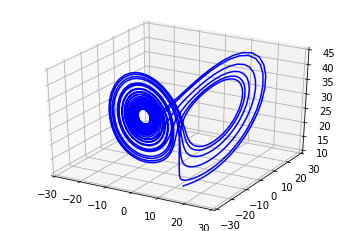

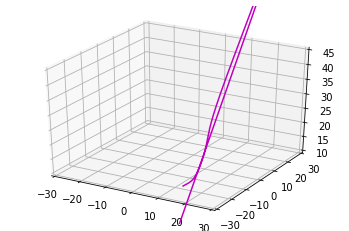

Iteration 0121 | Total Loss 26906.320312
Iteration 0122 | Total Loss 31643.000000
Iteration 0123 | Total Loss 31506.224609
Iteration 0124 | Total Loss 2426.396729
Iteration 0125 | Total Loss 13346.782227


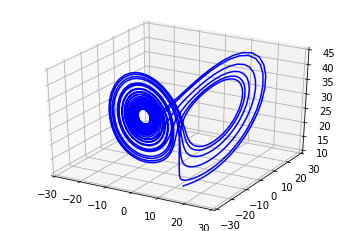

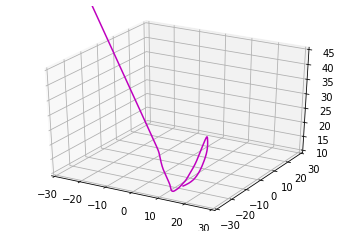

Iteration 0126 | Total Loss 7637.721191
Iteration 0127 | Total Loss 16026.555664
Iteration 0128 | Total Loss 14274.841797
Iteration 0129 | Total Loss 65209.562500
Iteration 0130 | Total Loss 13733.474609


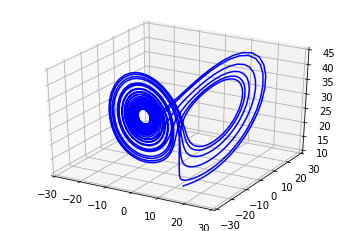

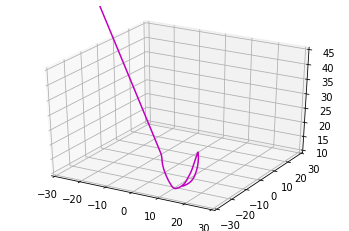

Iteration 0131 | Total Loss 13859.437500
Iteration 0132 | Total Loss 30126.968750
Iteration 0133 | Total Loss 27192.335938
Iteration 0134 | Total Loss 109315.382812
Iteration 0135 | Total Loss 36924.156250


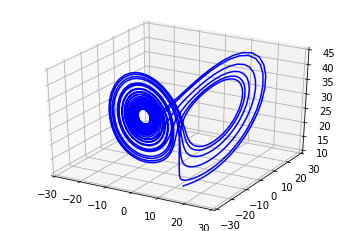

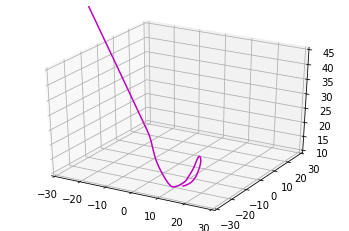

Iteration 0136 | Total Loss 97856.554688
Iteration 0137 | Total Loss 27809.812500
Iteration 0138 | Total Loss 117769.289062
Iteration 0139 | Total Loss 28303.414062
Iteration 0140 | Total Loss 65886.039062


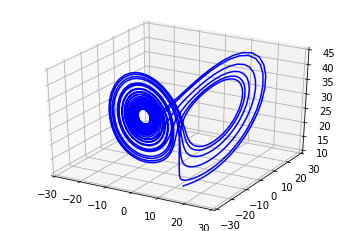

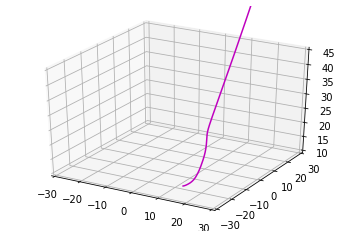

Iteration 0141 | Total Loss 32563.964844
Iteration 0142 | Total Loss 31192.607422
Iteration 0143 | Total Loss 45010.203125
Iteration 0144 | Total Loss 9293.641602
Iteration 0145 | Total Loss 11678.663086


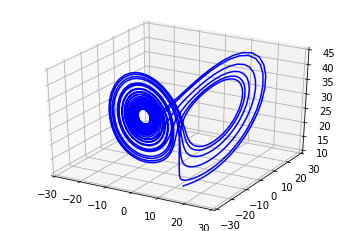

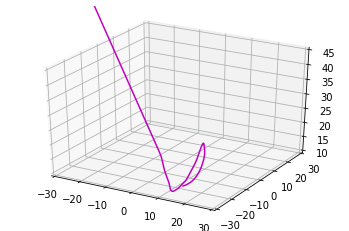

Iteration 0146 | Total Loss 18039.802734
Iteration 0147 | Total Loss 39904.507812
Iteration 0148 | Total Loss 20818.984375
Iteration 0149 | Total Loss 40282.957031
Iteration 0150 | Total Loss 30682.197266


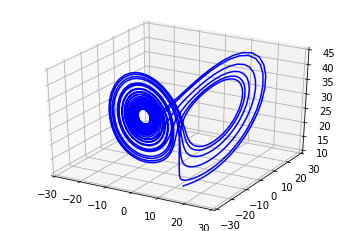

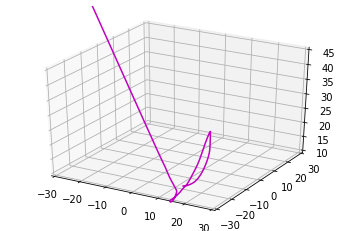

Iteration 0151 | Total Loss 53571.863281
Iteration 0152 | Total Loss 88143.132812
Iteration 0153 | Total Loss 59677.273438
Iteration 0154 | Total Loss 12452.646484
Iteration 0155 | Total Loss 23214.152344


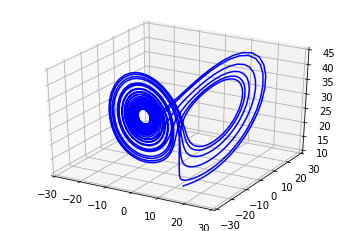

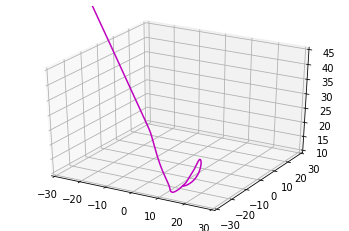

Iteration 0156 | Total Loss 133660.015625
Iteration 0157 | Total Loss 5105.751465
Iteration 0158 | Total Loss 27788.013672
Iteration 0159 | Total Loss 63839.347656
Iteration 0160 | Total Loss 11147.133789


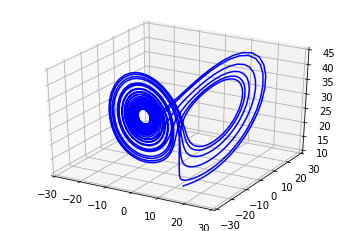

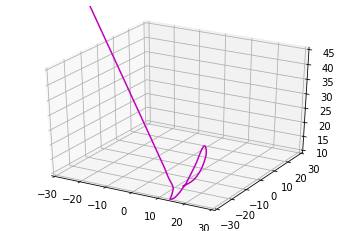

Iteration 0161 | Total Loss 44262.742188
Iteration 0162 | Total Loss 25392.611328
Iteration 0163 | Total Loss 14887.635742
Iteration 0164 | Total Loss 196758.187500
Iteration 0165 | Total Loss 7182.227539


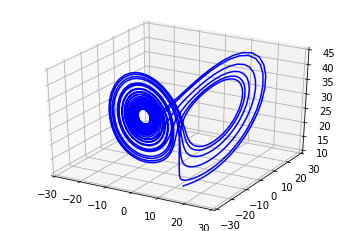

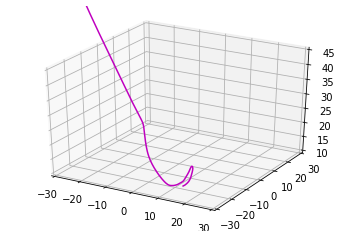

Iteration 0166 | Total Loss 84441.187500
Iteration 0167 | Total Loss 15064.416016
Iteration 0168 | Total Loss 78048.023438
Iteration 0169 | Total Loss 65169.019531
Iteration 0170 | Total Loss 58101.308594


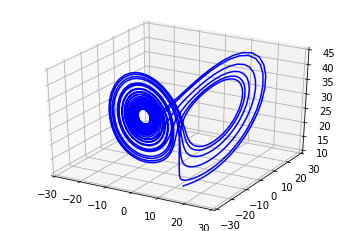

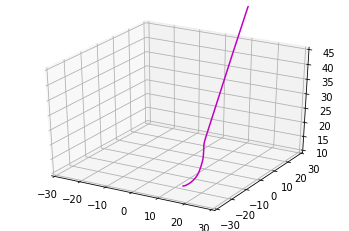

Iteration 0171 | Total Loss 73460.210938
Iteration 0172 | Total Loss 56800.847656
Iteration 0173 | Total Loss 104597.718750
Iteration 0174 | Total Loss 72506.218750
Iteration 0175 | Total Loss 90934.453125


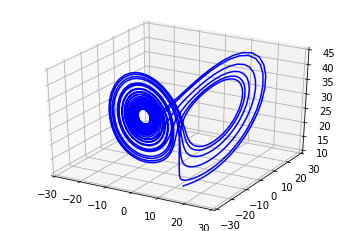

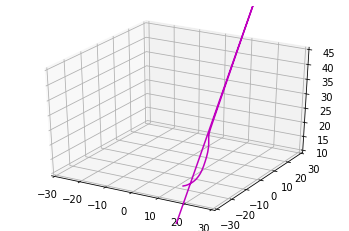

Iteration 0176 | Total Loss 23182.976562
Iteration 0177 | Total Loss 164085.468750
Iteration 0178 | Total Loss 39408.300781
Iteration 0179 | Total Loss 138276.937500
Iteration 0180 | Total Loss 73428.851562


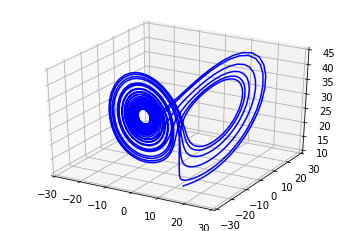

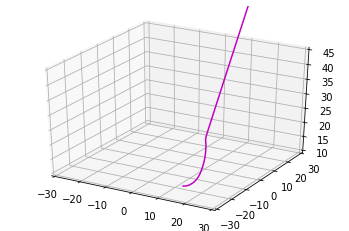

Iteration 0181 | Total Loss 65777.031250
Iteration 0182 | Total Loss 8175.589355
Iteration 0183 | Total Loss 27997.859375
Iteration 0184 | Total Loss 17403.742188
Iteration 0185 | Total Loss 40702.085938


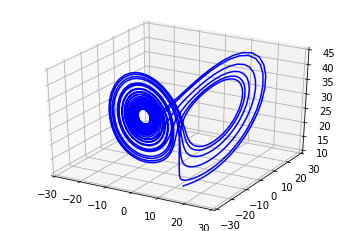

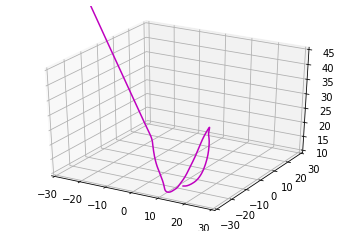

Iteration 0186 | Total Loss 19342.984375
Iteration 0187 | Total Loss 54010.910156
Iteration 0188 | Total Loss 45194.453125
Iteration 0189 | Total Loss 159088.125000
Iteration 0190 | Total Loss 8714.561523


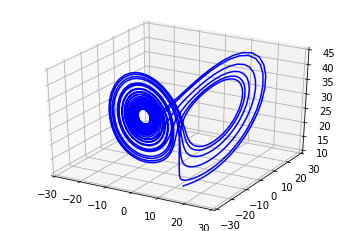

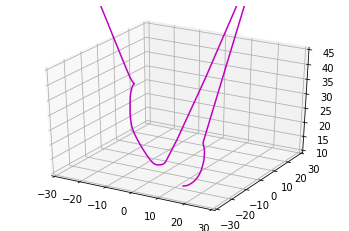

Iteration 0191 | Total Loss 31223.005859
Iteration 0192 | Total Loss 30086.039062
Iteration 0193 | Total Loss 223608.531250
Iteration 0194 | Total Loss 32697.447266
Iteration 0195 | Total Loss 113997.781250


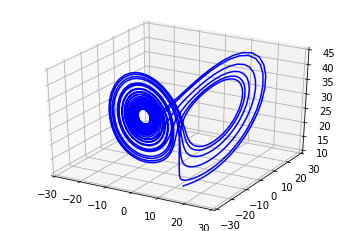

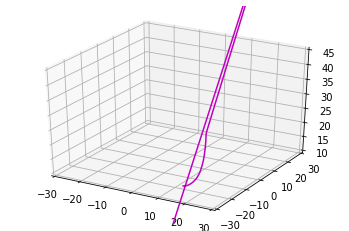

Iteration 0196 | Total Loss 76198.617188
Iteration 0197 | Total Loss 62401.472656
Iteration 0198 | Total Loss 178429.656250
Iteration 0199 | Total Loss 34423.957031
Iteration 0200 | Total Loss 205562.500000


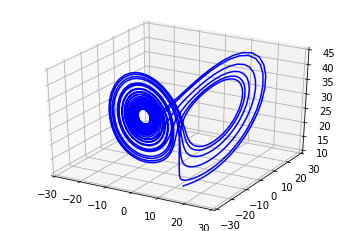

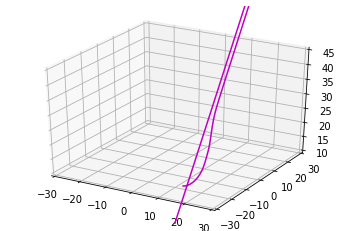

Iteration 0201 | Total Loss 97815.250000
Iteration 0202 | Total Loss 13200.489258
Iteration 0203 | Total Loss 65385.296875
Iteration 0204 | Total Loss 31821.851562
Iteration 0205 | Total Loss 41465.691406


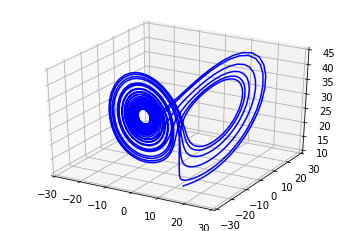

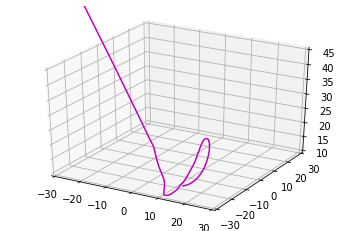

Iteration 0206 | Total Loss 36195.656250
Iteration 0207 | Total Loss 184623.343750
Iteration 0208 | Total Loss 28916.505859
Iteration 0209 | Total Loss 256242.109375
Iteration 0210 | Total Loss 54452.179688


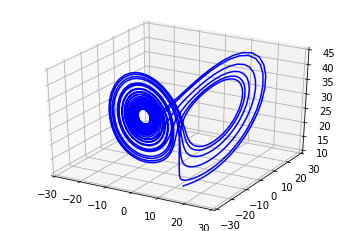

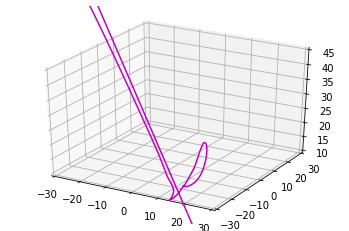

Iteration 0211 | Total Loss 261839.046875
Iteration 0212 | Total Loss 14977.193359
Iteration 0213 | Total Loss 73890.945312
Iteration 0214 | Total Loss 34535.679688
Iteration 0215 | Total Loss 28782.804688


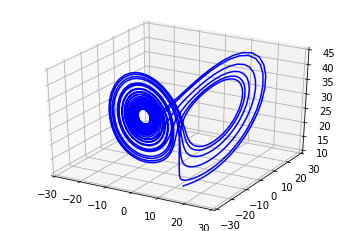

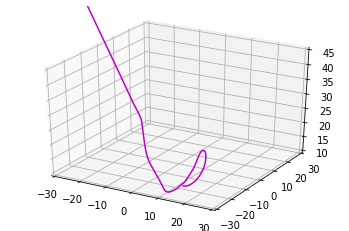

Iteration 0216 | Total Loss 278220.562500
Iteration 0217 | Total Loss 74890.257812
Iteration 0218 | Total Loss 367393.062500
Iteration 0219 | Total Loss 41293.445312
Iteration 0220 | Total Loss 332355.187500


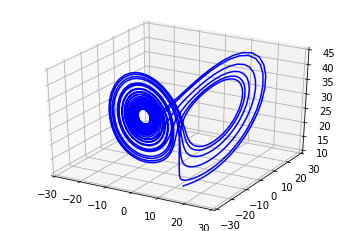

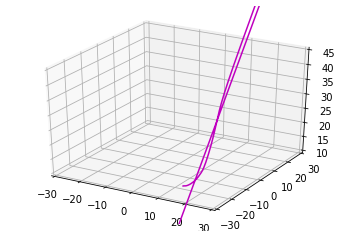

Iteration 0221 | Total Loss 30610.226562
Iteration 0222 | Total Loss 26487.943359
Iteration 0223 | Total Loss 40324.667969
Iteration 0224 | Total Loss 32565.822266
Iteration 0225 | Total Loss 83701.187500


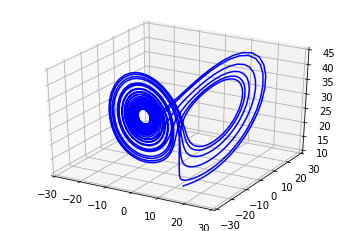

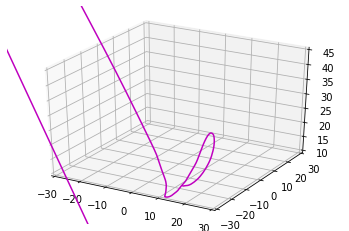

Iteration 0226 | Total Loss 58127.523438
Iteration 0227 | Total Loss 85832.195312
Iteration 0228 | Total Loss 39506.125000
Iteration 0229 | Total Loss 28635.503906
Iteration 0230 | Total Loss 19241.507812


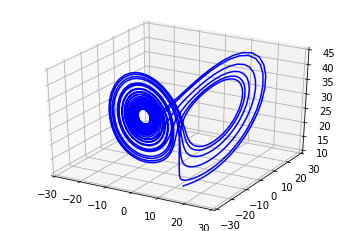

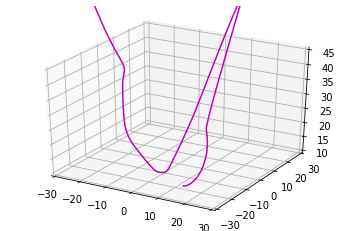

Iteration 0231 | Total Loss 39461.164062
Iteration 0232 | Total Loss 49392.316406
Iteration 0233 | Total Loss 54443.851562
Iteration 0234 | Total Loss 56887.148438
Iteration 0235 | Total Loss 73472.117188


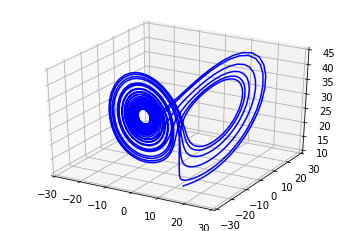

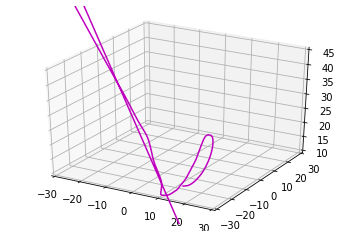

Iteration 0236 | Total Loss 33699.062500
Iteration 0237 | Total Loss 46304.601562
Iteration 0238 | Total Loss 30859.753906
Iteration 0239 | Total Loss 50071.402344
Iteration 0240 | Total Loss 18596.431641


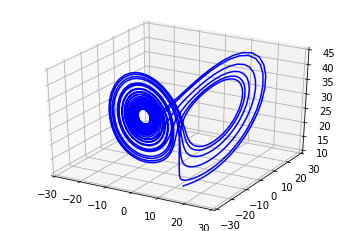

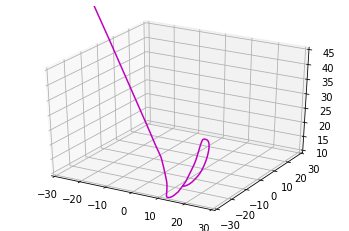

Iteration 0241 | Total Loss 67120.718750
Iteration 0242 | Total Loss 15141.229492
Iteration 0243 | Total Loss 405475.968750
Iteration 0244 | Total Loss 12260.678711
Iteration 0245 | Total Loss 306212.531250


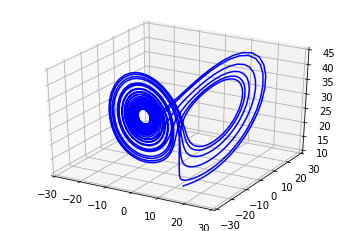

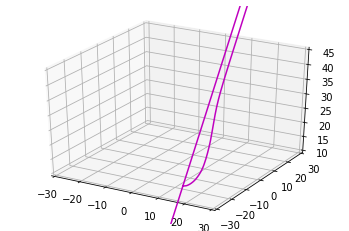

Iteration 0246 | Total Loss 301115.125000
Iteration 0247 | Total Loss 73589.054688
Iteration 0248 | Total Loss 30146.501953
Iteration 0249 | Total Loss 27161.232422
Iteration 0250 | Total Loss 15755.270508


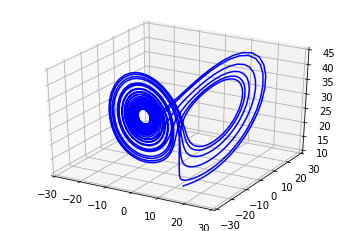

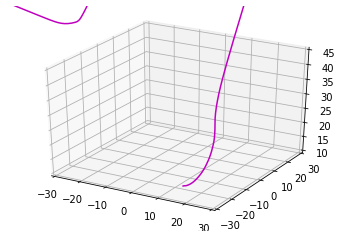

Iteration 0251 | Total Loss 27265.736328
Iteration 0252 | Total Loss 26094.976562
Iteration 0253 | Total Loss 79457.656250
Iteration 0254 | Total Loss 29874.597656
Iteration 0255 | Total Loss 31032.099609


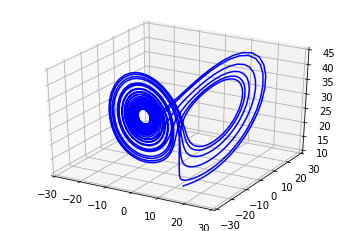

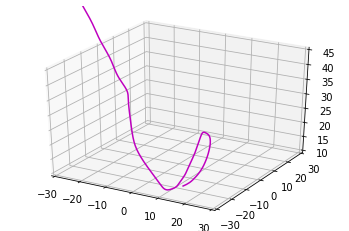

Iteration 0256 | Total Loss 44039.707031
Iteration 0257 | Total Loss 90373.203125
Iteration 0258 | Total Loss 34949.785156
Iteration 0259 | Total Loss 81940.992188
Iteration 0260 | Total Loss 66149.148438


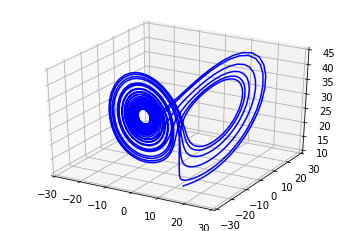

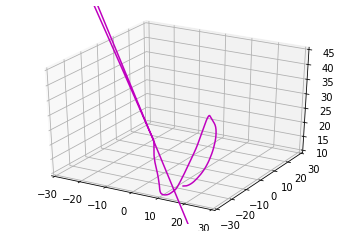

Iteration 0261 | Total Loss 89320.015625
Iteration 0262 | Total Loss 87354.039062
Iteration 0263 | Total Loss 49298.015625
Iteration 0264 | Total Loss 32406.880859
Iteration 0265 | Total Loss 56445.894531


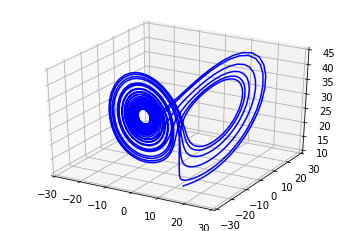

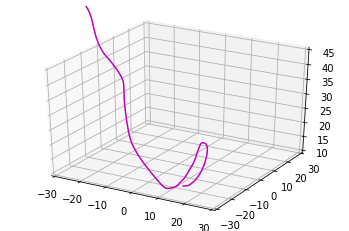

Iteration 0266 | Total Loss 500454.281250
Iteration 0267 | Total Loss 69767.406250
Iteration 0268 | Total Loss 68216.781250
Iteration 0269 | Total Loss 104500.265625
Iteration 0270 | Total Loss 73484.609375


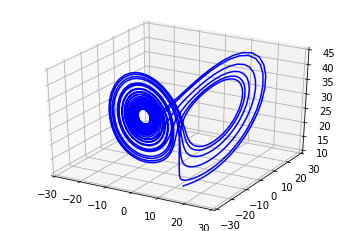

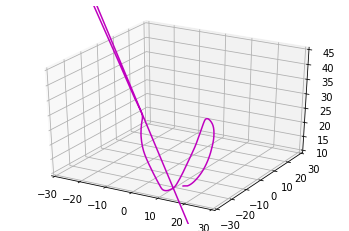

Iteration 0271 | Total Loss 99479.453125
Iteration 0272 | Total Loss 56281.179688
Iteration 0273 | Total Loss 102638.773438
Iteration 0274 | Total Loss 75991.085938
Iteration 0275 | Total Loss 107108.984375


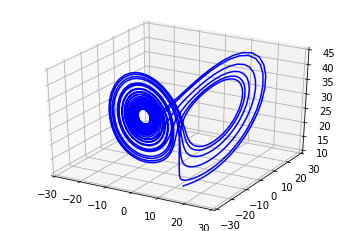

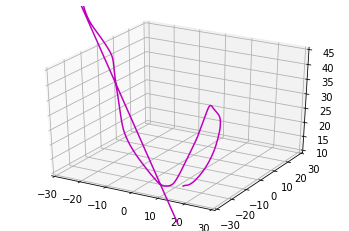

Iteration 0276 | Total Loss 51628.773438
Iteration 0277 | Total Loss 484718.000000
Iteration 0278 | Total Loss 45887.332031
Iteration 0279 | Total Loss 90815.359375
Iteration 0280 | Total Loss 24400.132812


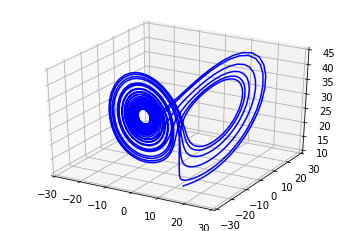

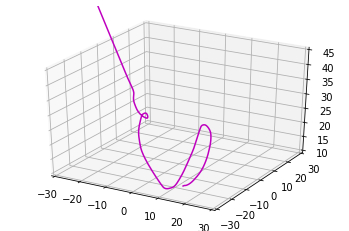

Iteration 0281 | Total Loss 94470.679688
Iteration 0282 | Total Loss 14507.029297
Iteration 0283 | Total Loss 109804.500000
Iteration 0284 | Total Loss 104646.039062
Iteration 0285 | Total Loss 31135.476562


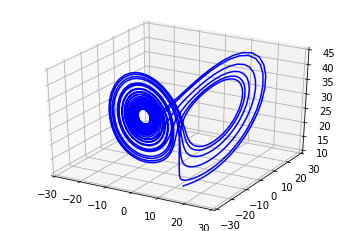

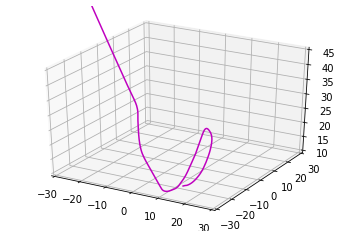

Iteration 0286 | Total Loss 28370.509766
Iteration 0287 | Total Loss 89776.257812
Iteration 0288 | Total Loss 34022.945312
Iteration 0289 | Total Loss 85449.554688
Iteration 0290 | Total Loss 536553.625000


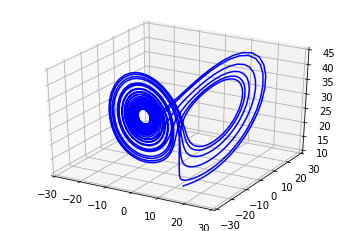

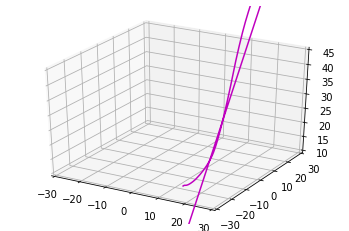

Iteration 0291 | Total Loss 49374.191406
Iteration 0292 | Total Loss 534371.812500
Iteration 0293 | Total Loss 32863.843750
Iteration 0294 | Total Loss 530714.437500
Iteration 0295 | Total Loss 76783.085938


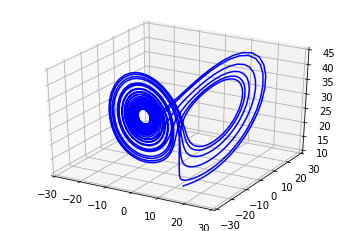

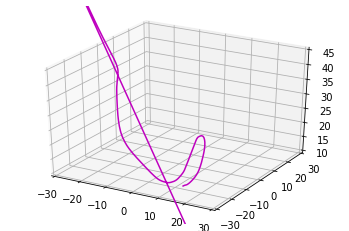

Iteration 0296 | Total Loss 553109.312500
Iteration 0297 | Total Loss 110636.203125
Iteration 0298 | Total Loss 393110.812500
Iteration 0299 | Total Loss 388535.156250
Iteration 0300 | Total Loss 78774.960938


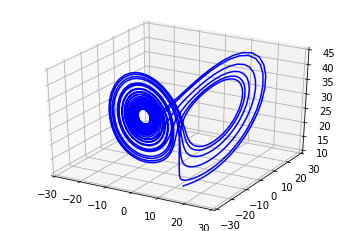

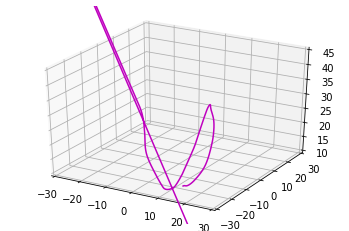

Iteration 0301 | Total Loss 109462.750000
Iteration 0302 | Total Loss 105290.195312
Iteration 0303 | Total Loss 100393.234375
Iteration 0304 | Total Loss 72466.953125
Iteration 0305 | Total Loss 87138.968750


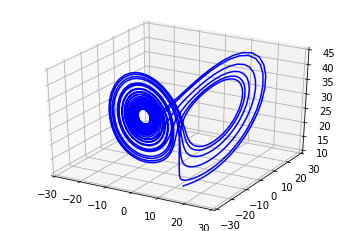

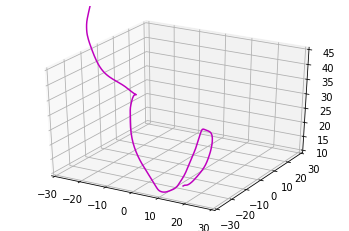

Iteration 0306 | Total Loss 58981.910156
Iteration 0307 | Total Loss 114313.078125
Iteration 0308 | Total Loss 67880.531250
Iteration 0309 | Total Loss 81409.070312
Iteration 0310 | Total Loss 50680.421875


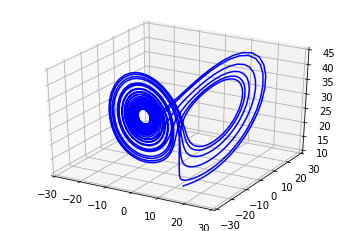

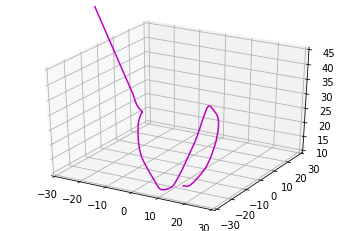

Iteration 0311 | Total Loss 86495.406250
Iteration 0312 | Total Loss 65287.722656
Iteration 0313 | Total Loss 93542.250000
Iteration 0314 | Total Loss 33641.160156
Iteration 0315 | Total Loss 81258.773438


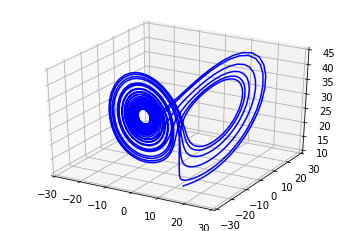

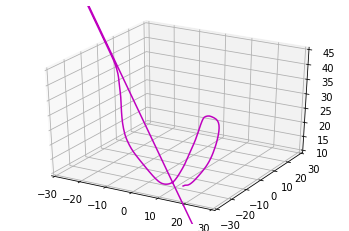

Iteration 0316 | Total Loss 67595.265625
Iteration 0317 | Total Loss 82142.617188
Iteration 0318 | Total Loss 79482.242188
Iteration 0319 | Total Loss 83647.898438
Iteration 0320 | Total Loss 79008.578125


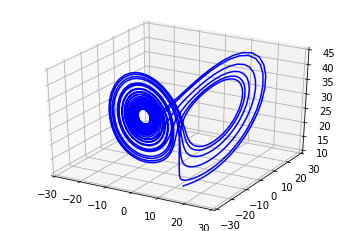

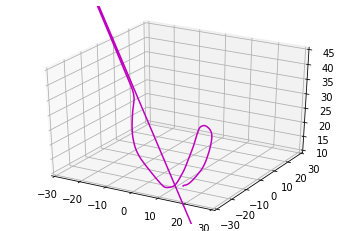

Iteration 0321 | Total Loss 81359.875000
Iteration 0322 | Total Loss 62372.910156
Iteration 0323 | Total Loss 87986.890625
Iteration 0324 | Total Loss 55085.667969
Iteration 0325 | Total Loss 85035.304688


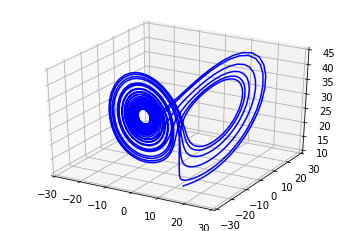

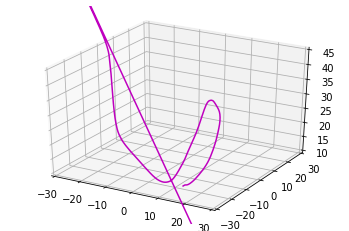

Iteration 0326 | Total Loss 68699.453125
Iteration 0327 | Total Loss 88601.250000
Iteration 0328 | Total Loss 49972.527344
Iteration 0329 | Total Loss 89194.359375
Iteration 0330 | Total Loss 47882.785156


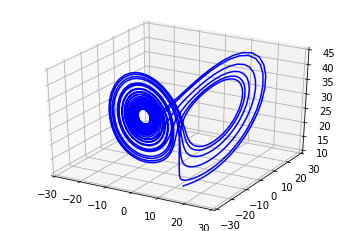

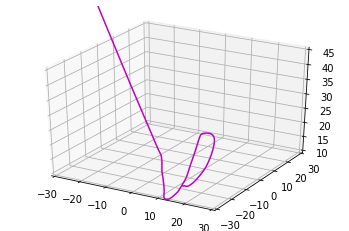

Iteration 0331 | Total Loss 562471.625000
Iteration 0332 | Total Loss 37336.617188
Iteration 0333 | Total Loss 550710.625000
Iteration 0334 | Total Loss 33122.148438
Iteration 0335 | Total Loss 176181.140625


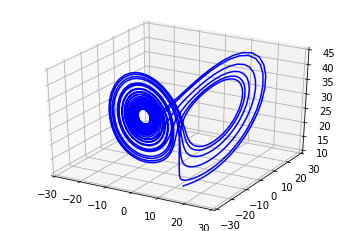

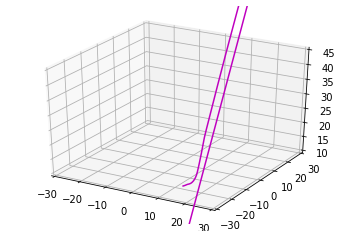

Iteration 0336 | Total Loss 146144.093750
Iteration 0337 | Total Loss 440746.187500
Iteration 0338 | Total Loss 446536.375000
Iteration 0339 | Total Loss 500493.343750
Iteration 0340 | Total Loss 432789.843750


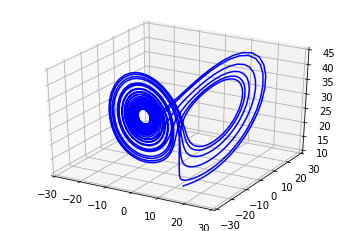

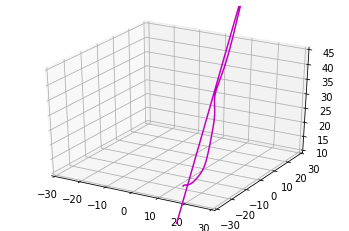

Iteration 0341 | Total Loss 422579.718750
Iteration 0342 | Total Loss 509921.750000
Iteration 0343 | Total Loss 72271.757812
Iteration 0344 | Total Loss 82995.890625
Iteration 0345 | Total Loss 86984.398438


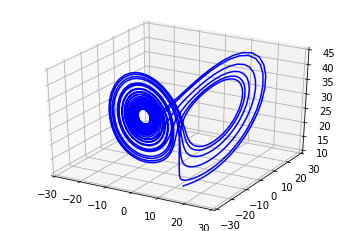

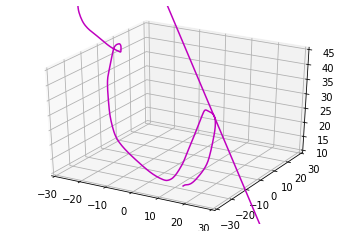

Iteration 0346 | Total Loss 64873.312500
Iteration 0347 | Total Loss 87352.234375
Iteration 0348 | Total Loss 79916.460938
Iteration 0349 | Total Loss 93187.601562
Iteration 0350 | Total Loss 73666.328125


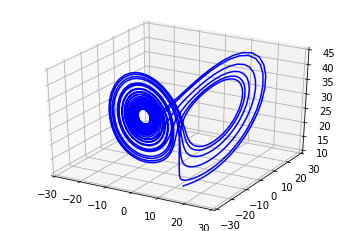

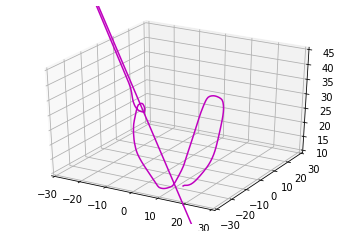

Iteration 0351 | Total Loss 92076.062500
Iteration 0352 | Total Loss 532350.250000
Iteration 0353 | Total Loss 481265.843750
Iteration 0354 | Total Loss 604571.062500
Iteration 0355 | Total Loss 597136.500000


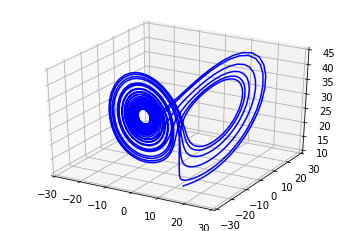

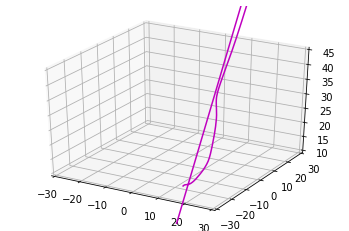

Iteration 0356 | Total Loss 581955.000000
Iteration 0357 | Total Loss 82714.585938
Iteration 0358 | Total Loss 520788.406250
Iteration 0359 | Total Loss 89334.078125
Iteration 0360 | Total Loss 47977.457031


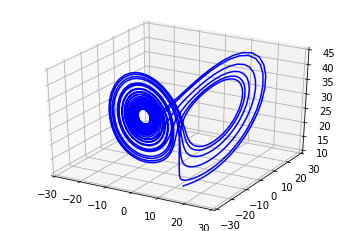

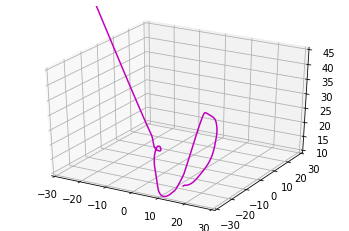

Iteration 0361 | Total Loss 92090.421875
Iteration 0362 | Total Loss 78937.406250
Iteration 0363 | Total Loss 94098.625000
Iteration 0364 | Total Loss 82813.421875
Iteration 0365 | Total Loss 65910.585938


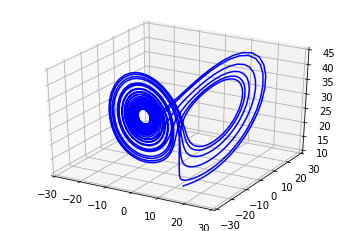

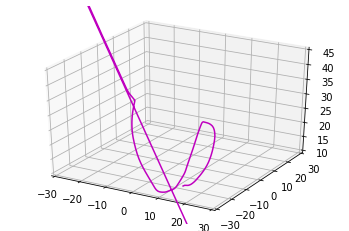

Iteration 0366 | Total Loss 613010.062500
Iteration 0367 | Total Loss 90550.734375
Iteration 0368 | Total Loss 664000.000000
Iteration 0369 | Total Loss 87396.007812
Iteration 0370 | Total Loss 556603.125000


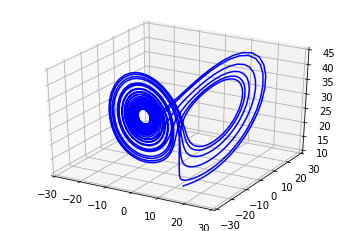

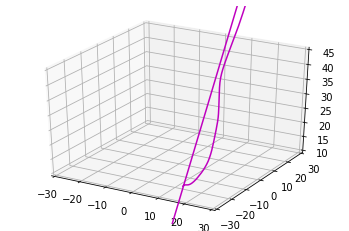

Iteration 0371 | Total Loss 420628.406250
Iteration 0372 | Total Loss 398757.937500
Iteration 0373 | Total Loss 90938.710938
Iteration 0374 | Total Loss 37920.796875
Iteration 0375 | Total Loss 95878.476562


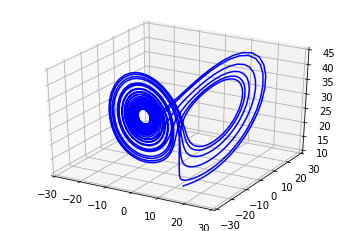

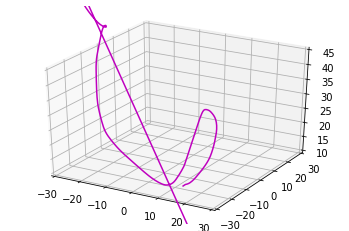

Iteration 0376 | Total Loss 32849.429688
Iteration 0377 | Total Loss 97409.453125
Iteration 0378 | Total Loss 68169.171875
Iteration 0379 | Total Loss 104182.062500
Iteration 0380 | Total Loss 49952.980469


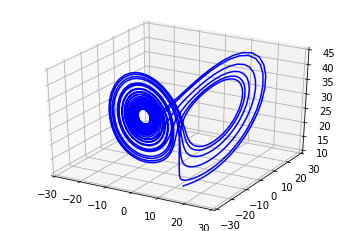

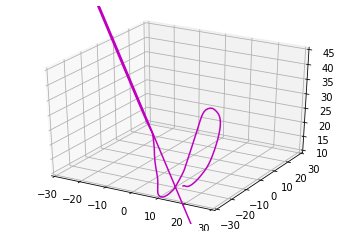

Iteration 0381 | Total Loss 57645.476562
Iteration 0382 | Total Loss 659074.875000
Iteration 0383 | Total Loss 100476.023438
Iteration 0384 | Total Loss 424039.500000
Iteration 0385 | Total Loss 97109.523438


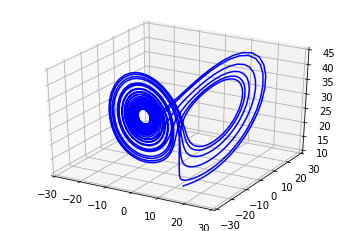

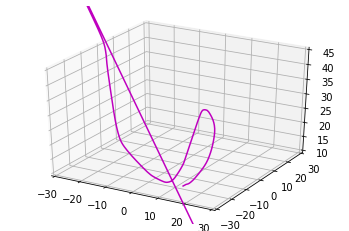

Iteration 0386 | Total Loss 76274.250000
Iteration 0387 | Total Loss 73724.257812
Iteration 0388 | Total Loss 577591.062500
Iteration 0389 | Total Loss 82899.335938
Iteration 0390 | Total Loss 638588.437500


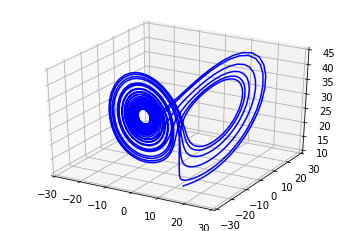

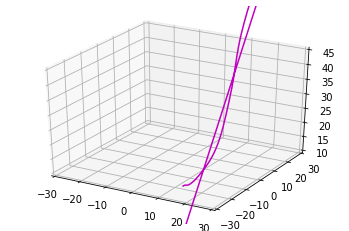

Iteration 0391 | Total Loss 97291.304688
Iteration 0392 | Total Loss 31014.386719
Iteration 0393 | Total Loss 86615.906250
Iteration 0394 | Total Loss 45184.753906
Iteration 0395 | Total Loss 87798.390625


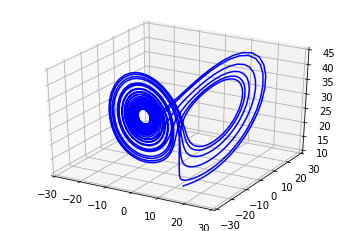

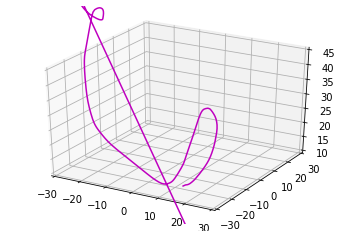

Iteration 0396 | Total Loss 35646.257812
Iteration 0397 | Total Loss 49329.253906
Iteration 0398 | Total Loss 595451.875000
Iteration 0399 | Total Loss 62755.785156
Iteration 0400 | Total Loss 575306.687500


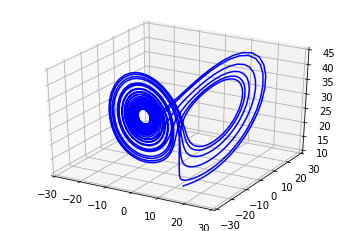

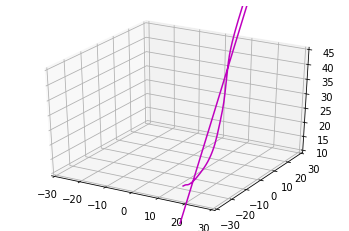

Iteration 0401 | Total Loss 170154.031250
Iteration 0402 | Total Loss 35410.984375
Iteration 0403 | Total Loss 93705.054688
Iteration 0404 | Total Loss 64800.601562
Iteration 0405 | Total Loss 54454.261719


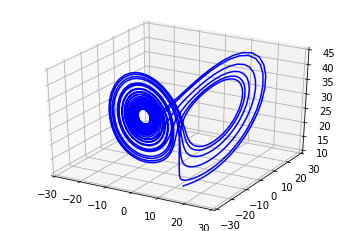

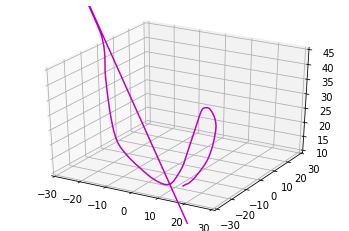

Iteration 0406 | Total Loss 36718.347656
Iteration 0407 | Total Loss 40152.171875
Iteration 0408 | Total Loss 32456.554688
Iteration 0409 | Total Loss 50517.414062
Iteration 0410 | Total Loss 32026.490234


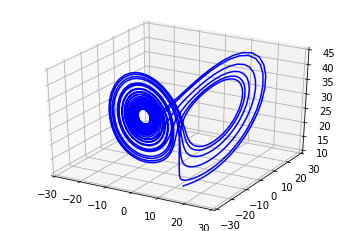

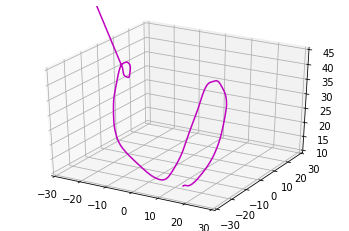

Iteration 0411 | Total Loss 81143.468750
Iteration 0412 | Total Loss 722883.312500
Iteration 0413 | Total Loss 89305.117188
Iteration 0414 | Total Loss 167018.593750
Iteration 0415 | Total Loss 64641.617188


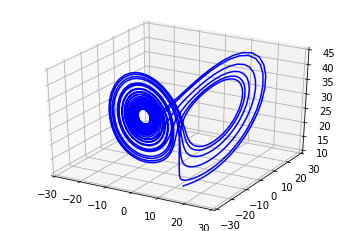

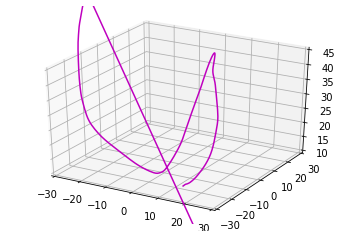

Iteration 0416 | Total Loss 32407.939453
Iteration 0417 | Total Loss 38356.683594
Iteration 0418 | Total Loss 31177.931641
Iteration 0419 | Total Loss 42414.449219
Iteration 0420 | Total Loss 1933.306885


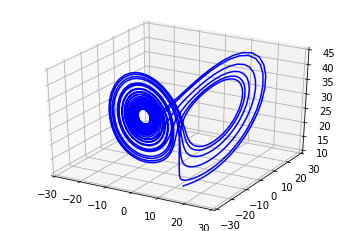

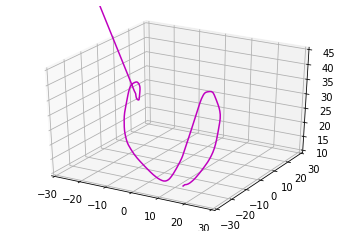

Iteration 0421 | Total Loss 76690.007812
Iteration 0422 | Total Loss 33392.476562
Iteration 0423 | Total Loss 44368.218750
Iteration 0424 | Total Loss 34830.578125
Iteration 0425 | Total Loss 38311.019531


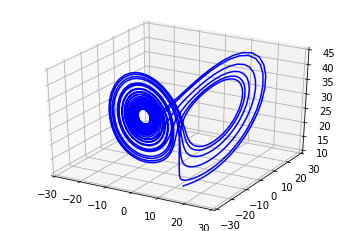

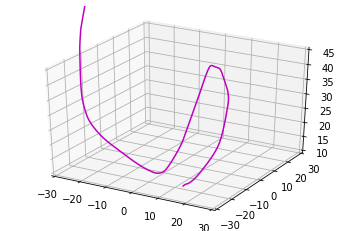

Iteration 0426 | Total Loss 34933.722656
Iteration 0427 | Total Loss 36301.046875
Iteration 0428 | Total Loss 34997.785156
Iteration 0429 | Total Loss 38229.773438
Iteration 0430 | Total Loss 34538.921875


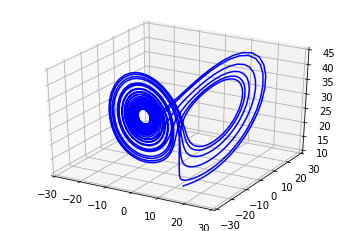

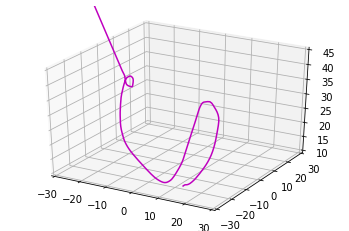

Iteration 0431 | Total Loss 40579.171875
Iteration 0432 | Total Loss 34281.367188
Iteration 0433 | Total Loss 41573.535156
Iteration 0434 | Total Loss 33801.542969
Iteration 0435 | Total Loss 38660.488281


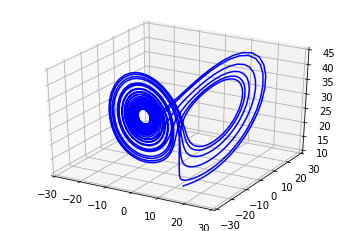

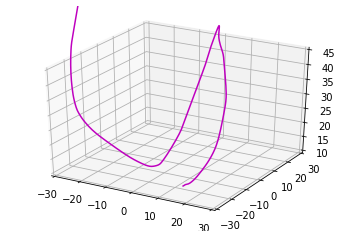

Iteration 0436 | Total Loss 35153.414062
Iteration 0437 | Total Loss 42474.500000
Iteration 0438 | Total Loss 30622.042969
Iteration 0439 | Total Loss 41212.058594
Iteration 0440 | Total Loss 38132.589844


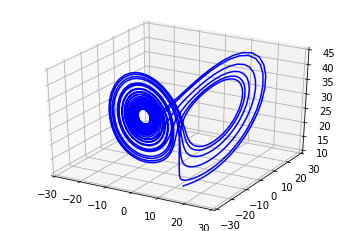

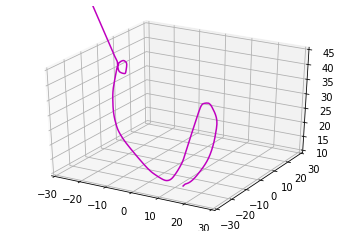

Iteration 0441 | Total Loss 39203.746094
Iteration 0442 | Total Loss 36283.492188
Iteration 0443 | Total Loss 38934.832031
Iteration 0444 | Total Loss 36342.207031
Iteration 0445 | Total Loss 40733.500000


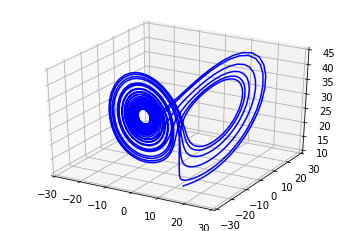

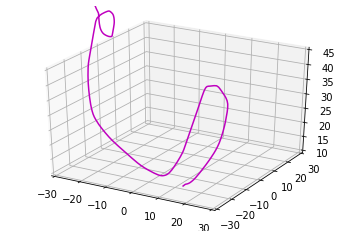

Iteration 0446 | Total Loss 36706.425781
Iteration 0447 | Total Loss 39842.628906
Iteration 0448 | Total Loss 34637.515625
Iteration 0449 | Total Loss 519600.781250
Iteration 0450 | Total Loss 34199.207031


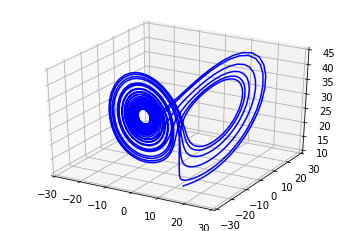

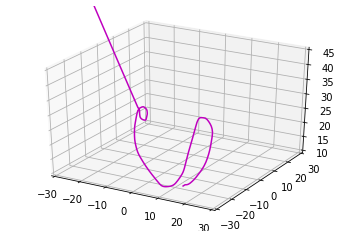

Iteration 0451 | Total Loss 741390.437500
Iteration 0452 | Total Loss 35456.582031
Iteration 0453 | Total Loss 39957.578125
Iteration 0454 | Total Loss 36205.753906
Iteration 0455 | Total Loss 38803.480469


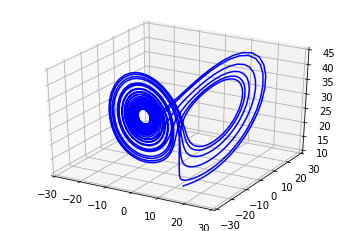

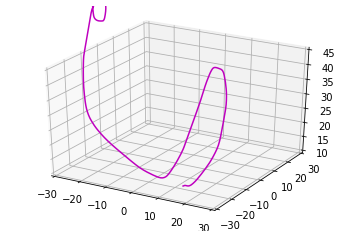

Iteration 0456 | Total Loss 30134.052734
Iteration 0457 | Total Loss 619946.000000
Iteration 0458 | Total Loss 27514.716797
Iteration 0459 | Total Loss 512371.656250
Iteration 0460 | Total Loss 34380.488281


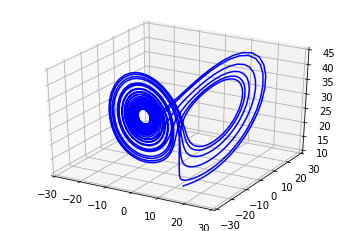

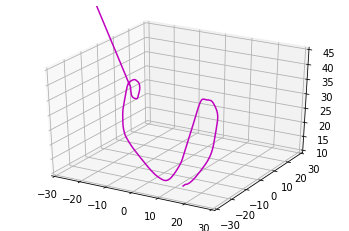

Iteration 0461 | Total Loss 419447.156250
Iteration 0462 | Total Loss 38281.808594
Iteration 0463 | Total Loss 39492.660156
Iteration 0464 | Total Loss 36273.781250
Iteration 0465 | Total Loss 40584.894531


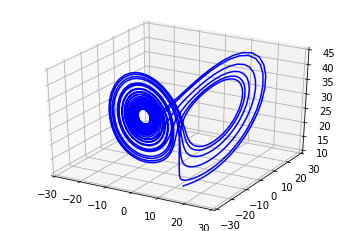

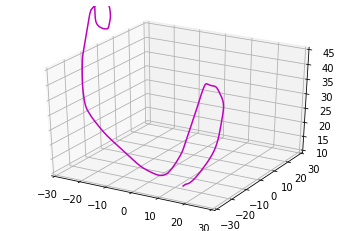

Iteration 0466 | Total Loss 36200.992188
Iteration 0467 | Total Loss 45493.941406
Iteration 0468 | Total Loss 39511.230469
Iteration 0469 | Total Loss 43353.660156
Iteration 0470 | Total Loss 37977.117188


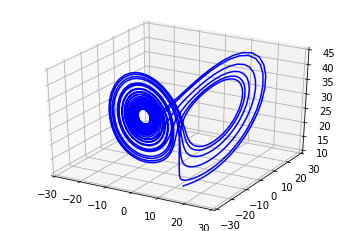

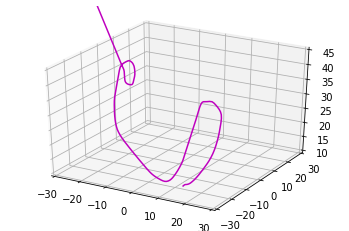

Iteration 0471 | Total Loss 42619.746094
Iteration 0472 | Total Loss 36565.152344
Iteration 0473 | Total Loss 42305.300781
Iteration 0474 | Total Loss 27143.634766
Iteration 0475 | Total Loss 44792.003906


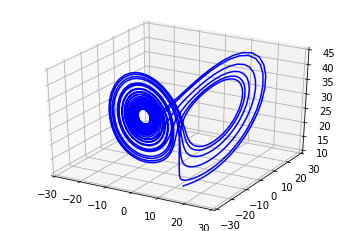

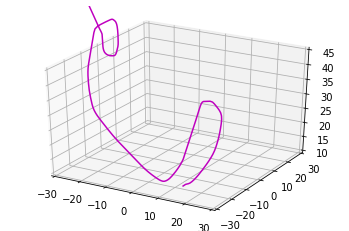

Iteration 0476 | Total Loss 35574.214844
Iteration 0477 | Total Loss 43284.281250
Iteration 0478 | Total Loss 676095.437500
Iteration 0479 | Total Loss 42071.148438
Iteration 0480 | Total Loss 746917.125000


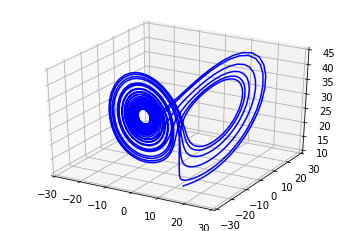

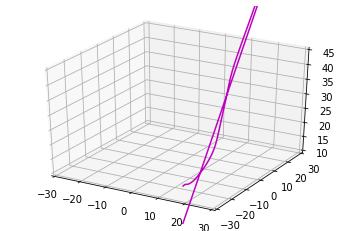

Iteration 0481 | Total Loss 44161.406250
Iteration 0482 | Total Loss 691201.562500
Iteration 0483 | Total Loss 43225.667969
Iteration 0484 | Total Loss 641173.812500
Iteration 0485 | Total Loss 41425.824219


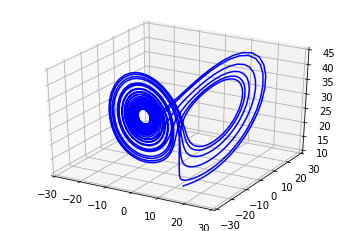

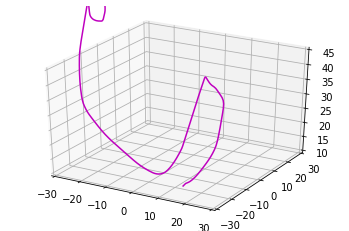

Iteration 0486 | Total Loss 37108.132812
Iteration 0487 | Total Loss 41353.355469
Iteration 0488 | Total Loss 35871.792969
Iteration 0489 | Total Loss 41127.902344
Iteration 0490 | Total Loss 752017.750000


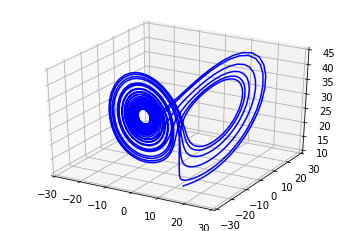

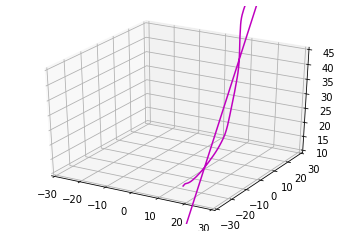

Iteration 0491 | Total Loss 43098.925781
Iteration 0492 | Total Loss 564113.625000
Iteration 0493 | Total Loss 344407.968750
Iteration 0494 | Total Loss 594903.750000
Iteration 0495 | Total Loss 45418.507812


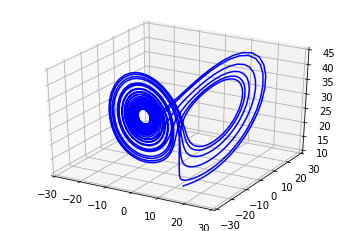

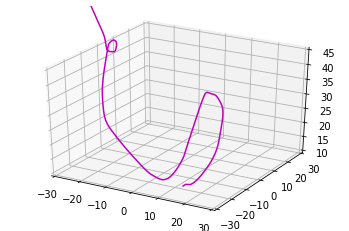

Iteration 0496 | Total Loss 41038.511719
Iteration 0497 | Total Loss 41849.792969
Iteration 0498 | Total Loss 39020.484375
Iteration 0499 | Total Loss 40460.195312
Iteration 0500 | Total Loss 37032.343750


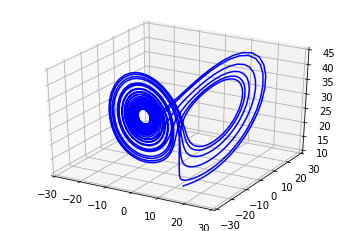

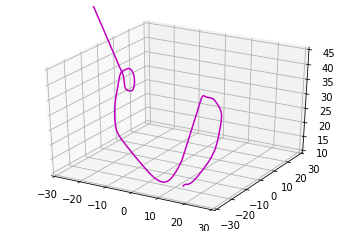

Iteration 0501 | Total Loss 41087.191406
Iteration 0502 | Total Loss 35729.367188
Iteration 0503 | Total Loss 41957.652344
Iteration 0504 | Total Loss 35309.011719
Iteration 0505 | Total Loss 40483.929688


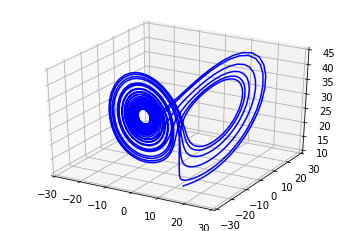

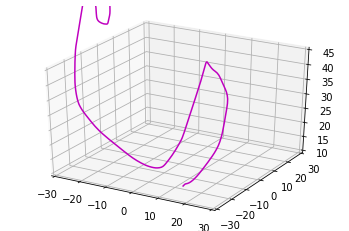

Iteration 0506 | Total Loss 37424.183594
Iteration 0507 | Total Loss 562703.750000
Iteration 0508 | Total Loss 36658.429688
Iteration 0509 | Total Loss 769238.500000
Iteration 0510 | Total Loss 36294.019531


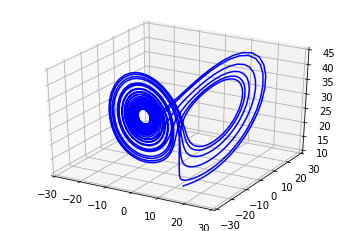

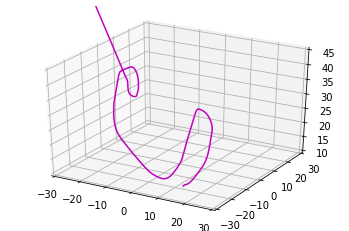

Iteration 0511 | Total Loss 464377.218750
Iteration 0512 | Total Loss 35552.847656
Iteration 0513 | Total Loss 346907.250000
Iteration 0514 | Total Loss 34248.992188
Iteration 0515 | Total Loss 38732.398438


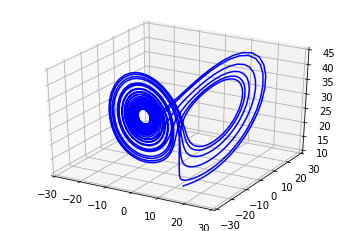

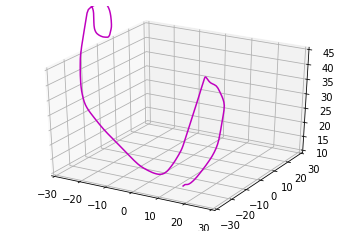

Iteration 0516 | Total Loss 28940.148438
Iteration 0517 | Total Loss 51221.828125
Iteration 0518 | Total Loss 27685.693359
Iteration 0519 | Total Loss 53654.964844
Iteration 0520 | Total Loss 40168.929688


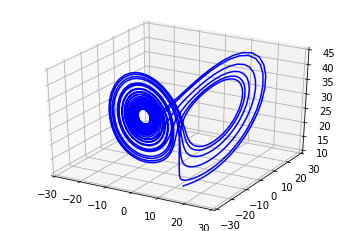

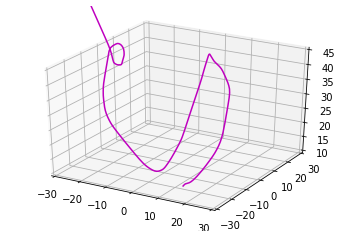

Iteration 0521 | Total Loss 43144.304688
Iteration 0522 | Total Loss 38910.257812
Iteration 0523 | Total Loss 39809.816406
Iteration 0524 | Total Loss 36713.445312
Iteration 0525 | Total Loss 38972.359375


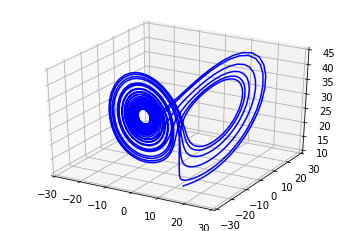

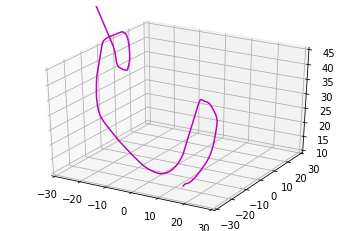

Iteration 0526 | Total Loss 570091.312500
Iteration 0527 | Total Loss 38864.574219
Iteration 0528 | Total Loss 37384.246094
Iteration 0529 | Total Loss 38216.246094
Iteration 0530 | Total Loss 36226.875000


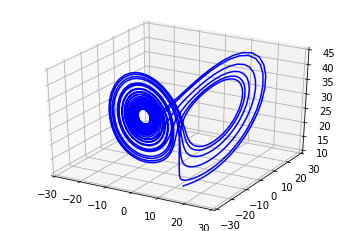

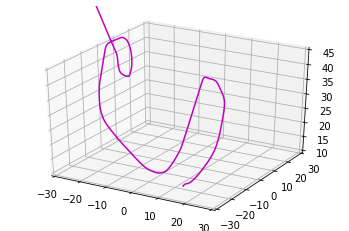

Iteration 0531 | Total Loss 37798.605469
Iteration 0532 | Total Loss 36091.257812
Iteration 0533 | Total Loss 38490.621094
Iteration 0534 | Total Loss 35898.156250
Iteration 0535 | Total Loss 38096.960938


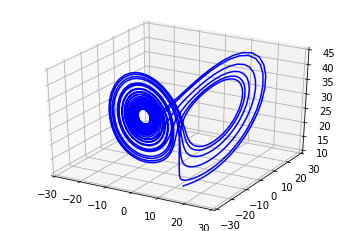

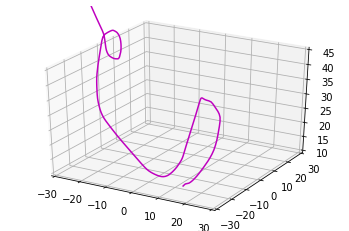

Iteration 0536 | Total Loss 687359.250000
Iteration 0537 | Total Loss 37977.625000
Iteration 0538 | Total Loss 34534.609375
Iteration 0539 | Total Loss 40311.582031
Iteration 0540 | Total Loss 1830.180298


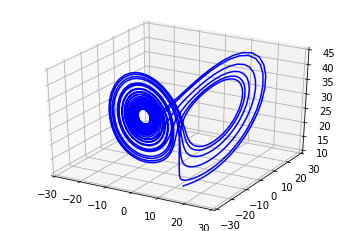

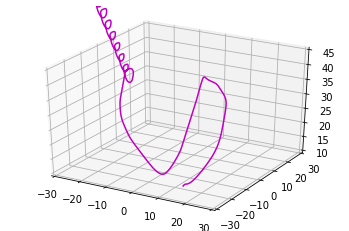

Iteration 0541 | Total Loss 45737.019531
Iteration 0542 | Total Loss 1417.176880
Iteration 0543 | Total Loss 40519.593750
Iteration 0544 | Total Loss 36756.750000
Iteration 0545 | Total Loss 38560.066406


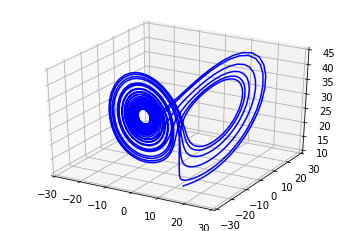

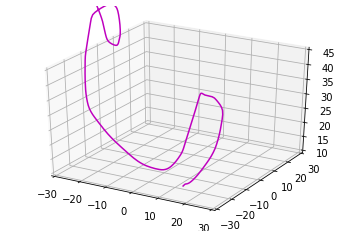

Iteration 0546 | Total Loss 1109.324463
Iteration 0547 | Total Loss 37669.082031
Iteration 0548 | Total Loss 88.915154
Iteration 0549 | Total Loss 51067.605469
Iteration 0550 | Total Loss 34930.113281


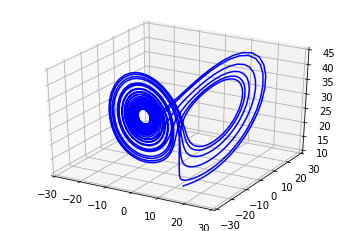

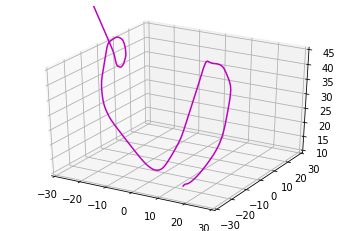

Iteration 0551 | Total Loss 44737.585938
Iteration 0552 | Total Loss 41133.343750
Iteration 0553 | Total Loss 40706.078125
Iteration 0554 | Total Loss 690177.625000
Iteration 0555 | Total Loss 39530.203125


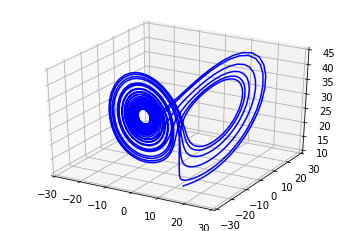

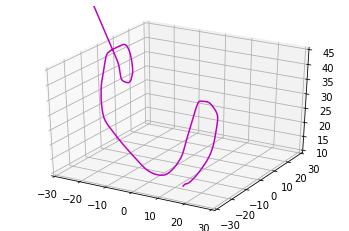

Iteration 0556 | Total Loss 3316.951904
Iteration 0557 | Total Loss 38682.664062
Iteration 0558 | Total Loss 2025.636841
Iteration 0559 | Total Loss 39684.757812
Iteration 0560 | Total Loss 596.260132


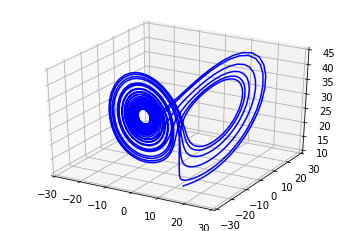

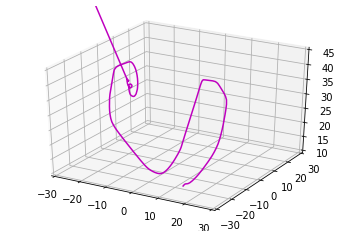

Iteration 0561 | Total Loss 45772.718750
Iteration 0562 | Total Loss 557.965759
Iteration 0563 | Total Loss 46948.894531
Iteration 0564 | Total Loss 775.733643
Iteration 0565 | Total Loss 43429.039062


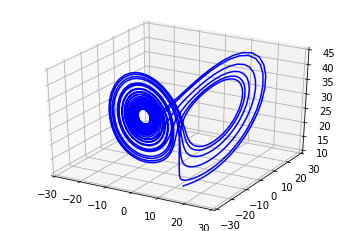

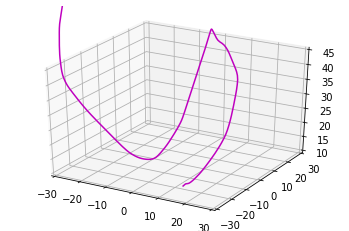

Iteration 0566 | Total Loss 485.937164
Iteration 0567 | Total Loss 46446.878906
Iteration 0568 | Total Loss 960.207581
Iteration 0569 | Total Loss 43575.753906
Iteration 0570 | Total Loss 4840.334473


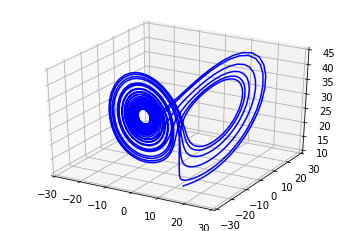

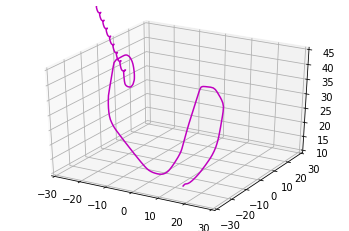

Iteration 0571 | Total Loss 11017.150391
Iteration 0572 | Total Loss 5020.563477
Iteration 0573 | Total Loss 9716.536133
Iteration 0574 | Total Loss 1947.426636
Iteration 0575 | Total Loss 8325.061523


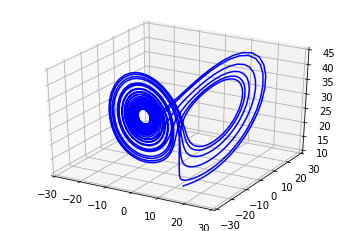

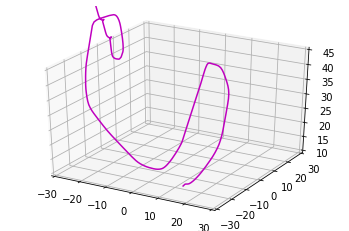

Iteration 0576 | Total Loss 999.543579
Iteration 0577 | Total Loss 6720.094727
Iteration 0578 | Total Loss 228.969620
Iteration 0579 | Total Loss 10934.031250
Iteration 0580 | Total Loss 52.398880


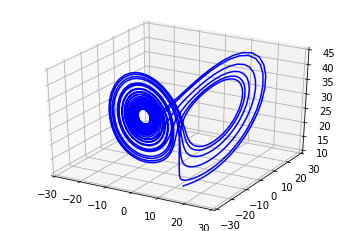

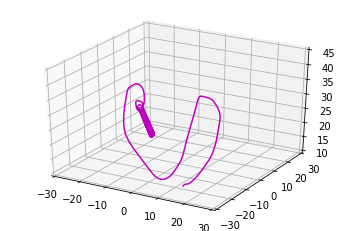

Iteration 0581 | Total Loss 42155.207031
Iteration 0582 | Total Loss 179.495682
Iteration 0583 | Total Loss 37939.761719
Iteration 0584 | Total Loss 466.060089
Iteration 0585 | Total Loss 10792.664062


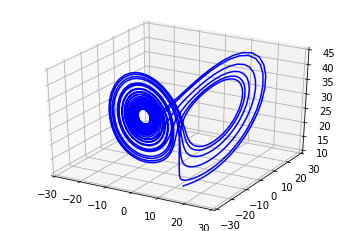

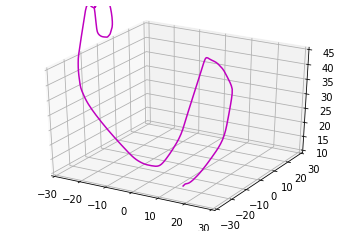

Iteration 0586 | Total Loss 773.052979
Iteration 0587 | Total Loss 5073.974609
Iteration 0588 | Total Loss 62.456936
Iteration 0589 | Total Loss 562625.437500
Iteration 0590 | Total Loss 302.047424


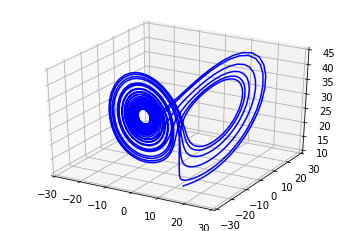

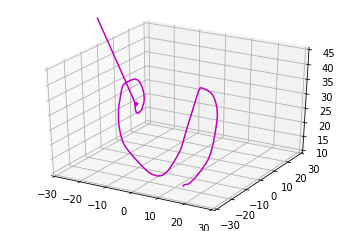

Iteration 0591 | Total Loss 15875.690430
Iteration 0592 | Total Loss 1035.379028
Iteration 0593 | Total Loss 13187.667969
Iteration 0594 | Total Loss 297.603241
Iteration 0595 | Total Loss 15634.145508


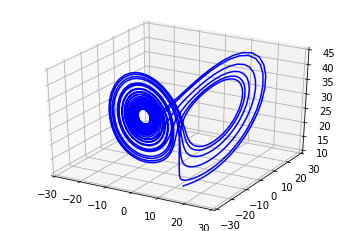

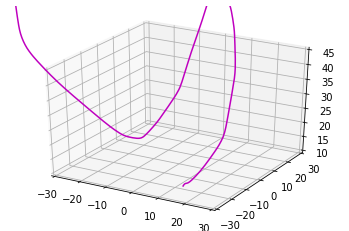

Iteration 0596 | Total Loss 1564.143555
Iteration 0597 | Total Loss 15702.165039
Iteration 0598 | Total Loss 372.094299
Iteration 0599 | Total Loss 7157.120117
Iteration 0600 | Total Loss 73.714966


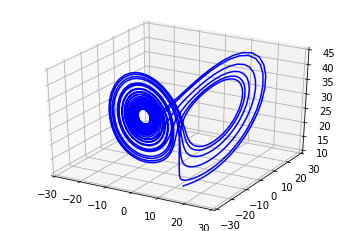

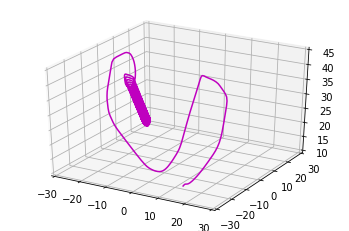

Iteration 0601 | Total Loss 19021.197266
Iteration 0602 | Total Loss 68.454712
Iteration 0603 | Total Loss 1932.297852
Iteration 0604 | Total Loss 184.486664
Iteration 0605 | Total Loss 797570.312500


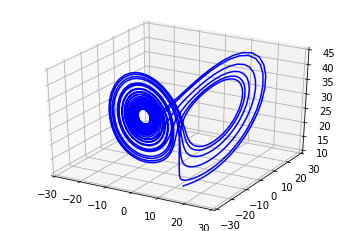

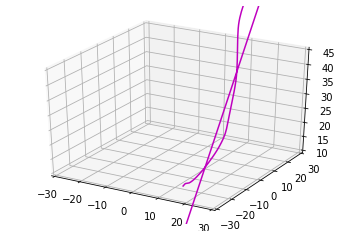

Iteration 0606 | Total Loss 299.394592
Iteration 0607 | Total Loss 3640.500244
Iteration 0608 | Total Loss 199.292725
Iteration 0609 | Total Loss 6137.068848
Iteration 0610 | Total Loss 107.928215


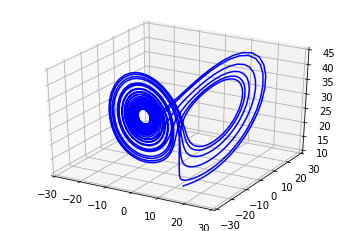

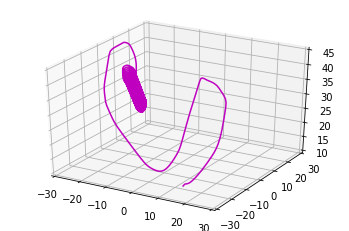

Iteration 0611 | Total Loss 4194.676270
Iteration 0612 | Total Loss 101.187500
Iteration 0613 | Total Loss 1191.768921
Iteration 0614 | Total Loss 134.840393
Iteration 0615 | Total Loss 1760.229614


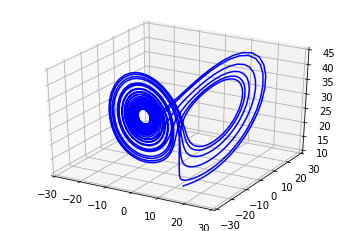

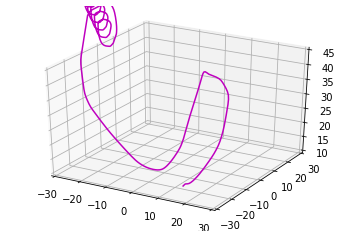

Iteration 0616 | Total Loss 289.054535
Iteration 0617 | Total Loss 2962.500977
Iteration 0618 | Total Loss 336.370575
Iteration 0619 | Total Loss 1711.647949
Iteration 0620 | Total Loss 1300.521362


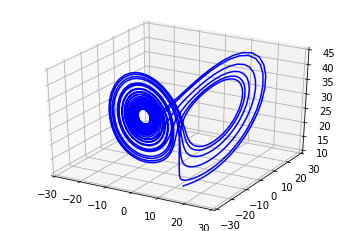

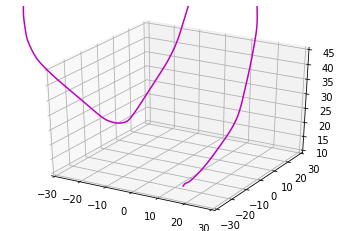

Iteration 0621 | Total Loss 647.921143
Iteration 0622 | Total Loss 650861.812500
Iteration 0623 | Total Loss 59.851048
Iteration 0624 | Total Loss 484977.750000
Iteration 0625 | Total Loss 468.375824


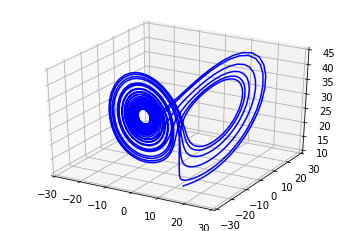

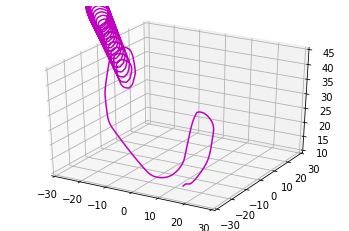

Iteration 0626 | Total Loss 294.442047
Iteration 0627 | Total Loss 3900.302002
Iteration 0628 | Total Loss 157.520370
Iteration 0629 | Total Loss 2531.656982
Iteration 0630 | Total Loss 146.865921


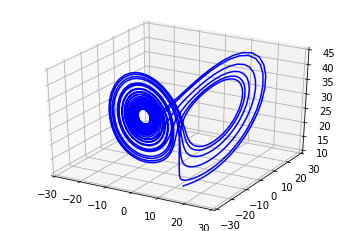

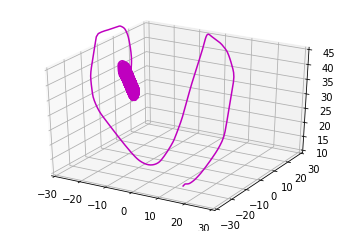

Iteration 0631 | Total Loss 2662.111084
Iteration 0632 | Total Loss 236.270493
Iteration 0633 | Total Loss 2458.541016
Iteration 0634 | Total Loss 97.756065
Iteration 0635 | Total Loss 2398.791748


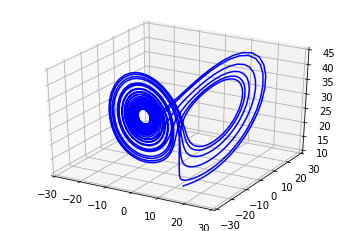

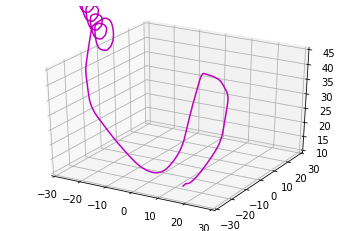

Iteration 0636 | Total Loss 77.317825
Iteration 0637 | Total Loss 984.200745
Iteration 0638 | Total Loss 125.051018
Iteration 0639 | Total Loss 1283.497559
Iteration 0640 | Total Loss 172.341553


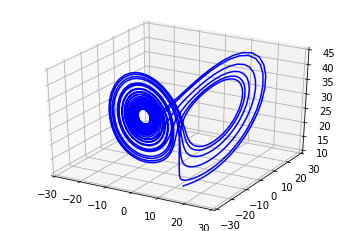

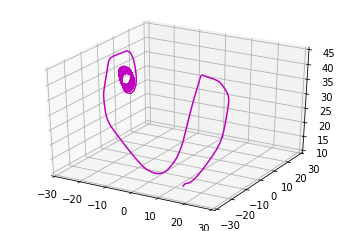

Iteration 0641 | Total Loss 1348.430664
Iteration 0642 | Total Loss 224.532547
Iteration 0643 | Total Loss 1346.503052
Iteration 0644 | Total Loss 125.132988
Iteration 0645 | Total Loss 1561.126709


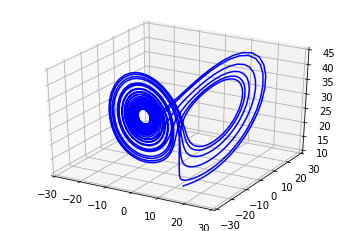

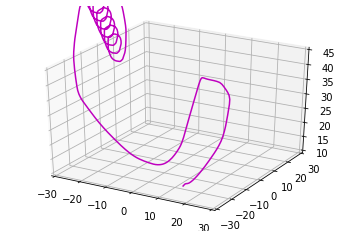

Iteration 0646 | Total Loss 59.023655
Iteration 0647 | Total Loss 3621.944092
Iteration 0648 | Total Loss 62.454662
Iteration 0649 | Total Loss 2569.673340
Iteration 0650 | Total Loss 96.374939


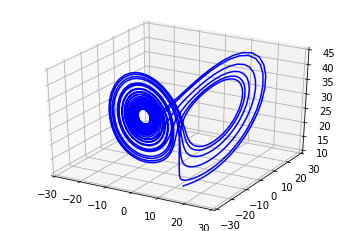

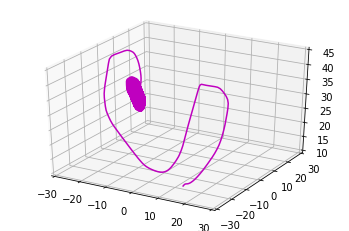

Iteration 0651 | Total Loss 2150.765625
Iteration 0652 | Total Loss 81.405434
Iteration 0653 | Total Loss 2164.529785
Iteration 0654 | Total Loss 69.938759
Iteration 0655 | Total Loss 2755.603271


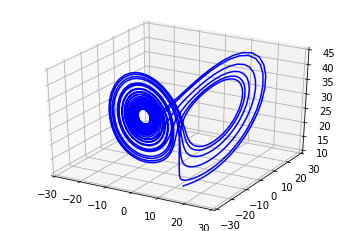

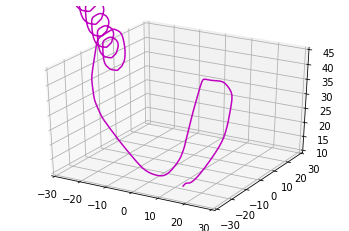

Iteration 0656 | Total Loss 118.463051
Iteration 0657 | Total Loss 2968.076904
Iteration 0658 | Total Loss 135.310028
Iteration 0659 | Total Loss 3398.829346
Iteration 0660 | Total Loss 187.392624


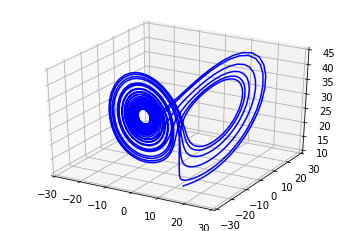

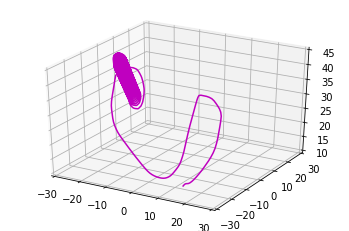

Iteration 0661 | Total Loss 2216.544678
Iteration 0662 | Total Loss 142.136185
Iteration 0663 | Total Loss 3424.104736
Iteration 0664 | Total Loss 52.854774
Iteration 0665 | Total Loss 3049.894287


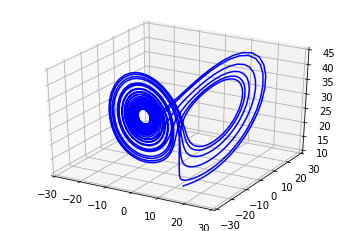

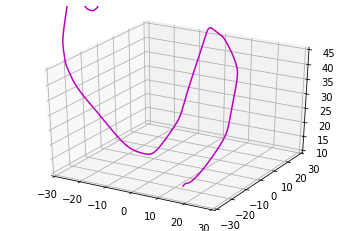

Iteration 0666 | Total Loss 66.300522
Iteration 0667 | Total Loss 3129.165283
Iteration 0668 | Total Loss 147.364014
Iteration 0669 | Total Loss 3067.837402
Iteration 0670 | Total Loss 69.184883


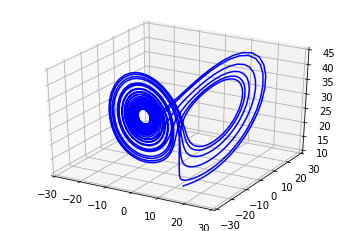

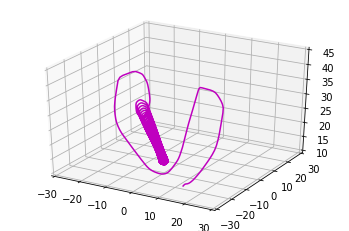

Iteration 0671 | Total Loss 7566.255371
Iteration 0672 | Total Loss 106.345314
Iteration 0673 | Total Loss 4121.381836
Iteration 0674 | Total Loss 55.140285
Iteration 0675 | Total Loss 527857.937500


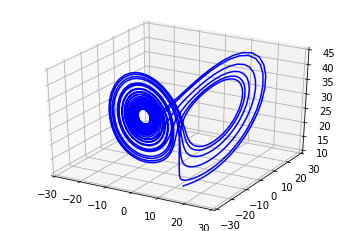

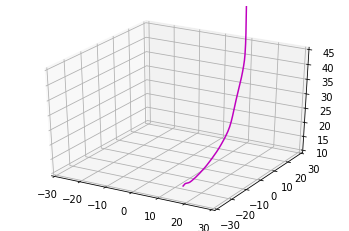

Iteration 0676 | Total Loss 167.258942
Iteration 0677 | Total Loss 1983.490356
Iteration 0678 | Total Loss 159.436234
Iteration 0679 | Total Loss 300786.937500
Iteration 0680 | Total Loss 88.859169


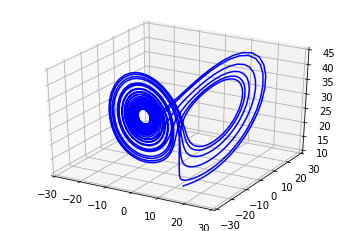

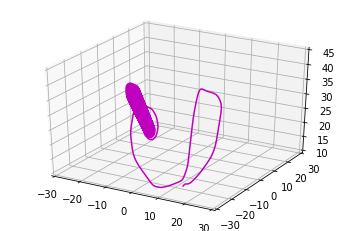

Iteration 0681 | Total Loss 2588.447021
Iteration 0682 | Total Loss 104.057999
Iteration 0683 | Total Loss 5473.195312
Iteration 0684 | Total Loss 55.352459
Iteration 0685 | Total Loss 1834.052856


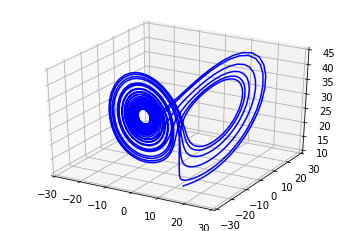

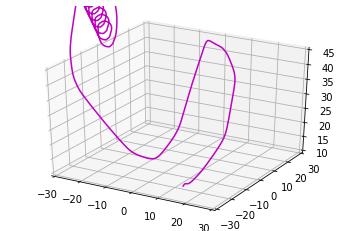

Iteration 0686 | Total Loss 81.139648
Iteration 0687 | Total Loss 2471.407227
Iteration 0688 | Total Loss 74.660042
Iteration 0689 | Total Loss 968.650818
Iteration 0690 | Total Loss 63.985104


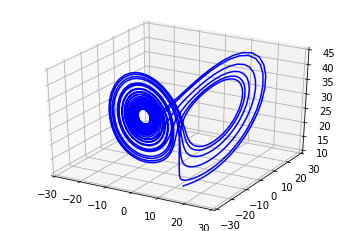

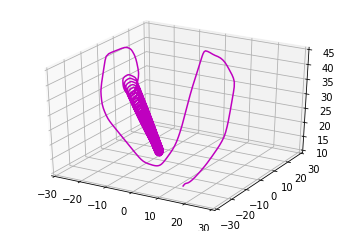

Iteration 0691 | Total Loss 1863.426392
Iteration 0692 | Total Loss 186.336182
Iteration 0693 | Total Loss 2923.873779
Iteration 0694 | Total Loss 112.813972
Iteration 0695 | Total Loss 3393.347656


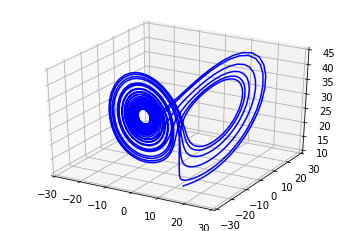

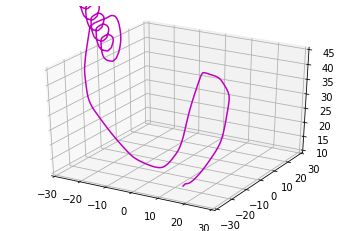

Iteration 0696 | Total Loss 65.072983
Iteration 0697 | Total Loss 1265.182495
Iteration 0698 | Total Loss 89.813660
Iteration 0699 | Total Loss 3039.975098
Iteration 0700 | Total Loss 131.522629


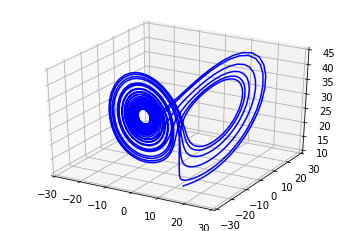

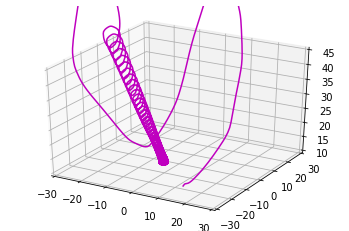

Iteration 0701 | Total Loss 1494.229492
Iteration 0702 | Total Loss 116.895699
Iteration 0703 | Total Loss 514.789856
Iteration 0704 | Total Loss 124.376335
Iteration 0705 | Total Loss 547.161377


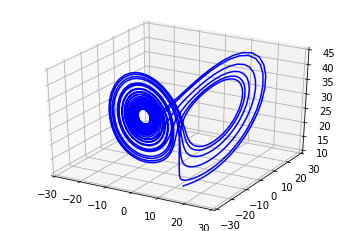

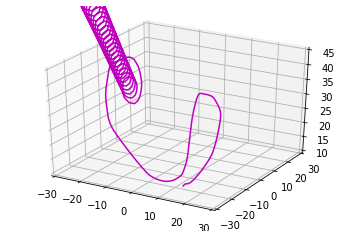

Iteration 0706 | Total Loss 75.150955
Iteration 0707 | Total Loss 1859.646973
Iteration 0708 | Total Loss 74.746086
Iteration 0709 | Total Loss 1390.861694
Iteration 0710 | Total Loss 97.243492


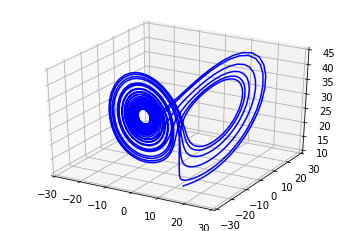

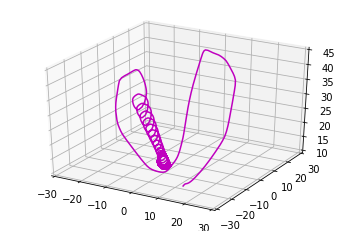

Iteration 0711 | Total Loss 2950.416748
Iteration 0712 | Total Loss 76.739265
Iteration 0713 | Total Loss 771.558167
Iteration 0714 | Total Loss 84.566582
Iteration 0715 | Total Loss 1239.576782


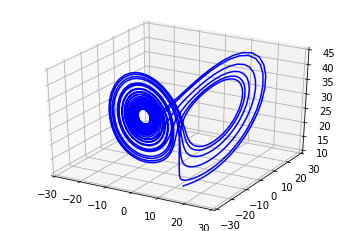

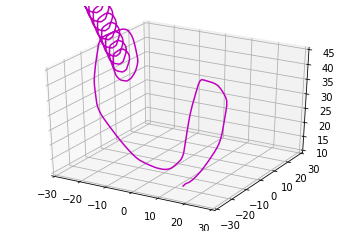

Iteration 0716 | Total Loss 166.709946
Iteration 0717 | Total Loss 259.738770
Iteration 0718 | Total Loss 125.194366
Iteration 0719 | Total Loss 121.374535
Iteration 0720 | Total Loss 106.402000


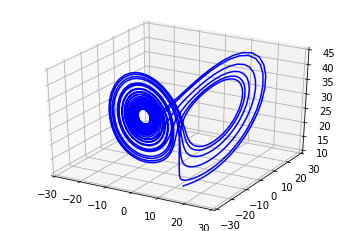

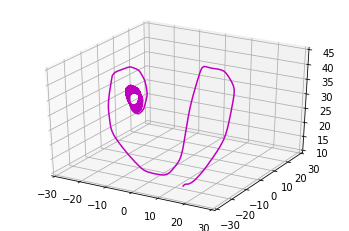

Iteration 0721 | Total Loss 118.880798
Iteration 0722 | Total Loss 102.687233
Iteration 0723 | Total Loss 104.140709
Iteration 0724 | Total Loss 77.592773
Iteration 0725 | Total Loss 198.790665


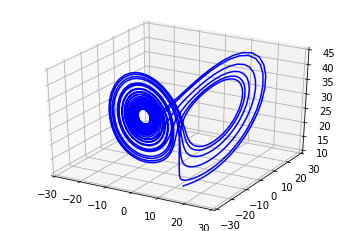

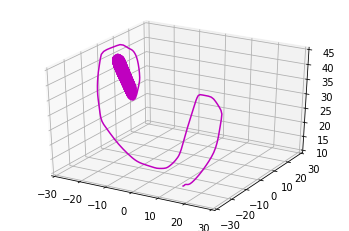

Iteration 0726 | Total Loss 66.268211
Iteration 0727 | Total Loss 2187.958984
Iteration 0728 | Total Loss 115.994888
Iteration 0729 | Total Loss 48490.718750
Iteration 0730 | Total Loss 101.711617


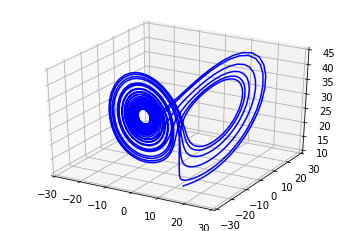

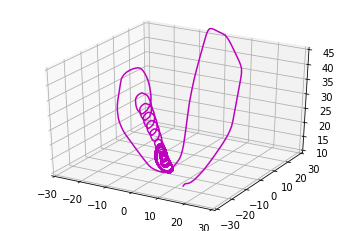

Iteration 0731 | Total Loss 1037.604614
Iteration 0732 | Total Loss 75.047707
Iteration 0733 | Total Loss 659.989502
Iteration 0734 | Total Loss 71.148468
Iteration 0735 | Total Loss 847.495728


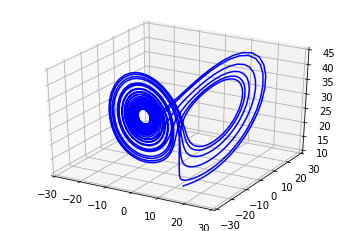

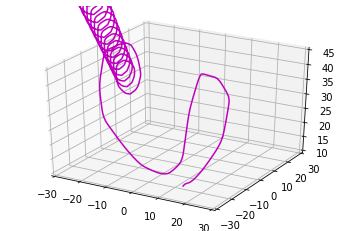

Iteration 0736 | Total Loss 61.416100
Iteration 0737 | Total Loss 406.839630
Iteration 0738 | Total Loss 66.006691
Iteration 0739 | Total Loss 636.162903
Iteration 0740 | Total Loss 113.413925


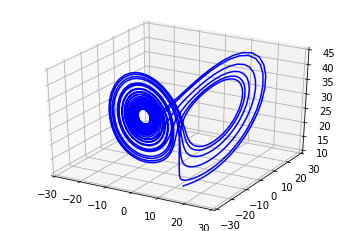

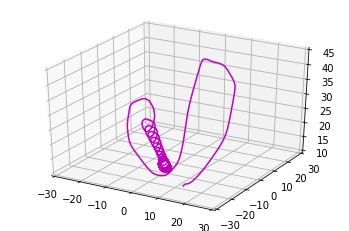

Iteration 0741 | Total Loss 20374.123047
Iteration 0742 | Total Loss 99.355705
Iteration 0743 | Total Loss 4250.375488
Iteration 0744 | Total Loss 311.639435
Iteration 0745 | Total Loss 2852.812256


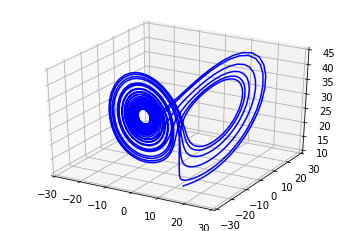

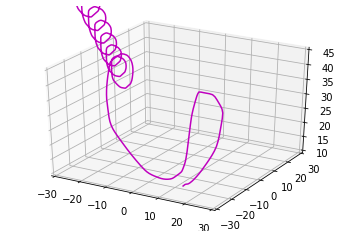

Iteration 0746 | Total Loss 78.593231
Iteration 0747 | Total Loss 2495.458740
Iteration 0748 | Total Loss 148.548004
Iteration 0749 | Total Loss 1777.644775
Iteration 0750 | Total Loss 85.877350


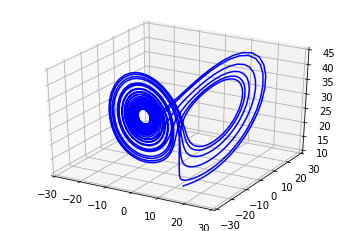

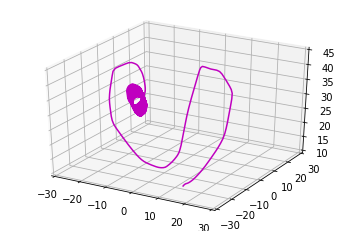

Iteration 0751 | Total Loss 2128.107422
Iteration 0752 | Total Loss 63.417198
Iteration 0753 | Total Loss 3067.562988
Iteration 0754 | Total Loss 61.303894
Iteration 0755 | Total Loss 2086.701904


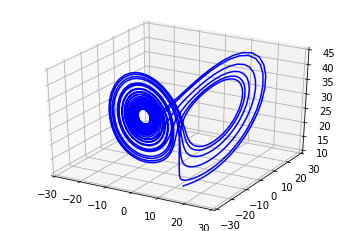

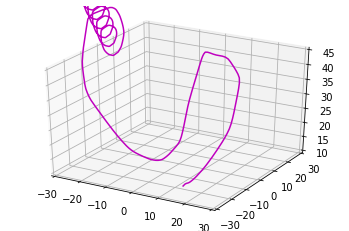

Iteration 0756 | Total Loss 110.753311
Iteration 0757 | Total Loss 228.429749
Iteration 0758 | Total Loss 96.268127
Iteration 0759 | Total Loss 966.734009
Iteration 0760 | Total Loss 110.259514


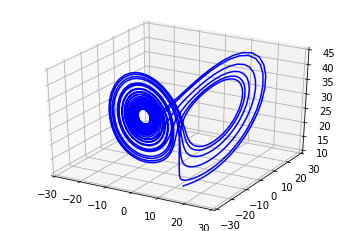

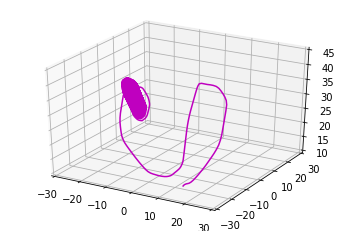

Iteration 0761 | Total Loss 736.262695
Iteration 0762 | Total Loss 75.558716
Iteration 0763 | Total Loss 3304.575684
Iteration 0764 | Total Loss 80.702179
Iteration 0765 | Total Loss 4181.090820


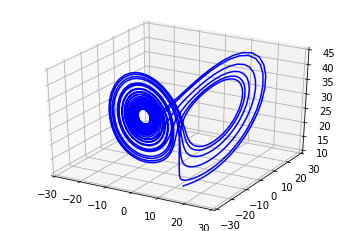

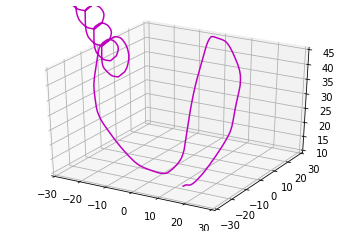

Iteration 0766 | Total Loss 93.105560
Iteration 0767 | Total Loss 3936.704102
Iteration 0768 | Total Loss 84.915955
Iteration 0769 | Total Loss 575768.250000
Iteration 0770 | Total Loss 71.059959


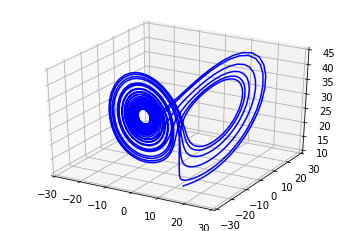

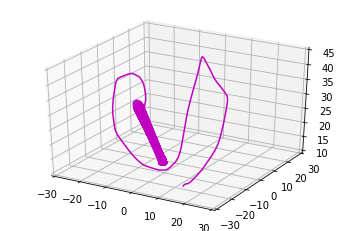

Iteration 0771 | Total Loss 564.694763
Iteration 0772 | Total Loss 64.725044
Iteration 0773 | Total Loss 950.352600
Iteration 0774 | Total Loss 66.883949
Iteration 0775 | Total Loss 1403.033325


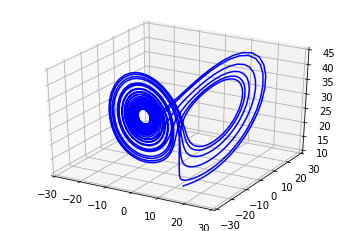

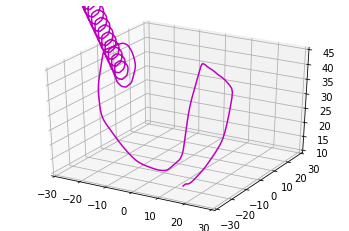

Iteration 0776 | Total Loss 58.622593
Iteration 0777 | Total Loss 1029.510010
Iteration 0778 | Total Loss 93.023247
Iteration 0779 | Total Loss 1746.907715
Iteration 0780 | Total Loss 79.391304


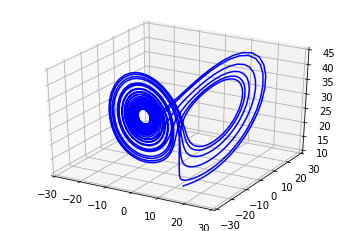

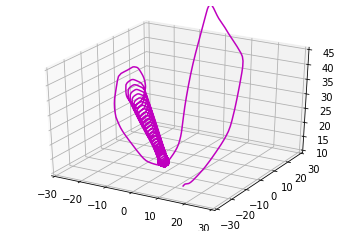

Iteration 0781 | Total Loss 507.036987
Iteration 0782 | Total Loss 76.546638
Iteration 0783 | Total Loss 240.104202
Iteration 0784 | Total Loss 69.560898
Iteration 0785 | Total Loss 130.054657


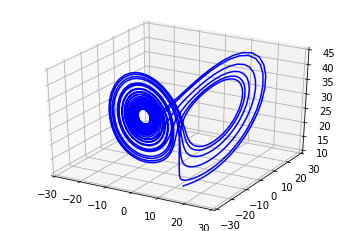

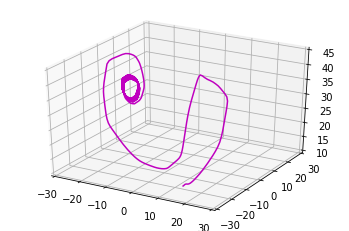

Iteration 0786 | Total Loss 76.991211
Iteration 0787 | Total Loss 327.036285
Iteration 0788 | Total Loss 77.573097
Iteration 0789 | Total Loss 231.259399
Iteration 0790 | Total Loss 88.829697


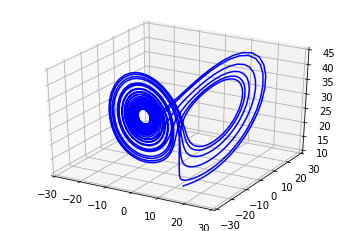

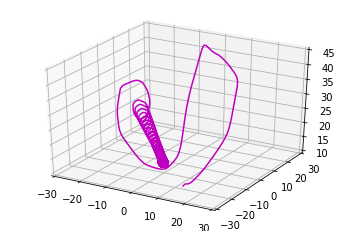

Iteration 0791 | Total Loss 859.846497
Iteration 0792 | Total Loss 79.922440
Iteration 0793 | Total Loss 473.358795
Iteration 0794 | Total Loss 71.008156
Iteration 0795 | Total Loss 240.108215


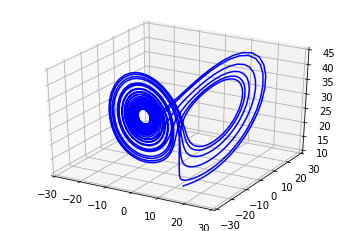

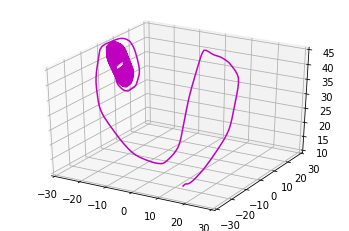

Iteration 0796 | Total Loss 73.795059
Iteration 0797 | Total Loss 463.557037
Iteration 0798 | Total Loss 91.955750
Iteration 0799 | Total Loss 1882.020508
Iteration 0800 | Total Loss 77.687820


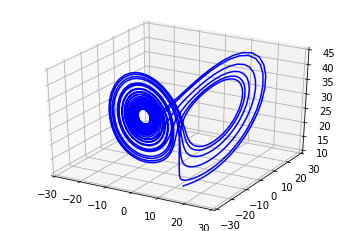

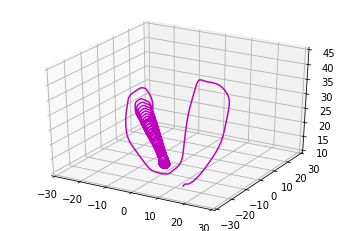

Iteration 0801 | Total Loss 234.550735
Iteration 0802 | Total Loss 113.796158
Iteration 0803 | Total Loss 627.101501
Iteration 0804 | Total Loss 88.280167
Iteration 0805 | Total Loss 364.562012


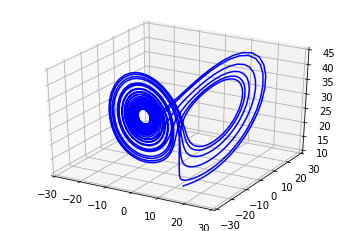

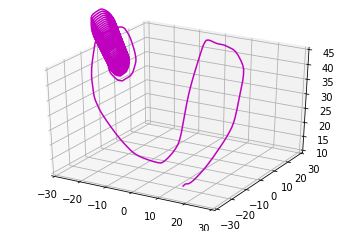

Iteration 0806 | Total Loss 90.837593
Iteration 0807 | Total Loss 228.263870
Iteration 0808 | Total Loss 98.717239
Iteration 0809 | Total Loss 790.348267
Iteration 0810 | Total Loss 97.070824


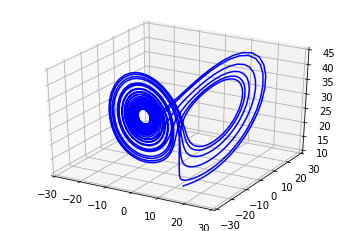

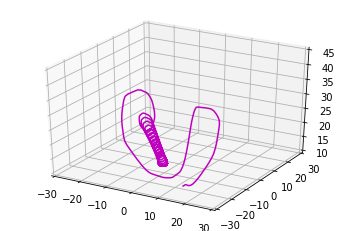

Iteration 0811 | Total Loss 652.639099
Iteration 0812 | Total Loss 97.974899
Iteration 0813 | Total Loss 852.466858
Iteration 0814 | Total Loss 94.651939
Iteration 0815 | Total Loss 1936.776123


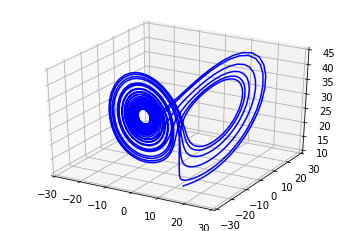

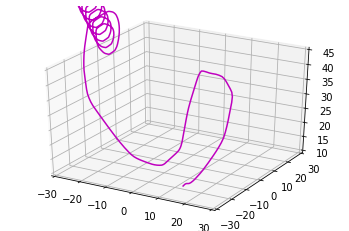

Iteration 0816 | Total Loss 87.466858
Iteration 0817 | Total Loss 130.218994
Iteration 0818 | Total Loss 107.890167
Iteration 0819 | Total Loss 81.134674
Iteration 0820 | Total Loss 92.669472


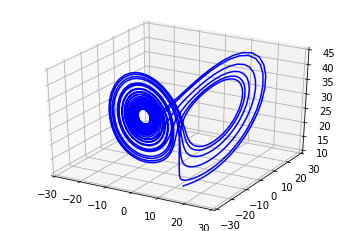

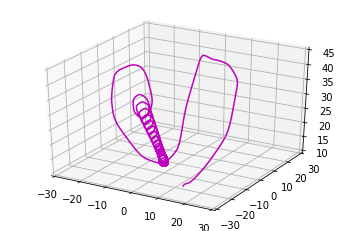

Iteration 0821 | Total Loss 61.600746
Iteration 0822 | Total Loss 91.572845
Iteration 0823 | Total Loss 188.978958
Iteration 0824 | Total Loss 86.044960
Iteration 0825 | Total Loss 1593.270630


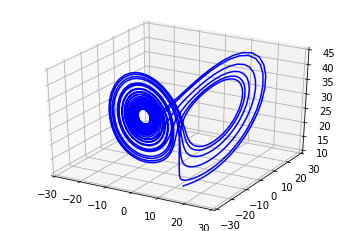

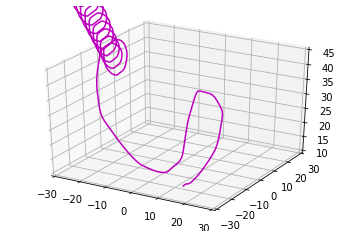

Iteration 0826 | Total Loss 125.281754
Iteration 0827 | Total Loss 5006.377441
Iteration 0828 | Total Loss 899.010315
Iteration 0829 | Total Loss 34046.230469
Iteration 0830 | Total Loss 86043.000000


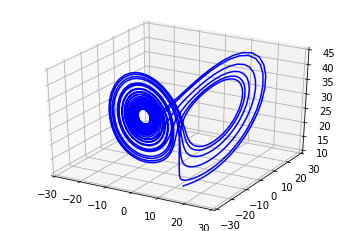

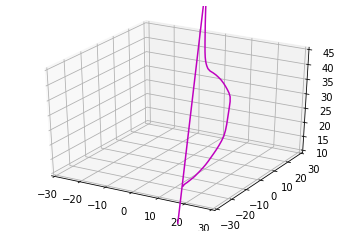

Iteration 0831 | Total Loss 516.234253
Iteration 0832 | Total Loss 104.316055
Iteration 0833 | Total Loss 1185.288940
Iteration 0834 | Total Loss 74.370827
Iteration 0835 | Total Loss 116.712288


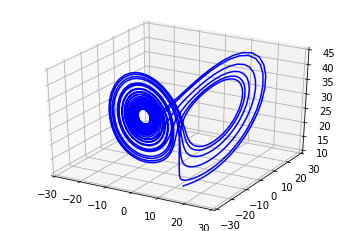

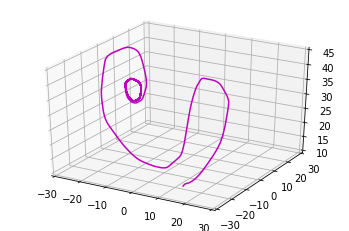

Iteration 0836 | Total Loss 76.650848
Iteration 0837 | Total Loss 123.444519
Iteration 0838 | Total Loss 99.173073
Iteration 0839 | Total Loss 831.520813
Iteration 0840 | Total Loss 81.740166


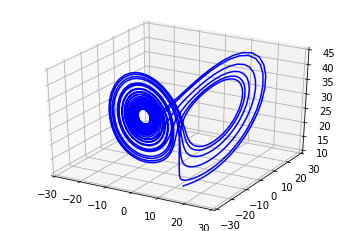

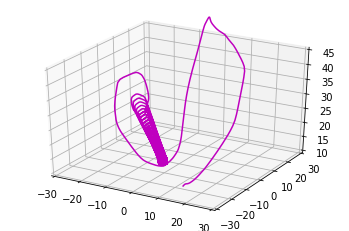

Iteration 0841 | Total Loss 397.352417
Iteration 0842 | Total Loss 76.837242
Iteration 0843 | Total Loss 163.348923
Iteration 0844 | Total Loss 97.743698
Iteration 0845 | Total Loss 1022.881470


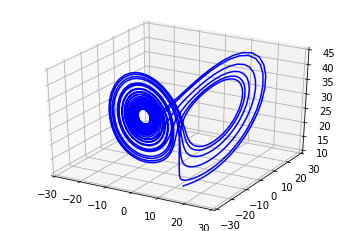

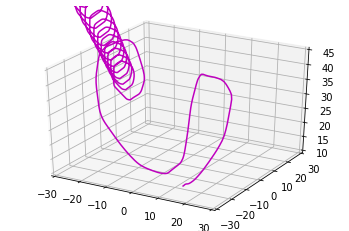

Iteration 0846 | Total Loss 82.906517
Iteration 0847 | Total Loss 1265.364624
Iteration 0848 | Total Loss 81.731934
Iteration 0849 | Total Loss 1201.809204
Iteration 0850 | Total Loss 67.173973


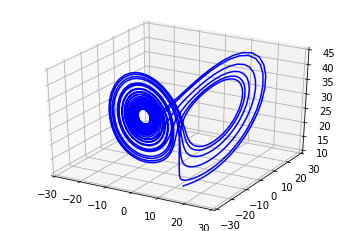

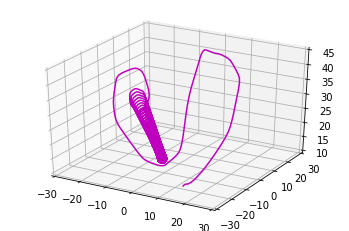

Iteration 0851 | Total Loss 709.792664
Iteration 0852 | Total Loss 62.978340
Iteration 0853 | Total Loss 287.260529
Iteration 0854 | Total Loss 118.034050
Iteration 0855 | Total Loss 260.633881


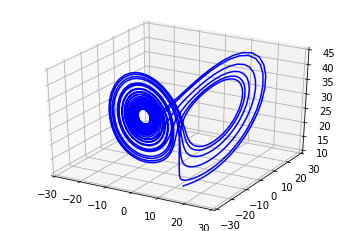

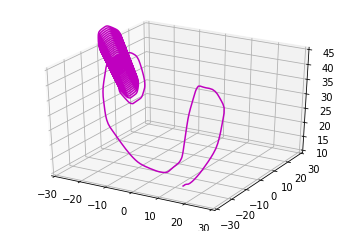

Iteration 0856 | Total Loss 81.983116
Iteration 0857 | Total Loss 203.100433
Iteration 0858 | Total Loss 79.558548
Iteration 0859 | Total Loss 118.163055
Iteration 0860 | Total Loss 100.738907


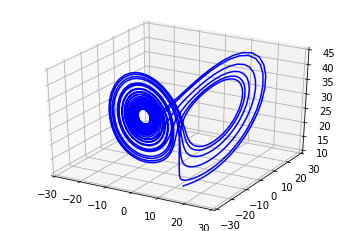

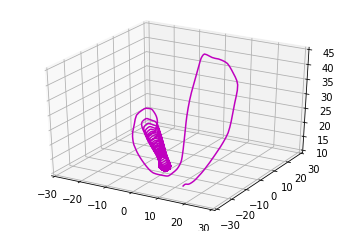

Iteration 0861 | Total Loss 2176.663574
Iteration 0862 | Total Loss 67.917923
Iteration 0863 | Total Loss 112.868271
Iteration 0864 | Total Loss 105.917847
Iteration 0865 | Total Loss 2107.350098


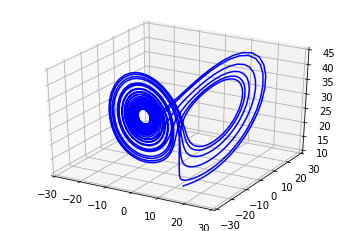

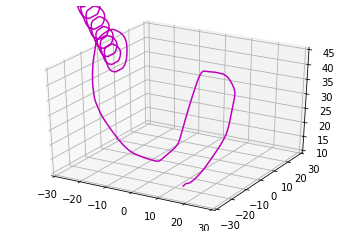

Iteration 0866 | Total Loss 103.579063
Iteration 0867 | Total Loss 72.862068
Iteration 0868 | Total Loss 99.511314
Iteration 0869 | Total Loss 69.854286
Iteration 0870 | Total Loss 101.705482


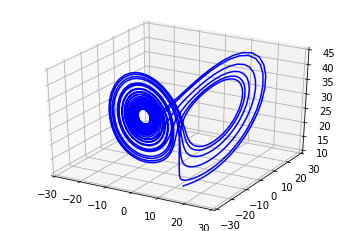

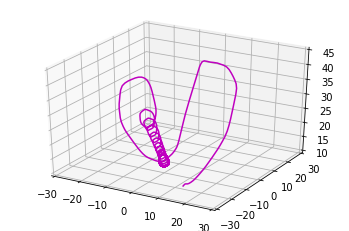

Iteration 0871 | Total Loss 569.439148
Iteration 0872 | Total Loss 94.414284
Iteration 0873 | Total Loss 86.252861
Iteration 0874 | Total Loss 76.437019
Iteration 0875 | Total Loss 88.348564


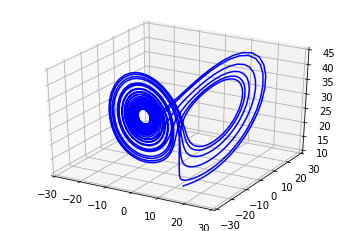

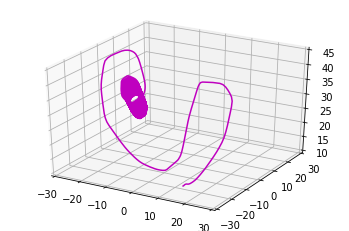

Iteration 0876 | Total Loss 73.814003
Iteration 0877 | Total Loss 55.885410
Iteration 0878 | Total Loss 87.473465
Iteration 0879 | Total Loss 58.998543
Iteration 0880 | Total Loss 103.143669


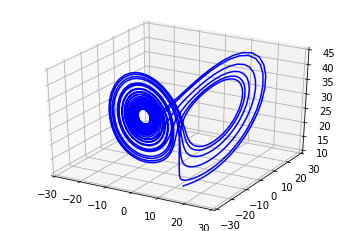

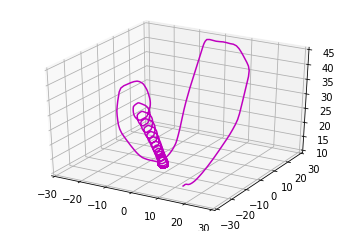

Iteration 0881 | Total Loss 601.829224
Iteration 0882 | Total Loss 106.026939
Iteration 0883 | Total Loss 2234.097656
Iteration 0884 | Total Loss 79.079666
Iteration 0885 | Total Loss 610.393066


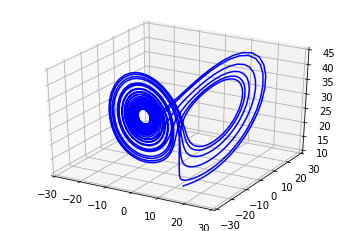

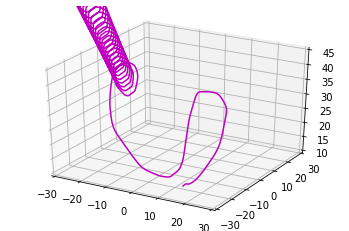

Iteration 0886 | Total Loss 76.609047
Iteration 0887 | Total Loss 145.255722
Iteration 0888 | Total Loss 77.765617
Iteration 0889 | Total Loss 99.537918
Iteration 0890 | Total Loss 99.806770


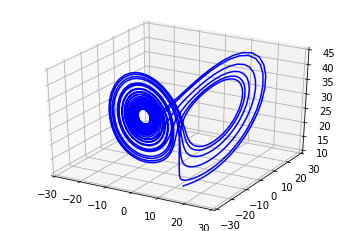

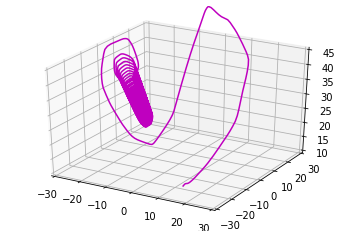

Iteration 0891 | Total Loss 110.224388
Iteration 0892 | Total Loss 102.139091
Iteration 0893 | Total Loss 92.622955
Iteration 0894 | Total Loss 77.935471
Iteration 0895 | Total Loss 77.943069


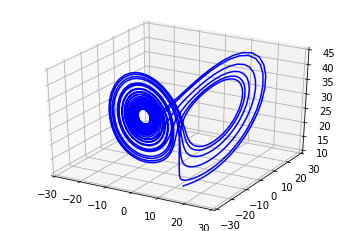

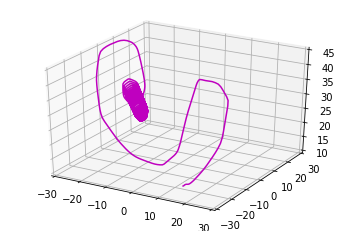

Iteration 0896 | Total Loss 94.163017
Iteration 0897 | Total Loss 1153.276123
Iteration 0898 | Total Loss 84.536118
Iteration 0899 | Total Loss 2249.512939
Iteration 0900 | Total Loss 89.392105


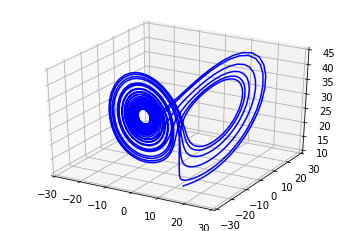

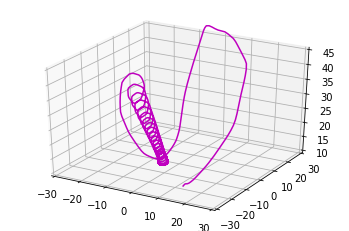

Iteration 0901 | Total Loss 1039.353027
Iteration 0902 | Total Loss 72.858002
Iteration 0903 | Total Loss 420.342682
Iteration 0904 | Total Loss 71.492798
Iteration 0905 | Total Loss 180.007996


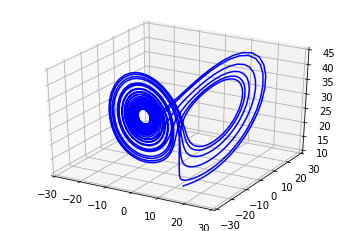

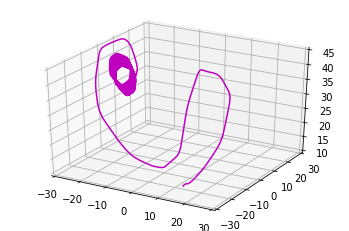

Iteration 0906 | Total Loss 74.111702
Iteration 0907 | Total Loss 171.963577
Iteration 0908 | Total Loss 75.110962
Iteration 0909 | Total Loss 93.743416
Iteration 0910 | Total Loss 56.928165


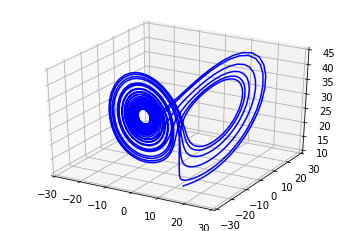

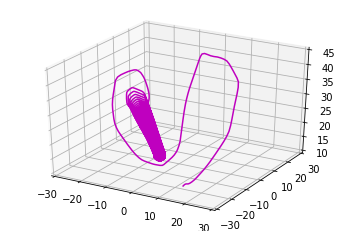

Iteration 0911 | Total Loss 104.955330
Iteration 0912 | Total Loss 81.481590
Iteration 0913 | Total Loss 90.537102
Iteration 0914 | Total Loss 88.812492
Iteration 0915 | Total Loss 125.417999


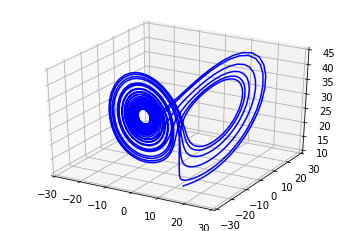

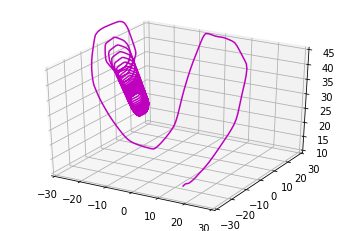

Iteration 0916 | Total Loss 86.815887
Iteration 0917 | Total Loss 610.924622
Iteration 0918 | Total Loss 112.468628
Iteration 0919 | Total Loss 108.344376
Iteration 0920 | Total Loss 85.408836


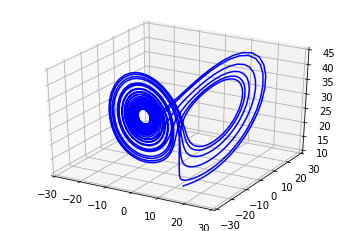

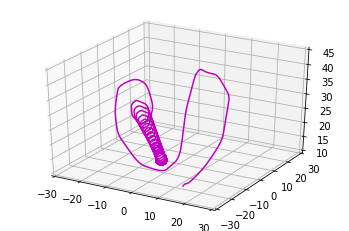

Iteration 0921 | Total Loss 76.808556
Iteration 0922 | Total Loss 81.963234
Iteration 0923 | Total Loss 83.878014
Iteration 0924 | Total Loss 94.003845
Iteration 0925 | Total Loss 195.503403


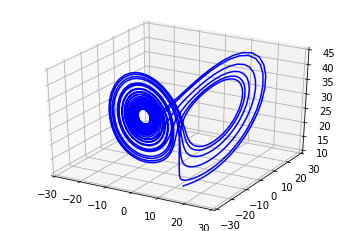

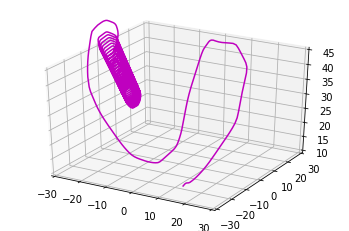

Iteration 0926 | Total Loss 159.055038
Iteration 0927 | Total Loss 546.514954
Iteration 0928 | Total Loss 57.905090
Iteration 0929 | Total Loss 145.991714
Iteration 0930 | Total Loss 69.913147


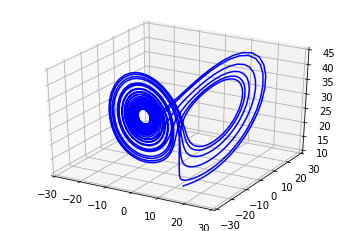

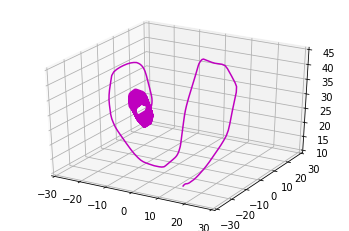

Iteration 0931 | Total Loss 100.808075
Iteration 0932 | Total Loss 76.165741
Iteration 0933 | Total Loss 132.557358
Iteration 0934 | Total Loss 84.239655
Iteration 0935 | Total Loss 143.110764


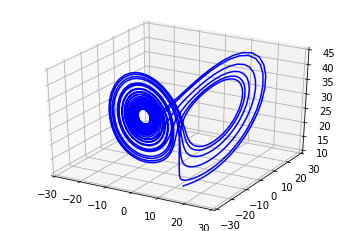

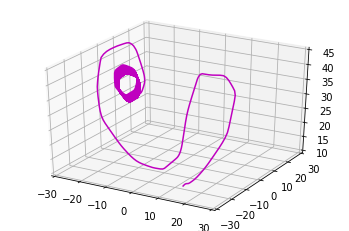

Iteration 0936 | Total Loss 75.302689
Iteration 0937 | Total Loss 110.425774
Iteration 0938 | Total Loss 64.045326
Iteration 0939 | Total Loss 57.575470
Iteration 0940 | Total Loss 75.584663


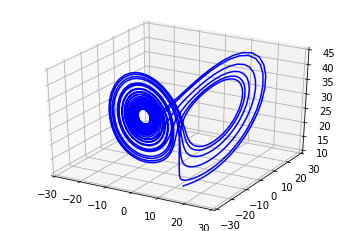

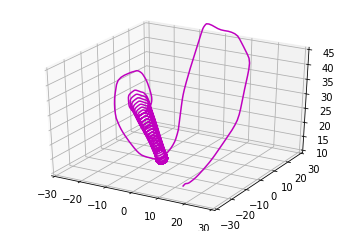

Iteration 0941 | Total Loss 55.874004
Iteration 0942 | Total Loss 102.923332
Iteration 0943 | Total Loss 67.403389
Iteration 0944 | Total Loss 93.894218
Iteration 0945 | Total Loss 92.107841


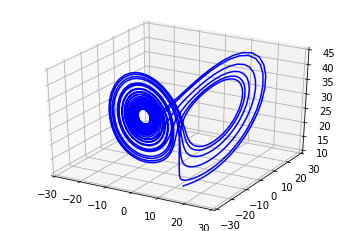

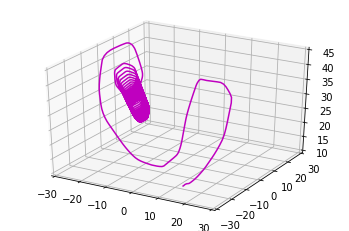

Iteration 0946 | Total Loss 88.810684
Iteration 0947 | Total Loss 171.435104
Iteration 0948 | Total Loss 66.278046
Iteration 0949 | Total Loss 71.433113
Iteration 0950 | Total Loss 99.650528


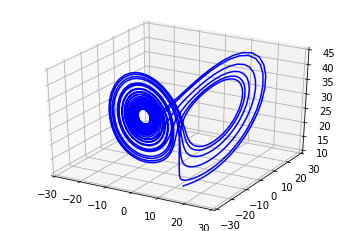

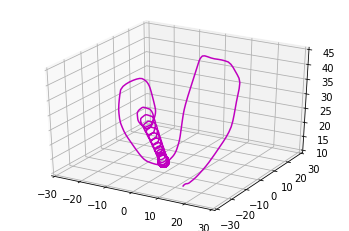

Iteration 0951 | Total Loss 200.150711
Iteration 0952 | Total Loss 82.222038
Iteration 0953 | Total Loss 236.914368
Iteration 0954 | Total Loss 113.996803
Iteration 0955 | Total Loss 464.648865


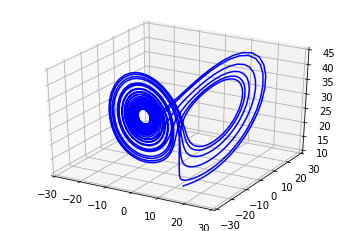

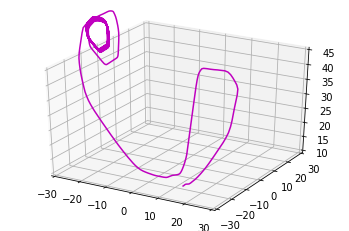

Iteration 0956 | Total Loss 68.599213
Iteration 0957 | Total Loss 79.995827
Iteration 0958 | Total Loss 57.393562
Iteration 0959 | Total Loss 88.995323
Iteration 0960 | Total Loss 68.976997


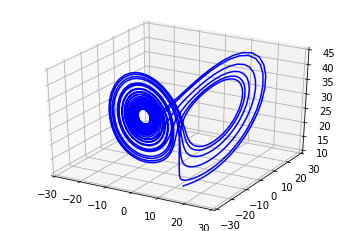

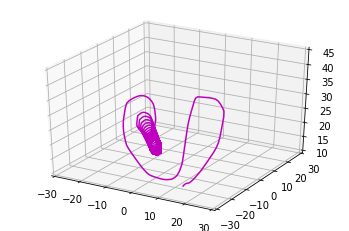

Iteration 0961 | Total Loss 88.465103
Iteration 0962 | Total Loss 82.920860
Iteration 0963 | Total Loss 68.105263
Iteration 0964 | Total Loss 85.726662
Iteration 0965 | Total Loss 85.734848


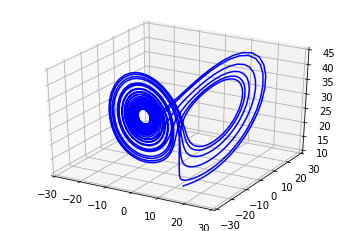

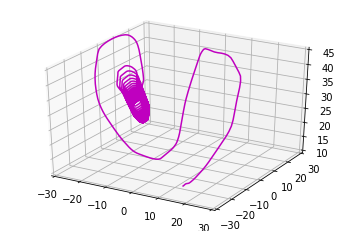

Iteration 0966 | Total Loss 77.977982
Iteration 0967 | Total Loss 142.194321
Iteration 0968 | Total Loss 94.306854
Iteration 0969 | Total Loss 161.743851
Iteration 0970 | Total Loss 99.073883


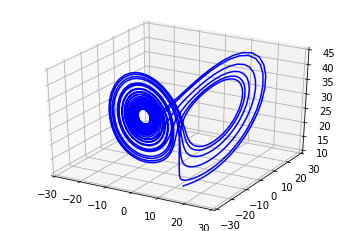

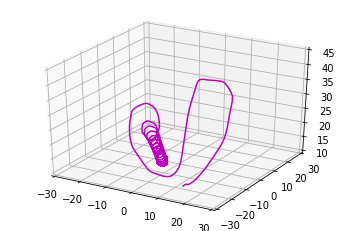

Iteration 0971 | Total Loss 109.320778
Iteration 0972 | Total Loss 102.015388
Iteration 0973 | Total Loss 70.904091
Iteration 0974 | Total Loss 79.543663
Iteration 0975 | Total Loss 63.857525


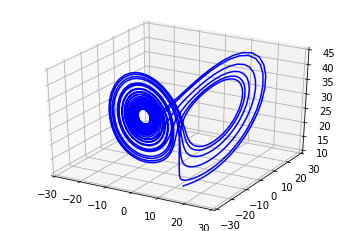

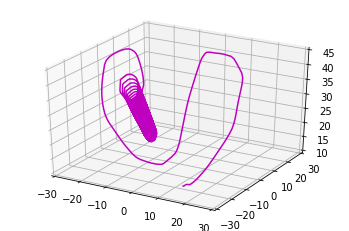

Iteration 0976 | Total Loss 75.806389
Iteration 0977 | Total Loss 62.312248
Iteration 0978 | Total Loss 84.907341
Iteration 0979 | Total Loss 119.078926
Iteration 0980 | Total Loss 90.605064


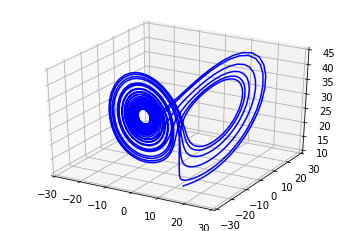

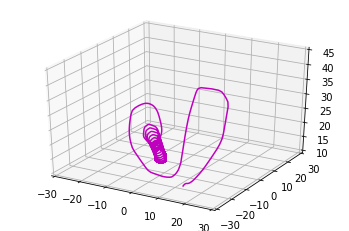

Iteration 0981 | Total Loss 181.651352
Iteration 0982 | Total Loss 90.933426
Iteration 0983 | Total Loss 71.973801
Iteration 0984 | Total Loss 94.014877
Iteration 0985 | Total Loss 60.555298


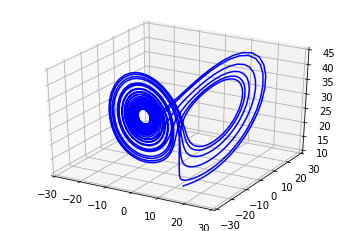

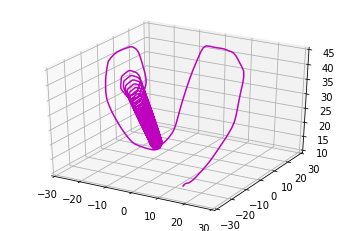

Iteration 0986 | Total Loss 93.312080
Iteration 0987 | Total Loss 98.880104
Iteration 0988 | Total Loss 86.622467
Iteration 0989 | Total Loss 107.210770
Iteration 0990 | Total Loss 92.681236


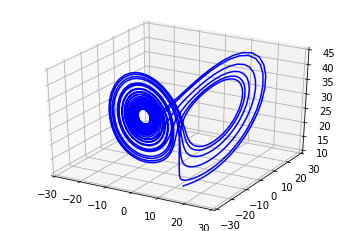

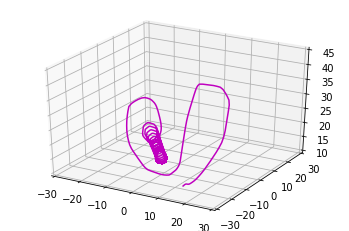

Iteration 0991 | Total Loss 160.627121
Iteration 0992 | Total Loss 98.032310
Iteration 0993 | Total Loss 224.312958
Iteration 0994 | Total Loss 107.087082
Iteration 0995 | Total Loss 684.133911


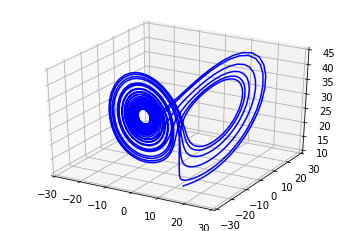

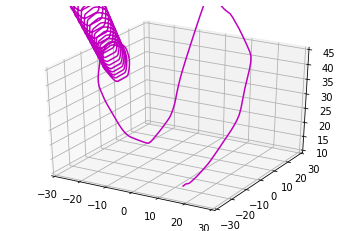

Iteration 0996 | Total Loss 86.046524
Iteration 0997 | Total Loss 179.843460
Iteration 0998 | Total Loss 109.971603
Iteration 0999 | Total Loss 64.994011
Iteration 1000 | Total Loss 59.456356


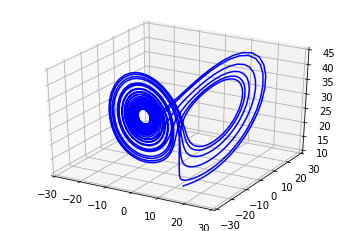

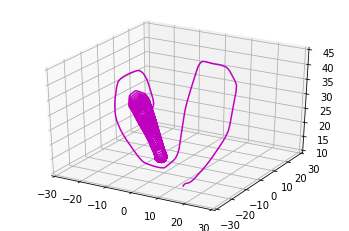

Iteration 1001 | Total Loss 73.862801
Iteration 1002 | Total Loss 83.501320
Iteration 1003 | Total Loss 62.092163
Iteration 1004 | Total Loss 82.921738
Iteration 1005 | Total Loss 61.918396


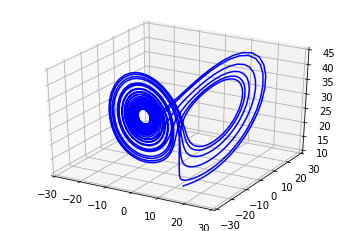

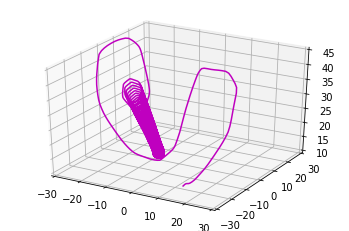

Iteration 1006 | Total Loss 84.457535
Iteration 1007 | Total Loss 63.167038
Iteration 1008 | Total Loss 91.795059
Iteration 1009 | Total Loss 68.646805
Iteration 1010 | Total Loss 104.910576


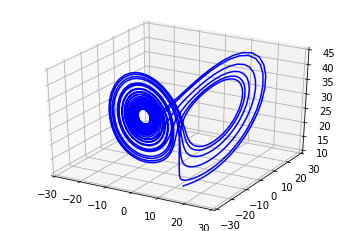

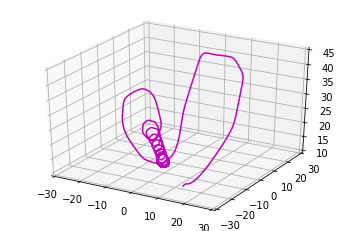

Iteration 1011 | Total Loss 250.341125
Iteration 1012 | Total Loss 83.463982
Iteration 1013 | Total Loss 1253.938477
Iteration 1014 | Total Loss 124.890961
Iteration 1015 | Total Loss 447.850159


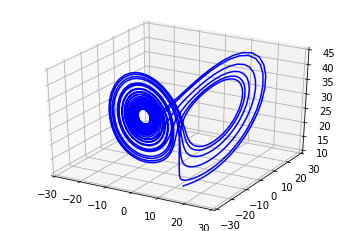

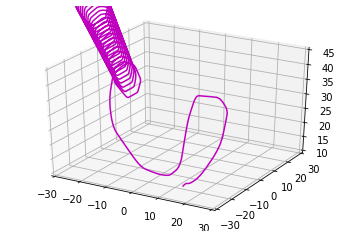

Iteration 1016 | Total Loss 259.169830
Iteration 1017 | Total Loss 329.319489
Iteration 1018 | Total Loss 84.928215
Iteration 1019 | Total Loss 117.789001
Iteration 1020 | Total Loss 64.159180


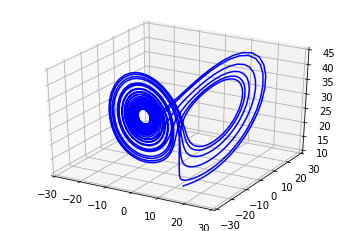

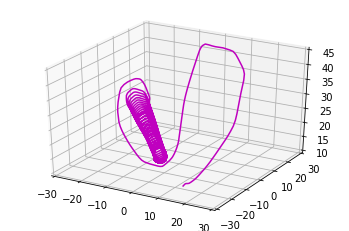

Iteration 1021 | Total Loss 63.357937
Iteration 1022 | Total Loss 110.565239
Iteration 1023 | Total Loss 218.289993
Iteration 1024 | Total Loss 88.650696
Iteration 1025 | Total Loss 152.393204


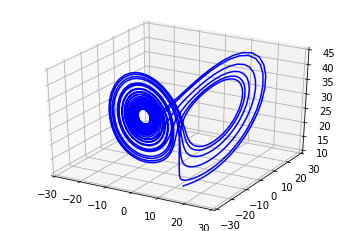

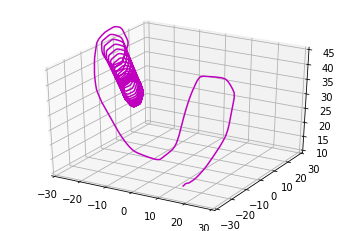

Iteration 1026 | Total Loss 78.023460
Iteration 1027 | Total Loss 107.091873
Iteration 1028 | Total Loss 65.721825
Iteration 1029 | Total Loss 127.361420
Iteration 1030 | Total Loss 63.576973


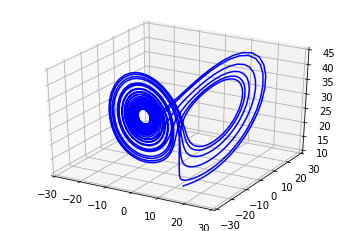

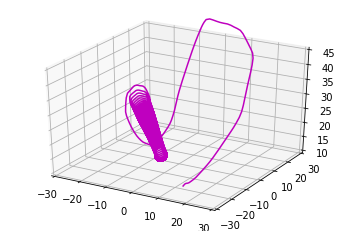

Iteration 1031 | Total Loss 119.089836
Iteration 1032 | Total Loss 58.400692
Iteration 1033 | Total Loss 226.525558
Iteration 1034 | Total Loss 76.046600
Iteration 1035 | Total Loss 456.402069


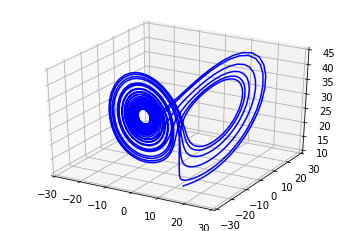

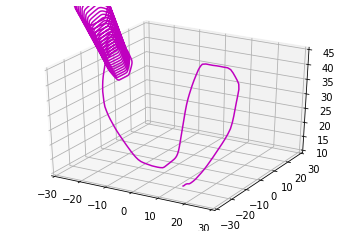

Iteration 1036 | Total Loss 95.104080
Iteration 1037 | Total Loss 142.448685
Iteration 1038 | Total Loss 88.894608
Iteration 1039 | Total Loss 121.799042
Iteration 1040 | Total Loss 75.339546


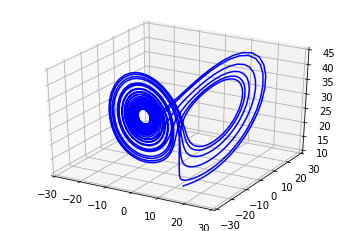

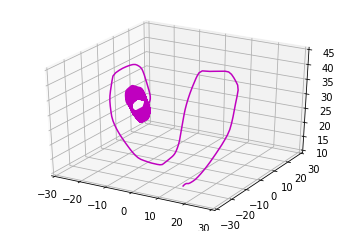

Iteration 1041 | Total Loss 149.905914
Iteration 1042 | Total Loss 54.164547
Iteration 1043 | Total Loss 85.882713
Iteration 1044 | Total Loss 59.816463
Iteration 1045 | Total Loss 133.963348


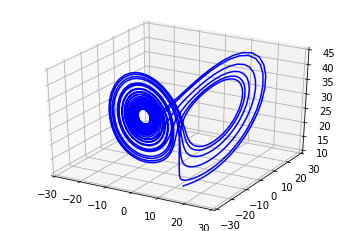

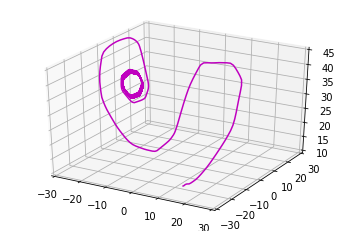

Iteration 1046 | Total Loss 65.138412
Iteration 1047 | Total Loss 276.431091
Iteration 1048 | Total Loss 80.922455
Iteration 1049 | Total Loss 508.314667
Iteration 1050 | Total Loss 107.394905


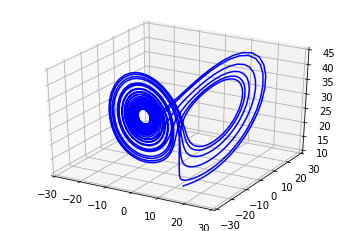

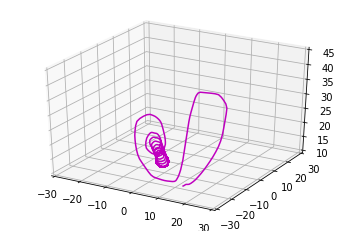

Iteration 1051 | Total Loss 1147.764771
Iteration 1052 | Total Loss 104.333405
Iteration 1053 | Total Loss 238.274673
Iteration 1054 | Total Loss 89.655571
Iteration 1055 | Total Loss 191.932190


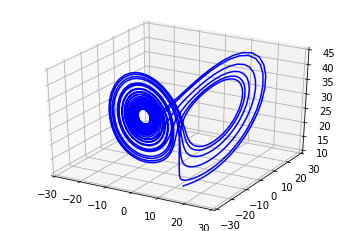

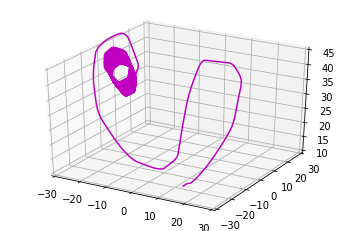

Iteration 1056 | Total Loss 75.158455
Iteration 1057 | Total Loss 176.622681
Iteration 1058 | Total Loss 62.394501
Iteration 1059 | Total Loss 78.211159
Iteration 1060 | Total Loss 89.123138


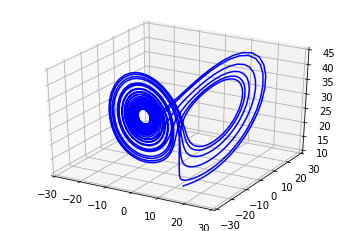

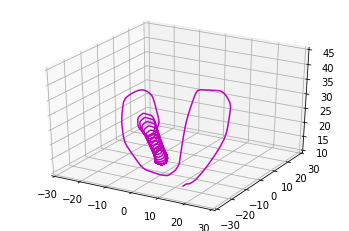

Iteration 1061 | Total Loss 81.207664
Iteration 1062 | Total Loss 88.340179
Iteration 1063 | Total Loss 161.418777
Iteration 1064 | Total Loss 87.970886
Iteration 1065 | Total Loss 172.030212


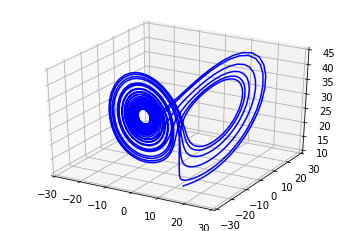

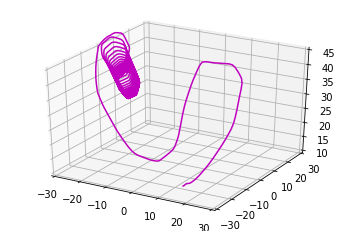

Iteration 1066 | Total Loss 80.799591
Iteration 1067 | Total Loss 228.902817
Iteration 1068 | Total Loss 69.239983
Iteration 1069 | Total Loss 78.943207
Iteration 1070 | Total Loss 79.464294


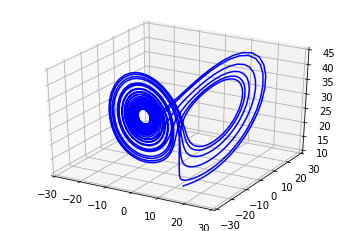

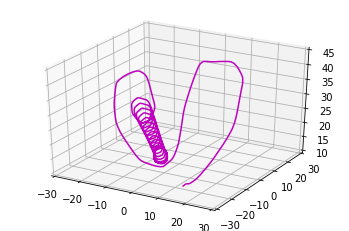

Iteration 1071 | Total Loss 72.954330
Iteration 1072 | Total Loss 70.698967
Iteration 1073 | Total Loss 68.235519
Iteration 1074 | Total Loss 83.282654
Iteration 1075 | Total Loss 70.560318


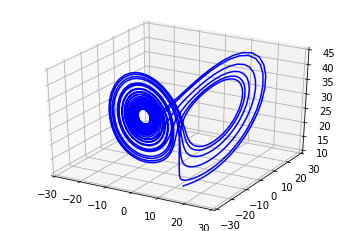

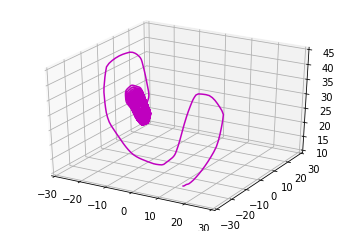

Iteration 1076 | Total Loss 102.962677
Iteration 1077 | Total Loss 116.042877
Iteration 1078 | Total Loss 102.163429
Iteration 1079 | Total Loss 150.321777
Iteration 1080 | Total Loss 95.178513


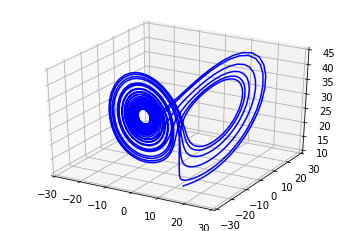

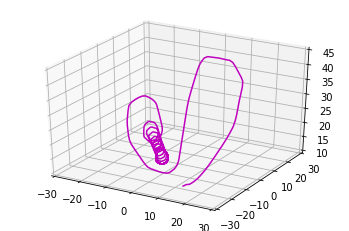

Iteration 1081 | Total Loss 203.221771
Iteration 1082 | Total Loss 83.190399
Iteration 1083 | Total Loss 348.303131
Iteration 1084 | Total Loss 68.537659
Iteration 1085 | Total Loss 118.800232


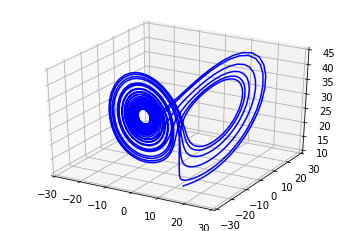

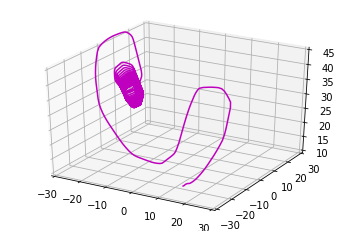

Iteration 1086 | Total Loss 79.268204
Iteration 1087 | Total Loss 90.699585
Iteration 1088 | Total Loss 187.605896
Iteration 1089 | Total Loss 101.577782
Iteration 1090 | Total Loss 98.020607


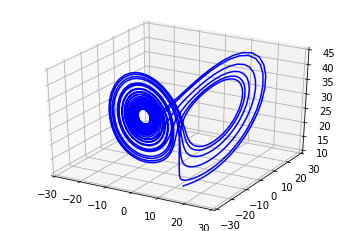

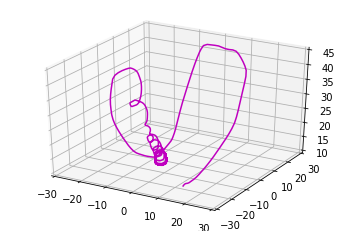

Iteration 1091 | Total Loss 135.699860
Iteration 1092 | Total Loss 83.298851
Iteration 1093 | Total Loss 63.825615
Iteration 1094 | Total Loss 90.525032
Iteration 1095 | Total Loss 55.840675


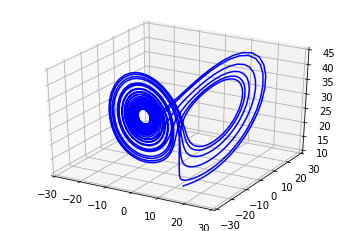

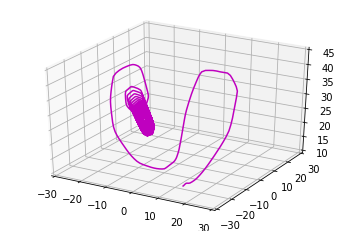

Iteration 1096 | Total Loss 75.452171
Iteration 1097 | Total Loss 164.548584
Iteration 1098 | Total Loss 66.632019
Iteration 1099 | Total Loss 163.064743
Iteration 1100 | Total Loss 64.571991


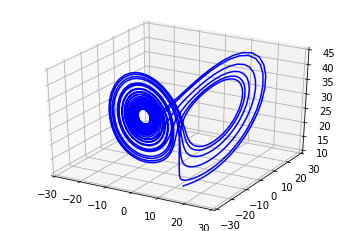

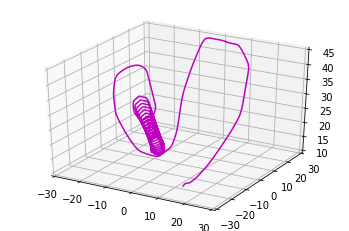

Iteration 1101 | Total Loss 164.832565
Iteration 1102 | Total Loss 74.502640
Iteration 1103 | Total Loss 59.686073
Iteration 1104 | Total Loss 75.932877
Iteration 1105 | Total Loss 232.516098


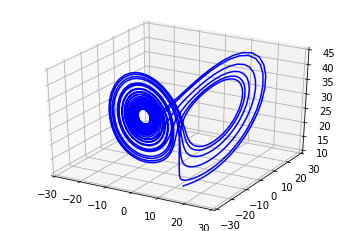

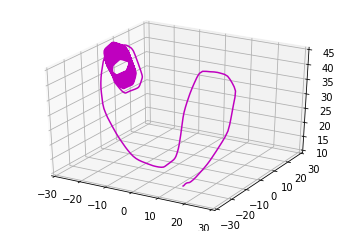

Iteration 1106 | Total Loss 59.404152
Iteration 1107 | Total Loss 124.702873
Iteration 1108 | Total Loss 67.939011
Iteration 1109 | Total Loss 172.306107
Iteration 1110 | Total Loss 77.359161


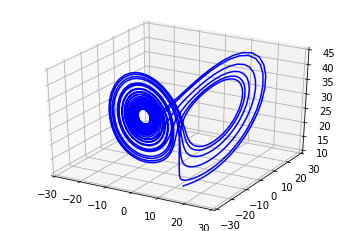

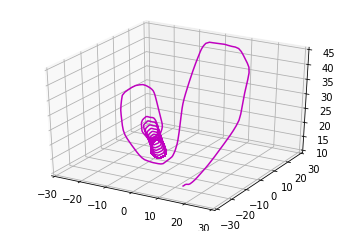

Iteration 1111 | Total Loss 146.457733
Iteration 1112 | Total Loss 69.241005
Iteration 1113 | Total Loss 135.812424
Iteration 1114 | Total Loss 66.580299
Iteration 1115 | Total Loss 93.871361


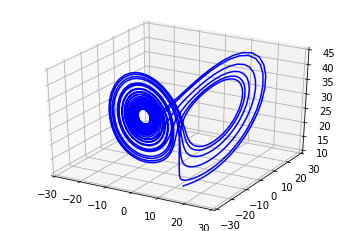

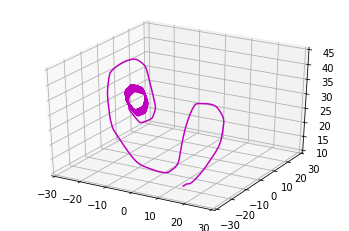

Iteration 1116 | Total Loss 54.364811
Iteration 1117 | Total Loss 103.509384
Iteration 1118 | Total Loss 67.915260
Iteration 1119 | Total Loss 96.696404
Iteration 1120 | Total Loss 60.681759


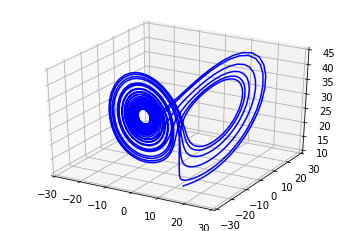

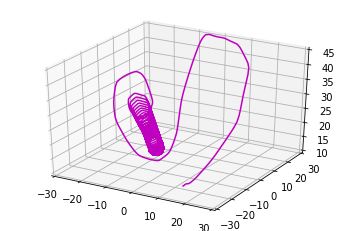

Iteration 1121 | Total Loss 149.478409
Iteration 1122 | Total Loss 61.803032
Iteration 1123 | Total Loss 179.642731
Iteration 1124 | Total Loss 68.870049
Iteration 1125 | Total Loss 274.468140


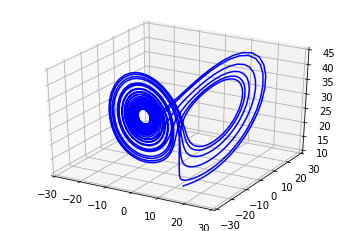

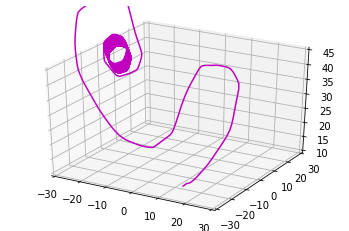

Iteration 1126 | Total Loss 80.939262
Iteration 1127 | Total Loss 558.472900
Iteration 1128 | Total Loss 62.857212
Iteration 1129 | Total Loss 210.145981
Iteration 1130 | Total Loss 73.986740


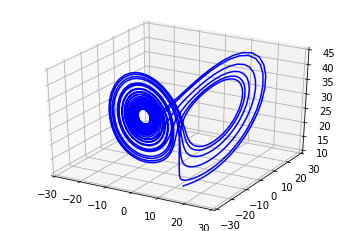

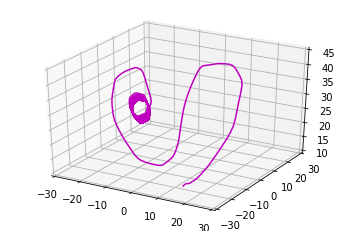

Iteration 1131 | Total Loss 168.791107
Iteration 1132 | Total Loss 75.301308
Iteration 1133 | Total Loss 118.306145
Iteration 1134 | Total Loss 57.853405
Iteration 1135 | Total Loss 118.254654


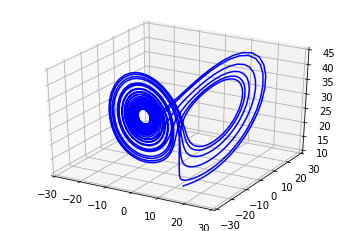

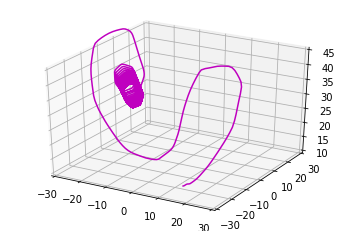

Iteration 1136 | Total Loss 59.255913
Iteration 1137 | Total Loss 171.380020
Iteration 1138 | Total Loss 74.408836
Iteration 1139 | Total Loss 319.119263
Iteration 1140 | Total Loss 79.850304


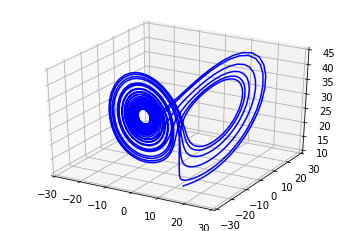

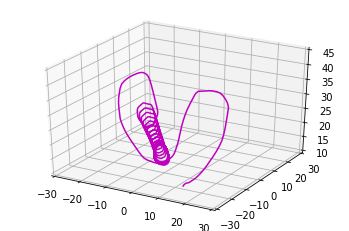

Iteration 1141 | Total Loss 153.824539
Iteration 1142 | Total Loss 83.813622
Iteration 1143 | Total Loss 827.446350
Iteration 1144 | Total Loss 188.561493
Iteration 1145 | Total Loss 573.650391


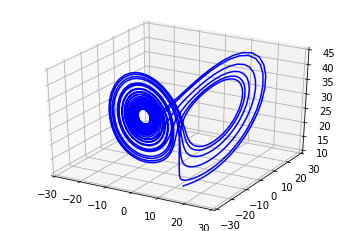

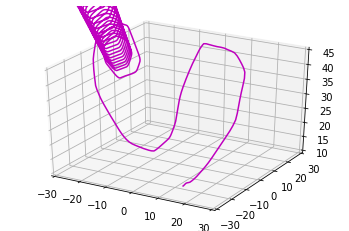

Iteration 1146 | Total Loss 89.094345
Iteration 1147 | Total Loss 126.391731
Iteration 1148 | Total Loss 177.390686
Iteration 1149 | Total Loss 144.959854
Iteration 1150 | Total Loss 82.423866


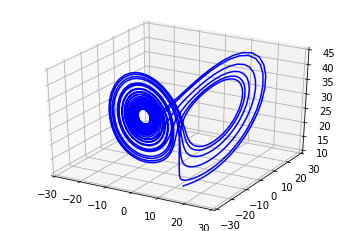

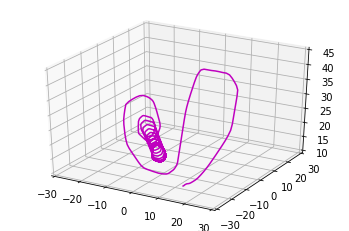

Iteration 1151 | Total Loss 303.839111
Iteration 1152 | Total Loss 76.257561
Iteration 1153 | Total Loss 188.540588
Iteration 1154 | Total Loss 74.078835
Iteration 1155 | Total Loss 151.773651


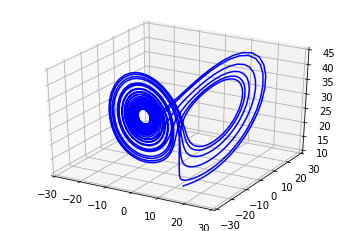

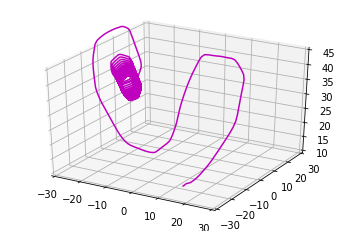

Iteration 1156 | Total Loss 70.603073
Iteration 1157 | Total Loss 139.882233
Iteration 1158 | Total Loss 62.292568
Iteration 1159 | Total Loss 153.837204
Iteration 1160 | Total Loss 74.891319


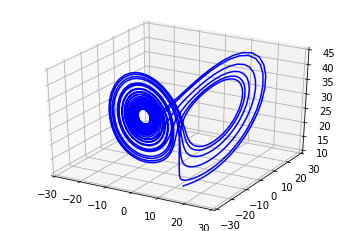

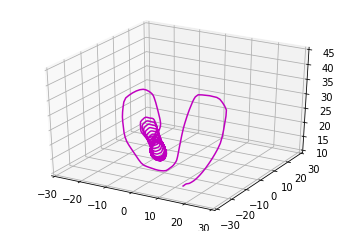

Iteration 1161 | Total Loss 185.476837
Iteration 1162 | Total Loss 87.431595
Iteration 1163 | Total Loss 195.807526
Iteration 1164 | Total Loss 74.945999
Iteration 1165 | Total Loss 219.566025


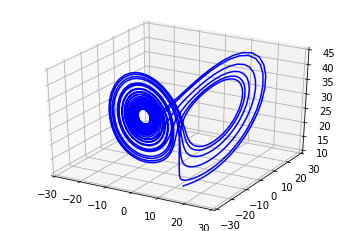

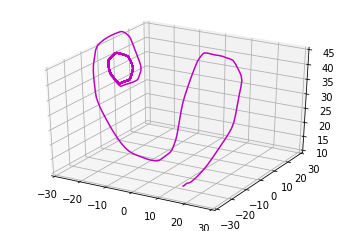

Iteration 1166 | Total Loss 68.507523
Iteration 1167 | Total Loss 120.761497
Iteration 1168 | Total Loss 59.592766
Iteration 1169 | Total Loss 132.084000
Iteration 1170 | Total Loss 66.723305


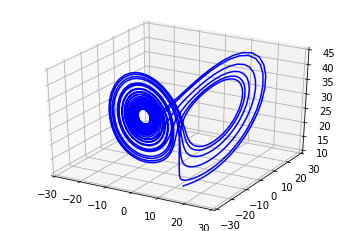

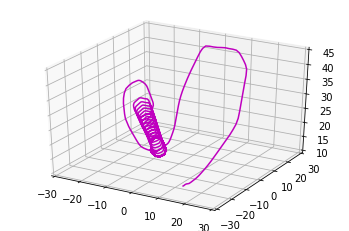

Iteration 1171 | Total Loss 176.351868
Iteration 1172 | Total Loss 60.817802
Iteration 1173 | Total Loss 96.290970
Iteration 1174 | Total Loss 64.376335
Iteration 1175 | Total Loss 160.014069


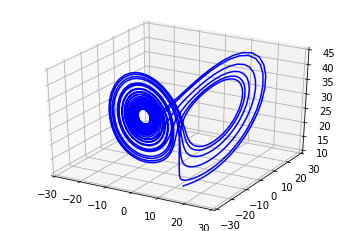

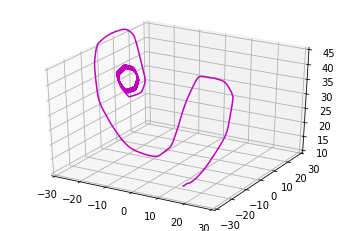

Iteration 1176 | Total Loss 87.272789
Iteration 1177 | Total Loss 57.668877
Iteration 1178 | Total Loss 80.705101
Iteration 1179 | Total Loss 62.363098
Iteration 1180 | Total Loss 72.677574


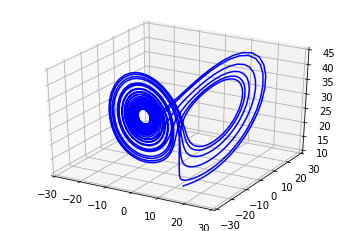

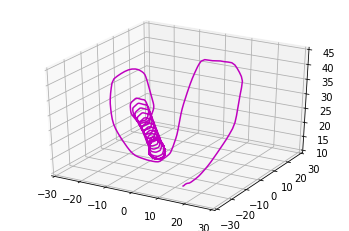

Iteration 1181 | Total Loss 63.926926
Iteration 1182 | Total Loss 76.287842
Iteration 1183 | Total Loss 72.803474
Iteration 1184 | Total Loss 76.733505
Iteration 1185 | Total Loss 137.890945


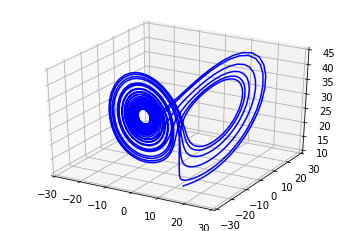

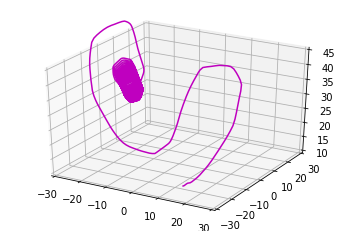

Iteration 1186 | Total Loss 85.014496
Iteration 1187 | Total Loss 894.608093
Iteration 1188 | Total Loss 78.149307
Iteration 1189 | Total Loss 129.516632
Iteration 1190 | Total Loss 68.767883


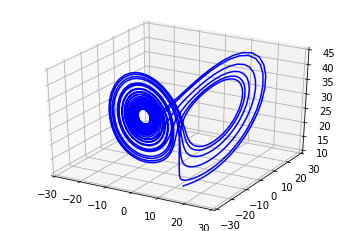

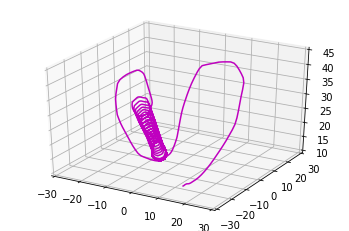

Iteration 1191 | Total Loss 159.369003
Iteration 1192 | Total Loss 79.337486
Iteration 1193 | Total Loss 167.353439
Iteration 1194 | Total Loss 72.918686
Iteration 1195 | Total Loss 67.332176


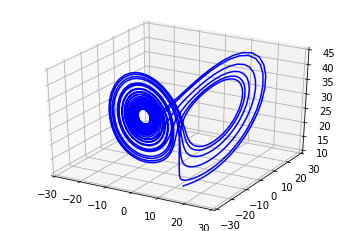

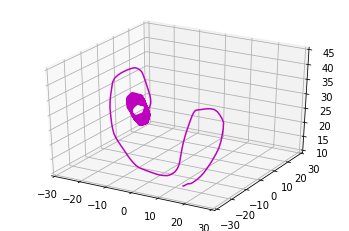

Iteration 1196 | Total Loss 75.627975
Iteration 1197 | Total Loss 63.710144
Iteration 1198 | Total Loss 83.655525
Iteration 1199 | Total Loss 79.531944
Iteration 1200 | Total Loss 89.069908


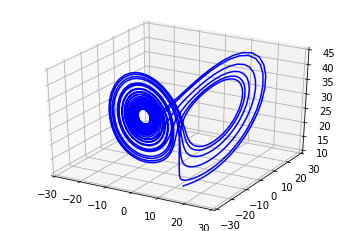

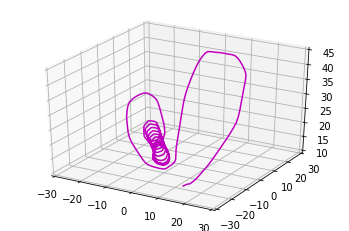

Iteration 1201 | Total Loss 116.968430
Iteration 1202 | Total Loss 79.627403
Iteration 1203 | Total Loss 56.990349
Iteration 1204 | Total Loss 82.996330
Iteration 1205 | Total Loss 64.948128


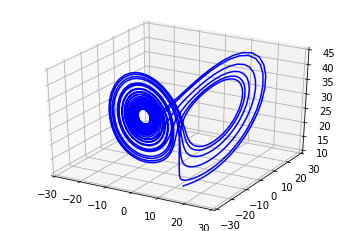

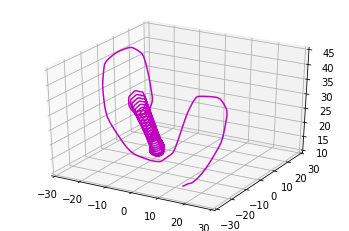

Iteration 1206 | Total Loss 90.723846
Iteration 1207 | Total Loss 129.236359
Iteration 1208 | Total Loss 199.804932
Iteration 1209 | Total Loss 78.612312
Iteration 1210 | Total Loss 219.328018


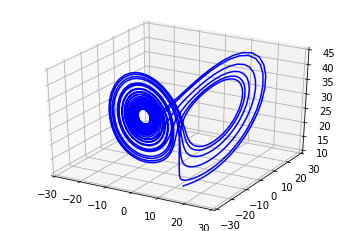

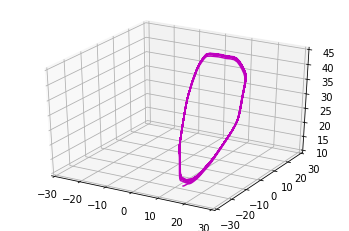

Iteration 1211 | Total Loss 103.576126
Iteration 1212 | Total Loss 204.370270
Iteration 1213 | Total Loss 59.954853
Iteration 1214 | Total Loss 74.691360
Iteration 1215 | Total Loss 55.807472


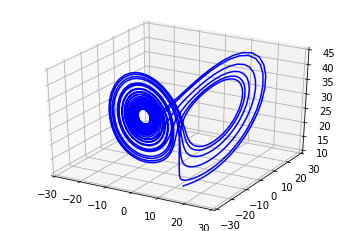

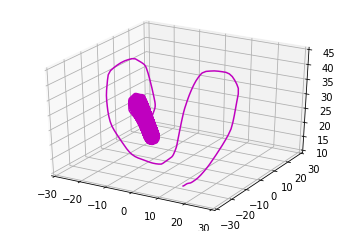

Iteration 1216 | Total Loss 73.376289
Iteration 1217 | Total Loss 67.176872
Iteration 1218 | Total Loss 81.766434
Iteration 1219 | Total Loss 85.398415
Iteration 1220 | Total Loss 83.824326


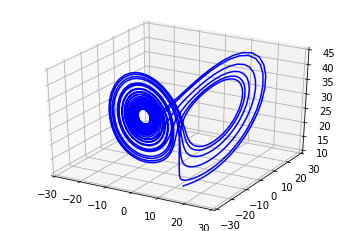

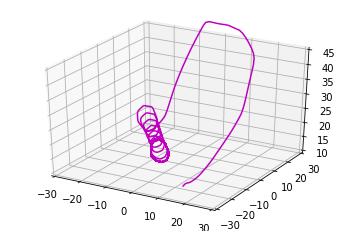

Iteration 1221 | Total Loss 83.294624
Iteration 1222 | Total Loss 88.530251
Iteration 1223 | Total Loss 94.982559
Iteration 1224 | Total Loss 67.739975
Iteration 1225 | Total Loss 60.079365


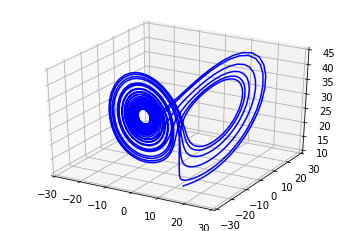

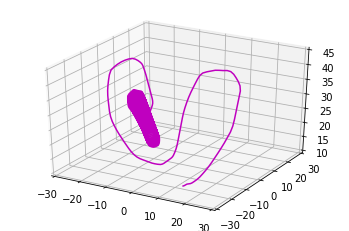

Iteration 1226 | Total Loss 65.435562
Iteration 1227 | Total Loss 57.769279
Iteration 1228 | Total Loss 75.335732
Iteration 1229 | Total Loss 61.444191
Iteration 1230 | Total Loss 78.257896


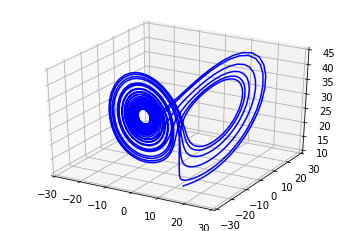

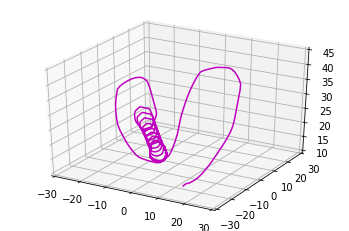

Iteration 1231 | Total Loss 171.900620
Iteration 1232 | Total Loss 88.659447
Iteration 1233 | Total Loss 4148.309570
Iteration 1234 | Total Loss 79.479904
Iteration 1235 | Total Loss 154.068192


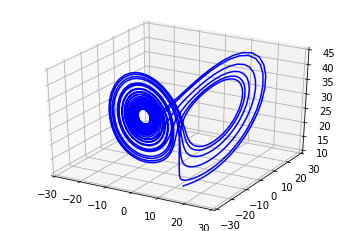

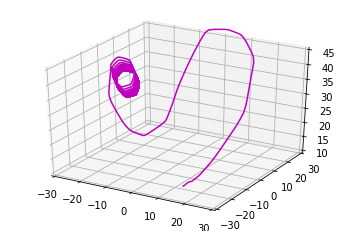

Iteration 1236 | Total Loss 83.734596
Iteration 1237 | Total Loss 154.027756
Iteration 1238 | Total Loss 75.017815
Iteration 1239 | Total Loss 114.069397
Iteration 1240 | Total Loss 78.627647


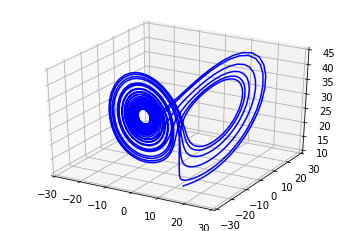

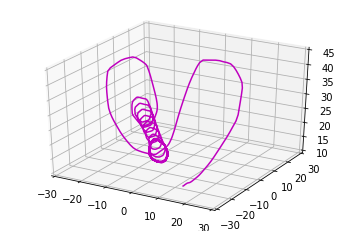

Iteration 1241 | Total Loss 134.196304
Iteration 1242 | Total Loss 67.874924
Iteration 1243 | Total Loss 125.303909
Iteration 1244 | Total Loss 72.085884
Iteration 1245 | Total Loss 60.375725


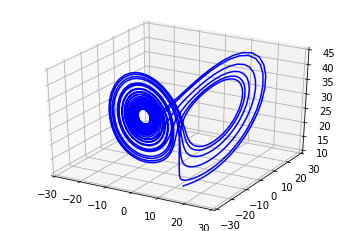

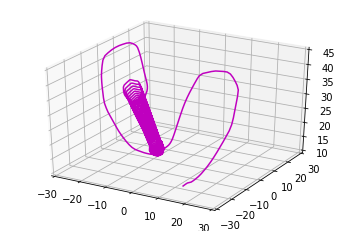

Iteration 1246 | Total Loss 65.347214
Iteration 1247 | Total Loss 60.118244
Iteration 1248 | Total Loss 72.180878
Iteration 1249 | Total Loss 60.457859
Iteration 1250 | Total Loss 79.145683


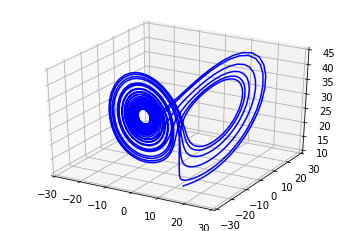

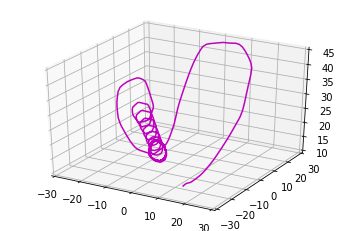

Iteration 1251 | Total Loss 99.265282
Iteration 1252 | Total Loss 66.726707
Iteration 1253 | Total Loss 97.380142
Iteration 1254 | Total Loss 77.607269
Iteration 1255 | Total Loss 150.809174


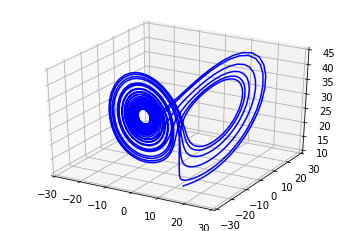

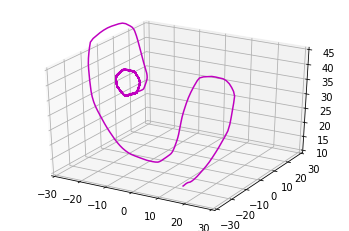

Iteration 1256 | Total Loss 89.313293
Iteration 1257 | Total Loss 416.966248
Iteration 1258 | Total Loss 66.398300
Iteration 1259 | Total Loss 150.037567
Iteration 1260 | Total Loss 78.547165


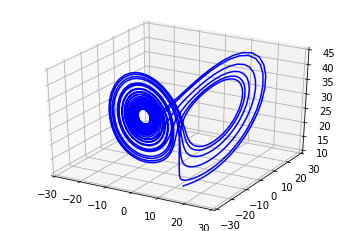

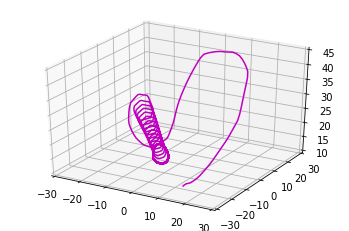

Iteration 1261 | Total Loss 135.899338
Iteration 1262 | Total Loss 66.303688
Iteration 1263 | Total Loss 72.532600
Iteration 1264 | Total Loss 71.062408
Iteration 1265 | Total Loss 67.290329


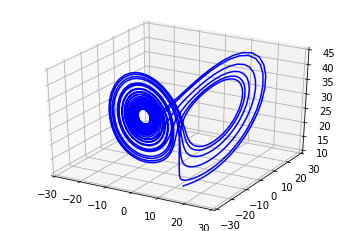

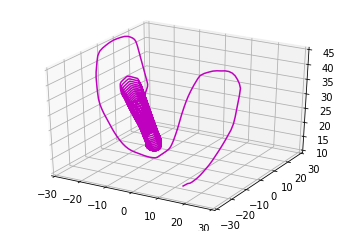

Iteration 1266 | Total Loss 74.928658
Iteration 1267 | Total Loss 94.057632
Iteration 1268 | Total Loss 75.935425
Iteration 1269 | Total Loss 159.141266
Iteration 1270 | Total Loss 88.452675


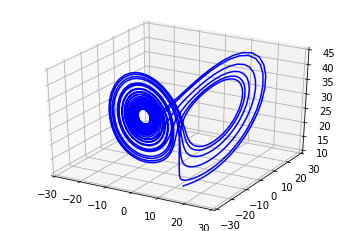

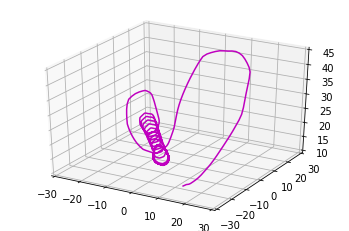

Iteration 1271 | Total Loss 901.769165
Iteration 1272 | Total Loss 110.823593
Iteration 1273 | Total Loss 144.359863
Iteration 1274 | Total Loss 76.969978
Iteration 1275 | Total Loss 169.814392


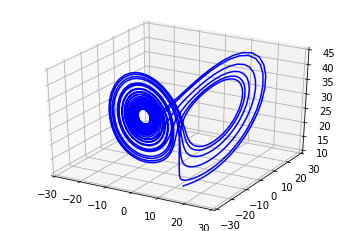

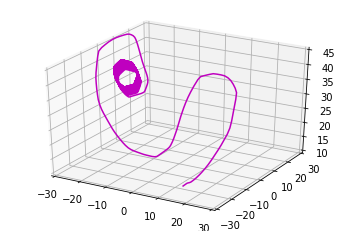

Iteration 1276 | Total Loss 74.397682
Iteration 1277 | Total Loss 113.485336
Iteration 1278 | Total Loss 77.156693
Iteration 1279 | Total Loss 169.866226
Iteration 1280 | Total Loss 298.585693


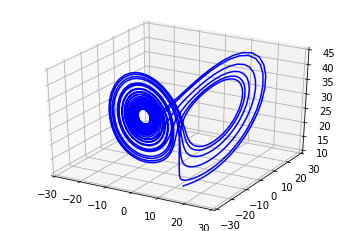

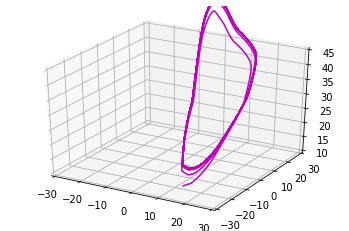

Iteration 1281 | Total Loss 143.433395
Iteration 1282 | Total Loss 182.627182
Iteration 1283 | Total Loss 159.275131
Iteration 1284 | Total Loss 193.375305
Iteration 1285 | Total Loss 75.206596


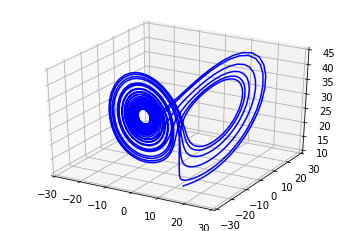

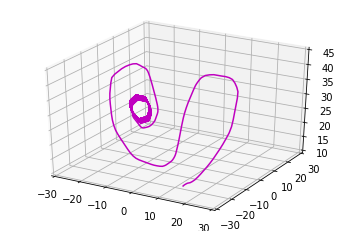

Iteration 1286 | Total Loss 59.608665
Iteration 1287 | Total Loss 72.607529
Iteration 1288 | Total Loss 59.711212
Iteration 1289 | Total Loss 97.361794
Iteration 1290 | Total Loss 66.659744


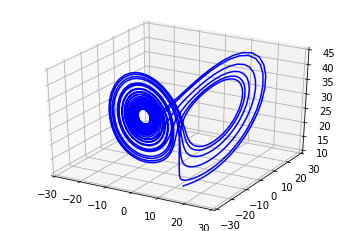

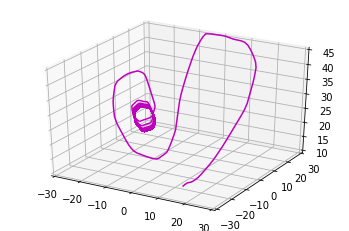

Iteration 1291 | Total Loss 208.470627
Iteration 1292 | Total Loss 214.815521
Iteration 1293 | Total Loss 218.385056
Iteration 1294 | Total Loss 118.098206
Iteration 1295 | Total Loss 14013.057617


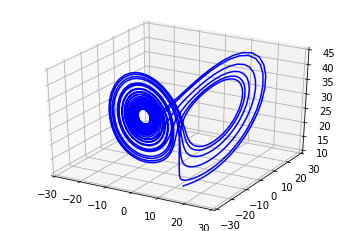

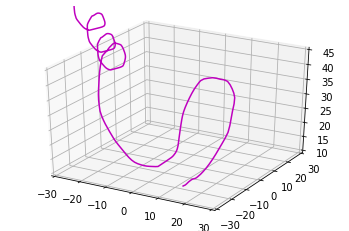

Iteration 1296 | Total Loss 83.272102
Iteration 1297 | Total Loss 104.764008
Iteration 1298 | Total Loss 68.216736
Iteration 1299 | Total Loss 119.359833
Iteration 1300 | Total Loss 64.767670


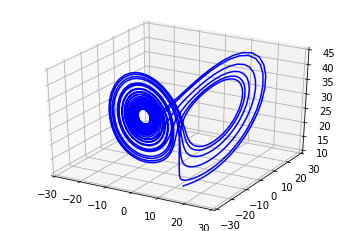

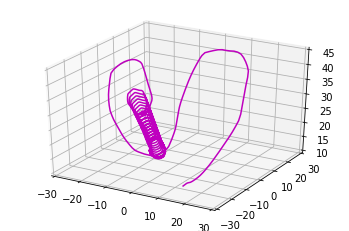

Iteration 1301 | Total Loss 72.526871
Iteration 1302 | Total Loss 60.499504
Iteration 1303 | Total Loss 83.535492
Iteration 1304 | Total Loss 60.568726
Iteration 1305 | Total Loss 70.932869


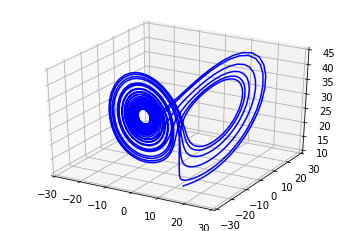

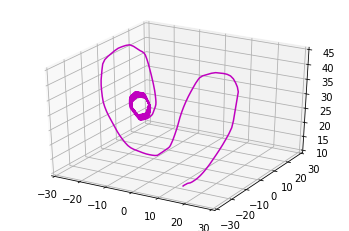

Iteration 1306 | Total Loss 64.338013
Iteration 1307 | Total Loss 98.859940
Iteration 1308 | Total Loss 61.483952
Iteration 1309 | Total Loss 141.102478
Iteration 1310 | Total Loss 81.578362


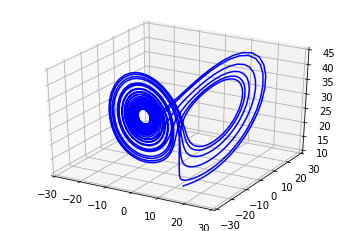

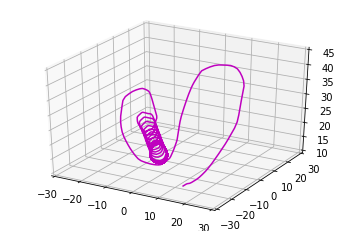

Iteration 1311 | Total Loss 185.500519
Iteration 1312 | Total Loss 64.189194
Iteration 1313 | Total Loss 112.489029
Iteration 1314 | Total Loss 72.668503
Iteration 1315 | Total Loss 93.854393


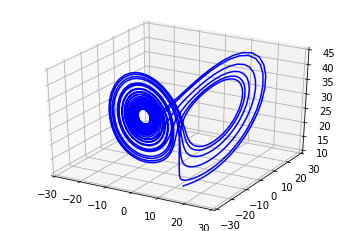

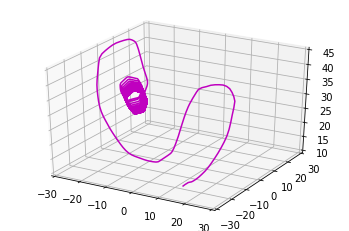

Iteration 1316 | Total Loss 65.787903
Iteration 1317 | Total Loss 103.979324
Iteration 1318 | Total Loss 71.785522
Iteration 1319 | Total Loss 225.258209
Iteration 1320 | Total Loss 78.654099


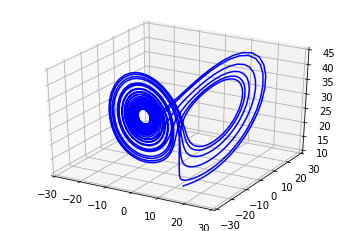

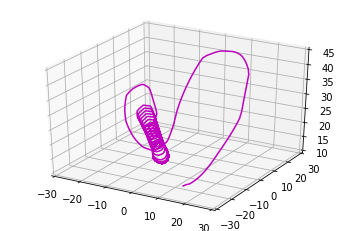

Iteration 1321 | Total Loss 143.189285
Iteration 1322 | Total Loss 62.333298
Iteration 1323 | Total Loss 98.086517
Iteration 1324 | Total Loss 75.857346
Iteration 1325 | Total Loss 168.423035


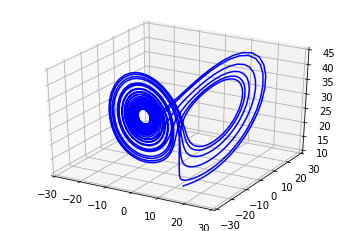

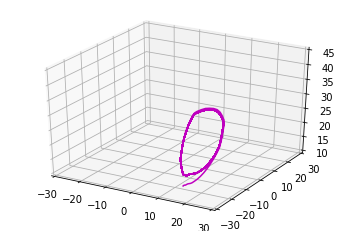

Iteration 1326 | Total Loss 193.667236
Iteration 1327 | Total Loss 118.214417
Iteration 1328 | Total Loss 179.450806
Iteration 1329 | Total Loss 118.371773
Iteration 1330 | Total Loss 203.713623


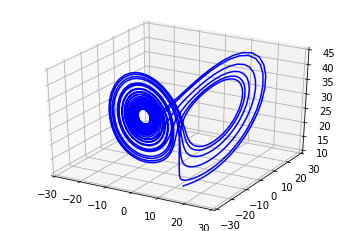

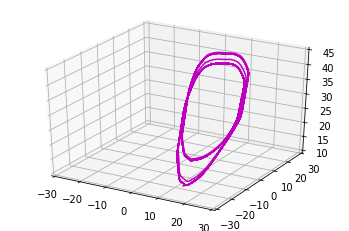

Iteration 1331 | Total Loss 3051.188232
Iteration 1332 | Total Loss 74.524307
Iteration 1333 | Total Loss 483.818176
Iteration 1334 | Total Loss 94.761177
Iteration 1335 | Total Loss 99.761185


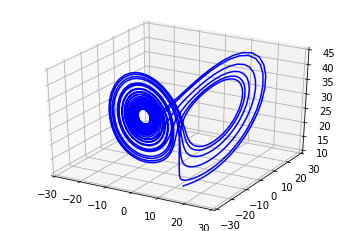

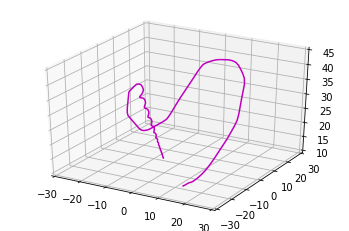

Iteration 1336 | Total Loss 155.159653
Iteration 1337 | Total Loss 63.426811
Iteration 1338 | Total Loss 95.301903
Iteration 1339 | Total Loss 5956.542480
Iteration 1340 | Total Loss 140.179459


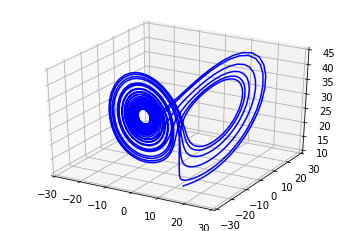

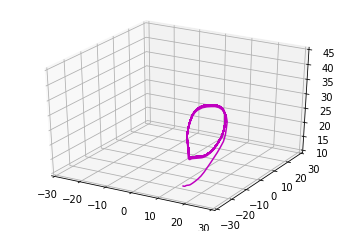

Iteration 1341 | Total Loss 322.323486
Iteration 1342 | Total Loss 209.379349
Iteration 1343 | Total Loss 131.743912
Iteration 1344 | Total Loss 172.951111
Iteration 1345 | Total Loss 171.614731


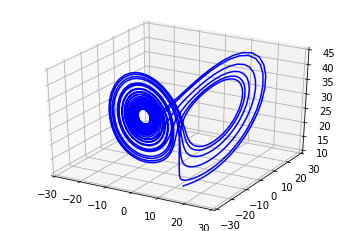

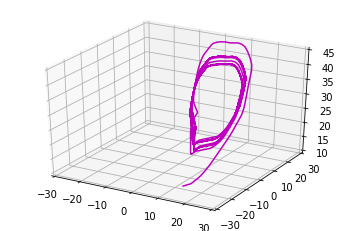

Iteration 1346 | Total Loss 152.258926
Iteration 1347 | Total Loss 124.993347
Iteration 1348 | Total Loss 159.446014
Iteration 1349 | Total Loss 136.828735
Iteration 1350 | Total Loss 147.262650


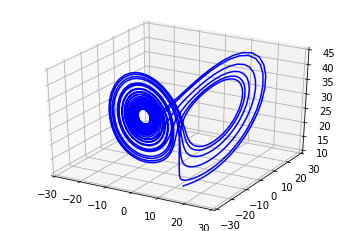

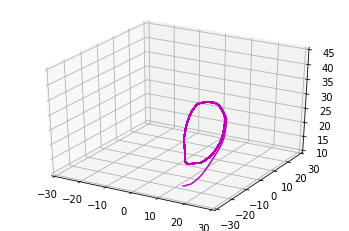

Iteration 1351 | Total Loss 131.518295
Iteration 1352 | Total Loss 151.105286
Iteration 1353 | Total Loss 99.645081
Iteration 1354 | Total Loss 62.704834
Iteration 1355 | Total Loss 102.473289


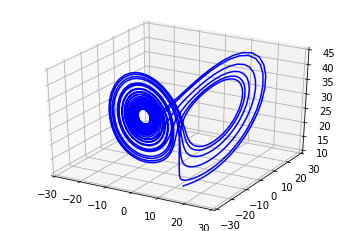

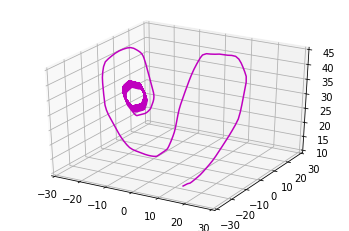

Iteration 1356 | Total Loss 62.107277
Iteration 1357 | Total Loss 124.715500
Iteration 1358 | Total Loss 67.146248
Iteration 1359 | Total Loss 131.615631
Iteration 1360 | Total Loss 98.147125


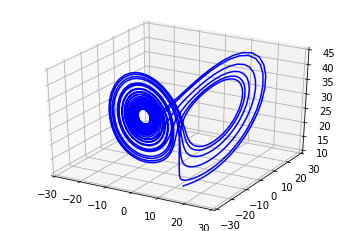

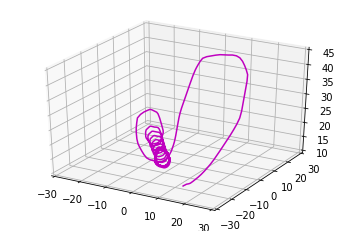

Iteration 1361 | Total Loss 14523.088867
Iteration 1362 | Total Loss 69.860680
Iteration 1363 | Total Loss 178.975479
Iteration 1364 | Total Loss 422.439911
Iteration 1365 | Total Loss 845.973083


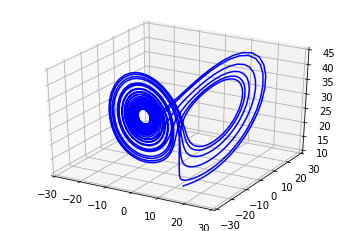

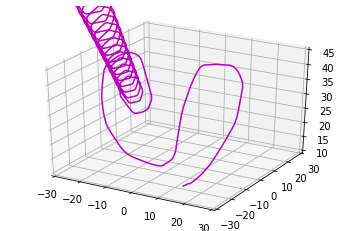

Iteration 1366 | Total Loss 156.399048
Iteration 1367 | Total Loss 855.816589
Iteration 1368 | Total Loss 118.459854
Iteration 1369 | Total Loss 721.733337
Iteration 1370 | Total Loss 78.025696


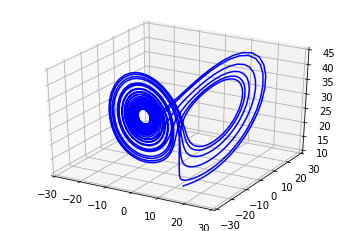

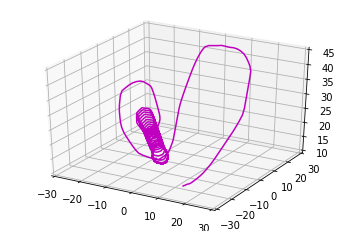

Iteration 1371 | Total Loss 615.784851
Iteration 1372 | Total Loss 88.875389
Iteration 1373 | Total Loss 1571.534302
Iteration 1374 | Total Loss 994.578247
Iteration 1375 | Total Loss 204.338440


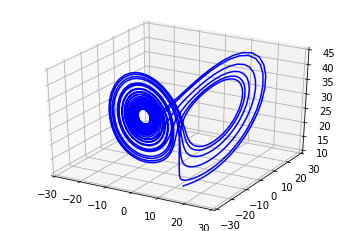

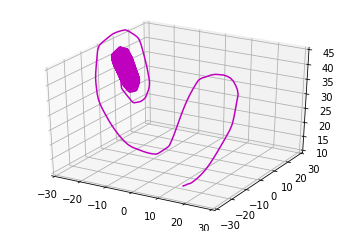

Iteration 1376 | Total Loss 74.630409
Iteration 1377 | Total Loss 57.187244
Iteration 1378 | Total Loss 84.946747
Iteration 1379 | Total Loss 77.522018
Iteration 1380 | Total Loss 169.220337


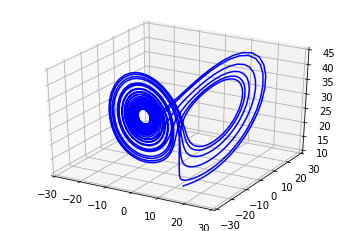

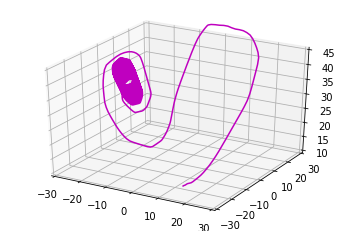

Iteration 1381 | Total Loss 177.477371
Iteration 1382 | Total Loss 202.940338
Iteration 1383 | Total Loss 56.539032
Iteration 1384 | Total Loss 60.039146
Iteration 1385 | Total Loss 54.668743


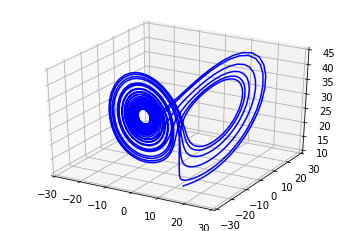

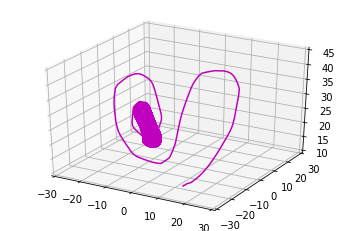

Iteration 1386 | Total Loss 56.517532
Iteration 1387 | Total Loss 55.291660
Iteration 1388 | Total Loss 124.053062
Iteration 1389 | Total Loss 62.759121
Iteration 1390 | Total Loss 239.328995


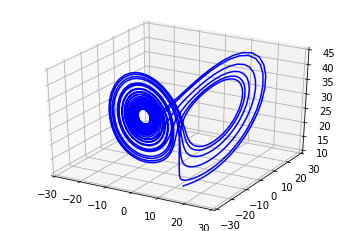

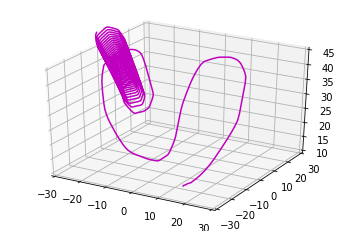

Iteration 1391 | Total Loss 77.458176


KeyboardInterrupt: 

In [22]:
if __name__ == '__main__':
    
    #ii = 0
    X = torch.linspace(-45,45,45)
    
    func = ODEFunc()
    optimizer = optim.RMSprop(func.parameters())          #this is an optimizer designed to update parameters
    end = time.time()                                     #usually people use SGD but this is a mini-batch approach
                                                          #http://www.cs.toronto.edu/~tijmen/csc321/slides/lecture_slides_lec6.pdf
    #RunningAvgMeter Objects
    time_meter = RunningAverageMeter(0.97)
    loss_meter = RunningAverageMeter(0.97)
    
    #TRAINING
    for itr in range(1, niters+1):
        #initial conditions; requires 2D tensor
        true_y0 = torch.tensor([[1.0,1.0,1.0]])
        
        with torch.no_grad(): #no_grad disables gradient finding when true_y is defined
            #print(torch.mm(true_y0**3,true_A))
            true_y = odeint(Lambda(),true_y0, t, method='adams') 
            #true_y is the solved ODE defined in Lambda
            #odeint only takes a function from nn.Module >> implications? see solver comparision Jupyter
            #it uses Lambda to provide the function to go solve the IVP given true_y0 with the ODE solver on t
            #trueSl = getSlopesTorch(X.numpy(),Lambda())
        
        optimizer.zero_grad() #set gradients to zero/ not computed
        
        batch_y0, batch_t, batch_y = get_batch()
        #feeds odeint the ODEBlock, a set of y values based on random t values and the first ten values of t
        pred_y = odeint(func, batch_y0, batch_t)
        #deviates from usual Loss of mean squared difference but sum in both cases is positive
        #print(pred_y.detach(),batch_y)
        #---------------------------------------
        #predSl = getSlopesTorch(X.numpy(),func)
        
        loss = torch.mean(torch.abs(pred_y-batch_y)**2) #ask Ivan about predY-bY, also this returns a number
        #--------------------------------------------------
        #loss = torch.mean(torch.abs(predSl-trueSl)**2)
        
        loss.backward() #backpropogation
        optimizer.step() #gradient descent and update parameters
        #Update time and loss meters
        time_meter.update(time.time()-end) #takes in time difference to establish velocity see RMS method details
        loss_meter.update(loss.item()) #the loss itself is a delta / change
        
        with torch.no_grad():
            pred_y = odeint(func, true_y0, t)
            loss = torch.mean(torch.abs(pred_y-true_y)**2)
            #-------------------------------------------------
            #predSl = getSlopesTorch(X.numpy(),func)
            
            #loss = torch.mean(torch.abs(predSl-trueSl)**2)
            print('Iteration {:04d} | Total Loss {:.6f}'.format(itr, loss.item()))
        
            if itr % test_freq == 0:
                visualize(true_y,pred_y)
                
        #torch.save(func.state_dict(), C:\Users\delis\Desktop\DEPython\modelP)
                
        end = time.time()